# NBA 22-23 Analytics and Visualizations Pipeline

## Necessary Imports

In [1]:
import time
import re
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:.5g}'.format)
from PIL import Image
import requests
import numpy as np
import requests
import matplotlib.pyplot as plt
from matplotlib.offsetbox import  OffsetImage
import seaborn as sns
import urllib.request
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from bs4 import BeautifulSoup
import urllib
from sklearn.linear_model import LinearRegression
from IPython.core.display import HTML

HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

class color:
    PURPLE = '\033[95m'
    CYAN = '\033[96m'
    DARKCYAN = '\033[36m'
    BLUE = '\033[94m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    RED = '\033[91m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'
    END = '\033[0m'

In [3]:
team_names =     ['Utah Jazz', 'Sacramento Kings', 'Washington Wizards',
                  'Boston Celtics', 'Milwaukee Bucks', 'Oklahoma City Thunder',
                  'Chicago Bulls', 'Phoenix Suns', 'Philadelphia 76ers',
                  'New Orleans Pelicans', 'Charlotte Hornets', 'Los Angeles Lakers',
                  'Indiana Pacers', 'Toronto Raptors', 'Cleveland Cavaliers',
                  'Denver Nuggets', 'Minnesota Timberwolves', 'Brooklyn Nets',
                  'San Antonio Spurs', 'Dallas Mavericks', 'Houston Rockets',
                  'Detroit Pistons', 'Portland Trail Blazers', 'Atlanta Hawks',
                  'Golden State Warriors', 'Miami Heat', 'Los Angeles Clippers',
                  'New York Knicks', 'Memphis Grizzlies', 'Orlando Magic', 'League Average']

team_abbrs =     ['UTA', 'SAC', 'WAS', 'BOS', 'MIL', 'OKC', 'CHI', 'PHX', 'PHI',
                  'NOP', 'CHA', 'LAL', 'IND', 'TOR', 'CLE', 'DEN', 'MIN', 'BKN',
                  'SAS', 'DAL', 'HOU', 'DET', 'POR', 'ATL', 'GSW', 'MIA', 'LAC',
                  'NYK', 'MEM', 'ORL', 'NBA']

team_name_abbr_dict = {}
team_abbr_name_dict = {}
team_id_dict={}

for i in range(len(team_names)):
    team_name_abbr_dict[team_names[i]]=team_abbrs[i]

for i in range(len(team_abbrs)):
    team_abbr_name_dict[team_abbrs[i]]=team_names[i]

## Webscrape and Prepare Box Score DataFrame

In [4]:
url = 'https://stats.nba.com/stats/leaguegamelog'
headers= {'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/96.0.4664.110 Safari/537.36',
          'Referer': 'https://www.nba.com/'}
payload = {
    'Counter': '1000',
    'DateFrom': '',
    'DateTo': '',
    'Direction': 'DESC',
    'LeagueID': '00',
    'PlayerOrTeam': 'T',
    'Season': '2022-23',
    'SeasonType': 'Regular Season',
    'Sorter': 'DATE'}

jsonData = requests.get(url, headers=headers, params=payload).json()


rows = jsonData['resultSets'][0]['rowSet']
columns = jsonData['resultSets'][0]['headers']

df = pd.DataFrame(rows, columns=columns)
df.drop(['VIDEO_AVAILABLE'], axis=1, inplace=True)


df['FG2M'] = df.FGM - df.FG3M
df['FG2A'] = df.FGA - df.FG3A

df['FG2_PTS'] = df.FG2M * 2
df['FG3_PTS'] = df.FG3M * 3

df['FRAC_ATT_2PT'] = df.FG2A / df.FGA
df['FRAC_ATT_3PT'] = df.FG3A / df.FGA

df['FRAC_MK_2PT'] = df.FG2M / df.FGM
df['FRAC_MK_3PT'] = df.FG3M / df.FGM

df['FRAC_PTS_2PT'] = df.FG2_PTS / df.PTS
df['FRAC_PTS_3PT'] = df.FG3_PTS / df.PTS
df['FRAC_PTS_FT'] = df.FTM / df.PTS 

df['OPP_TEAM_ABBR'] = df['MATCHUP'].str.strip().str[-3:]
df['OPP_PTS'] = df['PTS'] - df['PLUS_MINUS']

df['MONTH'] = pd.DatetimeIndex(df['GAME_DATE']).month
df['YEAR'] = pd.DatetimeIndex(df['GAME_DATE']).year

def home_or_away(string):
    if string[4]=='@': return 'AWAY'
    elif string[4]=='v': return 'HOME'
df['HOME_AWAY'] = df['MATCHUP'].map(home_or_away)

conferences = {'GSW':'WEST', 'POR':'WEST', 'SAC':'WEST', 'UTA':'WEST', 'MIA':'EAST', 'DEN':'WEST', 'MIN':'WEST',
               'PHI':'EAST', 'NOP':'EAST', 'ORL':'EAST', 'MIL':'EAST', 'CHI':'EAST','DET':'EAST', 'TOR':'EAST',
               'PHX':'WEST', 'LAL':'WEST', 'ATL':'EAST', 'WAS':'EAST', 'MEM':'WEST', 'CLE':'EAST', 'LAC':'WEST',
               'BOS':'EAST', 'NYK':'EAST', 'IND':'EAST', 'CHA':'EAST', 'SAS':'WEST', 'HOU':'WEST', 'DAL':'WEST',
               'OKC':'WEST', 'BKN':'EAST'}

df['CONFERENCE'] = df['TEAM_ABBREVIATION'].apply(lambda x: conferences.get(x))
df['OPP_CONFERENCE'] = df['OPP_TEAM_ABBR'].apply(lambda x: conferences.get(x))

# ADD OPONENTS RECORD ON GAME DATE
# ADD TEAM RECORD ON GAME DATE

df['DATE_MATCHUP'] = df['GAME_DATE'].str[5:] + ' ' + df['MATCHUP'].str[4:]
#df['DATE_MATCHUP'] = df['GAME_DATE'] + ' ' + df['MATCHUP'].str[4:]

df.TEAM_NAME = df.TEAM_ABBREVIATION.apply(lambda x: team_abbr_name_dict.get(x))

df.head()

,SEASON_ID,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,STL,BLK,TOV,PF,PTS,PLUS_MINUS,FG2M,FG2A,FG2_PTS,FG3_PTS,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT,OPP_TEAM_ABBR,OPP_PTS,MONTH,YEAR,HOME_AWAY,CONFERENCE,OPP_CONFERENCE,DATE_MATCHUP
0,22022,1610612742,DAL,Dallas Mavericks,0022200602,2023-01-08,DAL @ OKC,L,240,31,73,0.425,14,39,0.359,33,42,0.786,8,32,40,21,3,1,13,19,109,-11,17,34,34,42,0.46575,0.53425,0.54839,0.45161,0.31193,0.38532,0.30275,OKC,120,1,2023,AWAY,WEST,WEST,01-08 @ OKC
1,22022,1610612760,OKC,Oklahoma City Thunder,0022200602,2023-01-08,OKC vs. DAL,W,240,46,95,0.484,12,28,0.429,16,20,0.8,12,35,47,27,5,8,8,26,120,11,34,67,68,36,0.70526,0.29474,0.73913,0.26087,0.56667,0.3,0.13333,DAL,109,1,2023,HOME,WEST,WEST,01-08 vs. DAL
2,22022,1610612755,PHI,Philadelphia 76ers,0022200596,2023-01-08,PHI @ DET,W,240,46,94,0.489,11,37,0.297,20,23,0.87,14,30,44,24,12,5,14,17,123,12,35,57,70,33,0.60638,0.39362,0.76087,0.23913,0.56911,0.26829,0.1626,DET,111,1,2023,AWAY,EAST,EAST,01-08 @ DET
3,22022,1610612761,TOR,Toronto Raptors,0022200597,2023-01-08,TOR vs. POR,W,240,40,91,0.44,12,31,0.387,25,29,0.862,13,28,41,26,12,8,10,28,117,12,28,60,56,36,0.65934,0.34066,0.7,0.3,0.47863,0.30769,0.21368,POR,105,1,2023,HOME,EAST,WEST,01-08 vs. POR
4,22022,1610612765,DET,Detroit Pistons,0022200596,2023-01-08,DET vs. PHI,L,240,44,87,0.506,8,23,0.348,15,18,0.833,10,33,43,25,9,2,23,20,111,-12,36,64,72,24,0.73563,0.26437,0.81818,0.18182,0.64865,0.21622,0.13514,PHI,123,1,2023,HOME,EAST,EAST,01-08 vs. PHI


In [5]:
ids = list(df.TEAM_ID.unique())
teams = list(df.TEAM_NAME.unique())

for i in range(len(teams)):
    team_id_dict[teams[i]]=ids[i]

## Dataframe with offensive and defensive averages

In [6]:
pivot_team_avg = pd.pivot_table(df, index=['TEAM_NAME','TEAM_ABBREVIATION'], aggfunc = 'mean')
df_team_avg = pivot_team_avg.reset_index()
df_team_avg.loc[30] = df_team_avg.drop(['TEAM_NAME','TEAM_ABBREVIATION'], axis=1).mean()
df_team_avg.loc[30, 'TEAM_NAME']='League Average'
df_team_avg.loc[30, 'TEAM_ABBREVIATION']='NBA'
df_team_avg = df_team_avg.rename(columns={'TEAM_ABBREVIATION':'TEAM_ABBR'})


pivot_defense_allowed_team_avg = pd.pivot_table(df, index=['OPP_TEAM_ABBR'], aggfunc = 'mean')
df_defense_allowed_team_avg = pivot_defense_allowed_team_avg.reset_index()
df_defense_allowed_team_avg.loc[30] = df_defense_allowed_team_avg.drop(['OPP_TEAM_ABBR'], axis=1).mean()
df_defense_allowed_team_avg = df_defense_allowed_team_avg.rename(columns={'OPP_TEAM_ABBR':'TEAM_ABBREVIATION'})
df_defense_allowed_team_avg.loc[30, 'TEAM_NAME']='League Average'
df_defense_allowed_team_avg.loc[30, 'TEAM_ABBREVIATION']='NBA'
df_defense_allowed_team_avg['TEAM_NAME'] = df_defense_allowed_team_avg['TEAM_ABBREVIATION'].map(team_abbr_name_dict)
df_defense_allowed_team_avg = df_defense_allowed_team_avg.drop(['YEAR','TEAM_ID'], axis=1)
df_defense_allowed_team_avg = df_defense_allowed_team_avg.rename(columns={'TEAM_ABBREVIATION':'TEAM_ABBR'})
cols_to_move = ['TEAM_NAME', 'TEAM_ABBR']
df_defense_allowed_team_avg = df_defense_allowed_team_avg[cols_to_move + [x for x in df_defense_allowed_team_avg.columns if x not in cols_to_move]]
df_defense_allowed_team_avg.rename(columns=lambda x: 'OPP_'+x, inplace=True)
df_defense_allowed_team_avg = df_defense_allowed_team_avg.rename(columns={'OPP_TEAM_ABBR':'TEAM_ABBR','OPP_TEAM_NAME':'TEAM_NAME'})

df_team_avg = pd.merge(df_team_avg, 
                       df_defense_allowed_team_avg,
                       right_on='TEAM_ABBR',
                       left_on='TEAM_ABBR',
                       how='left')
df_team_avg = df_team_avg.drop(['TEAM_NAME_y', 'OPP_PTS_y'],axis=1)
df_team_avg = df_team_avg.rename(columns={'TEAM_NAME_x':'TEAM_NAME','OPP_PTS_x':'OPP_PTS'})

cols_to_move = ['TEAM_NAME', 'TEAM_ABBR', 'PTS']
df_team_avg = df_team_avg[cols_to_move + [x for x in df_team_avg.columns if x not in cols_to_move]]


df_team_avg.head()

,TEAM_NAME,TEAM_ABBR,PTS,AST,BLK,DREB,FG2A,FG2M,FG2_PTS,FG3A,FG3M,FG3_PCT,FG3_PTS,FGA,FGM,FG_PCT,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT,FTA,FTM,FT_PCT,MIN,MONTH,OPP_PTS,OREB,PF,PLUS_MINUS,REB,STL,TEAM_ID,TOV,YEAR,OPP_AST,OPP_BLK,OPP_DREB,OPP_FG2A,OPP_FG2M,OPP_FG2_PTS,OPP_FG3A,OPP_FG3M,OPP_FG3_PCT,OPP_FG3_PTS,OPP_FGA,OPP_FGM,OPP_FG_PCT,OPP_FRAC_ATT_2PT,OPP_FRAC_ATT_3PT,OPP_FRAC_MK_2PT,OPP_FRAC_MK_3PT,OPP_FRAC_PTS_2PT,OPP_FRAC_PTS_3PT,OPP_FRAC_PTS_FT,OPP_FTA,OPP_FTM,OPP_FT_PCT,OPP_MIN,OPP_MONTH,OPP_OPP_PTS,OPP_OREB,OPP_PF,OPP_PLUS_MINUS,OPP_REB,OPP_STL,OPP_TOV
0,Atlanta Hawks,ATL,115.25,24,5.05,33.525,61.85,33.25,66.5,30.95,10.25,0.33277,30.75,92.8,43.5,0.46993,0.66504,0.33496,0.76156,0.23844,0.57618,0.26731,0.15651,22,18,0.81777,243.12,10.175,116.4,10.6,19.375,-1.15,44.125,7.1,1.6106e+09,12.85,2022.1,25.5,5.3,35.85,57.3,31.375,62.75,32.725,11.3,0.3451,33.9,90.025,42.675,0.4757,0.63698,0.36302,0.73583,0.26417,0.53999,0.28933,0.17068,24.525,19.75,0.80578,243.12,10.175,115.25,11.125,20.325,1.15,46.975,7.15,15.175
1,Boston Celtics,BOS,118.78,26.75,5.375,34.6,46.35,26.6,53.2,41.75,15.575,0.37175,46.725,88.1,42.175,0.48003,0.5254,0.4746,0.63066,0.36934,0.44801,0.39179,0.1602,22.9,18.85,0.82735,242.5,10.2,112.95,9.25,19.125,5.825,43.85,6.625,1.6106e+09,13.675,2022.1,22.525,3.75,34.3,57.75,30.85,61.7,32.6,11.6,0.35595,34.8,90.35,42.45,0.47088,0.6387,0.3613,0.72713,0.27287,0.54761,0.30647,0.14592,21.025,16.45,0.78197,242.5,10.2,118.78,10.025,20.15,-5.825,44.325,6.45,13.575
2,Brooklyn Nets,BKN,114.58,26.35,6.975,33,52.875,30.8,61.6,31.075,12.175,0.39167,36.525,83.95,42.975,0.51223,0.62831,0.37169,0.71516,0.28484,0.53648,0.3186,0.14491,20.5,16.45,0.8024,240.62,10.15,110.6,7.5,21.675,3.975,40.5,7.125,1.6106e+09,14.6,2022.1,22.8,3.75,31.875,55.475,27.9,55.8,32.725,11.975,0.36475,35.925,88.2,39.875,0.45265,0.62696,0.37304,0.69713,0.30287,0.50528,0.32382,0.1709,24.75,18.875,0.76167,240.62,10.15,114.58,11.425,18.15,-3.975,43.3,7.525,14.375
3,Charlotte Hornets,CHA,111.93,25.146,5.0244,33.244,59.732,30.732,61.463,33.707,10.951,0.32471,32.854,93.439,41.683,0.44688,0.63995,0.36005,0.7372,0.2628,0.55002,0.29163,0.15834,23.512,17.61,0.74354,243.66,10.244,118.15,12.634,21.366,-6.2195,45.878,7.9512,1.6106e+09,13.927,2022.1,26.22,6.3415,35.878,53.951,30.171,60.341,35.317,12.659,0.35622,37.976,89.268,42.829,0.4811,0.60327,0.39673,0.70275,0.29725,0.51157,0.32033,0.1681,25.463,19.829,0.78295,243.66,10.244,111.93,10.537,20.829,6.2195,46.415,6.5366,15.415
4,Chicago Bulls,CHI,115.05,24.5,4.775,33.8,58.6,31.925,63.85,28.65,10.8,0.37133,32.4,87.25,42.725,0.49045,0.67054,0.32946,0.74777,0.25223,0.55623,0.28,0.16377,23,18.8,0.81542,243.12,10.2,115.47,8.55,19.9,-0.425,42.35,7.45,1.6106e+09,13.875,2022.1,26.5,5.15,33.85,51.125,28.25,56.5,36.9,13.725,0.37245,41.175,88.025,41.975,0.47895,0.58114,0.41886,0.67204,0.32796,0.49039,0.35627,0.15334,23.1,17.8,0.77125,243.12,10.2,115.05,9.575,19.3,0.425,43.425,6.55,15


In [8]:
df_defense_allowed_team_avg.head()

,TEAM_NAME,TEAM_ABBR,OPP_AST,OPP_BLK,OPP_DREB,OPP_FG2A,OPP_FG2M,OPP_FG2_PTS,OPP_FG3A,OPP_FG3M,OPP_FG3_PCT,OPP_FG3_PTS,OPP_FGA,OPP_FGM,OPP_FG_PCT,OPP_FRAC_ATT_2PT,OPP_FRAC_ATT_3PT,OPP_FRAC_MK_2PT,OPP_FRAC_MK_3PT,OPP_FRAC_PTS_2PT,OPP_FRAC_PTS_3PT,OPP_FRAC_PTS_FT,OPP_FTA,OPP_FTM,OPP_FT_PCT,OPP_MIN,OPP_MONTH,OPP_OPP_PTS,OPP_OREB,OPP_PF,OPP_PLUS_MINUS,OPP_PTS,OPP_REB,OPP_STL,OPP_TOV
0,Atlanta Hawks,ATL,25.5,5.3,35.85,57.3,31.375,62.75,32.725,11.3,0.3451,33.9,90.025,42.675,0.4757,0.63698,0.36302,0.73583,0.26417,0.53999,0.28933,0.17068,24.525,19.75,0.80578,243.12,10.175,115.25,11.125,20.325,1.15,116.4,46.975,7.15,15.175
1,Brooklyn Nets,BKN,22.8,3.75,31.875,55.475,27.9,55.8,32.725,11.975,0.36475,35.925,88.2,39.875,0.45265,0.62696,0.37304,0.69713,0.30287,0.50528,0.32382,0.1709,24.75,18.875,0.76167,240.62,10.15,114.58,11.425,18.15,-3.975,110.6,43.3,7.525,14.375
2,Boston Celtics,BOS,22.525,3.75,34.3,57.75,30.85,61.7,32.6,11.6,0.35595,34.8,90.35,42.45,0.47088,0.6387,0.3613,0.72713,0.27287,0.54761,0.30647,0.14592,21.025,16.45,0.78197,242.5,10.2,118.78,10.025,20.15,-5.825,112.95,44.325,6.45,13.575
3,Charlotte Hornets,CHA,26.22,6.3415,35.878,53.951,30.171,60.341,35.317,12.659,0.35622,37.976,89.268,42.829,0.4811,0.60327,0.39673,0.70275,0.29725,0.51157,0.32033,0.1681,25.463,19.829,0.78295,243.66,10.244,111.93,10.537,20.829,6.2195,118.15,46.415,6.5366,15.415
4,Chicago Bulls,CHI,26.5,5.15,33.85,51.125,28.25,56.5,36.9,13.725,0.37245,41.175,88.025,41.975,0.47895,0.58114,0.41886,0.67204,0.32796,0.49039,0.35627,0.15334,23.1,17.8,0.77125,243.12,10.2,115.05,9.575,19.3,0.425,115.47,43.425,6.55,15


## Team Advanced Shooting DataFrame

In [9]:
tables = pd.read_html("https://www.basketball-reference.com/leagues/NBA_2023.html#shooting-team")

df_team_advshot = tables[12]
df_team_advshot.columns = [' '.join(col) for col in df_team_advshot.columns]
df_team_advshot.columns = df_team_advshot.columns.str.replace("Unnamed:", "")
df_team_advshot.columns = df_team_advshot.columns.str.replace("_level_0", "")
df_team_advshot = df_team_advshot.drop([' 0 Rk',
                                        ' 6  6_level_1',
                                        ' 13  13_level_1',
                                        ' 20  20_level_1',
                                        ' 23  23_level_1',
                                        ' 26  26_level_1',
                                        ' 29  29_level_1'], axis=1)

df_team_advshot = df_team_advshot.rename(columns={' 1 Team':'TEAM_NAME',
                                                  ' 2 G':'G',
                                                  ' 3 MP':'MP',
                                                  ' 4 FG%':'FG%',
                                                  ' 5 Dist.':'Dist'})


df_team_advshot['TEAM_ABBR'] = df_team_advshot['TEAM_NAME']
df_team_advshot['TEAM_ABBR']=df_team_advshot['TEAM_ABBR'].map(team_name_abbr_dict)

cols_to_move = ['TEAM_NAME', 'TEAM_ABBR']
df_team_advshot = df_team_advshot[cols_to_move + [x for x in df_team_advshot.columns if x not in cols_to_move]]


df_team_advshot.head()

,TEAM_NAME,TEAM_ABBR,G,MP,FG%,Dist,% of FGA by Distance 2P,% of FGA by Distance 0-3,% of FGA by Distance 3-10,% of FGA by Distance 10-16,% of FGA by Distance 16-3P,% of FGA by Distance 3P,FG% by Distance 2P,FG% by Distance 0-3,FG% by Distance 3-10,FG% by Distance 10-16,FG% by Distance 16-3P,FG% by Distance 3P,% of FG Ast'd 2P,% of FG Ast'd 3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,Atlanta Hawks,ATL,40,9725,0.474,13.3,0.636,0.29,0.175,0.101,0.07,0.364,0.548,0.689,0.441,0.411,0.427,0.345,0.507,0.85,0.066,216,0.29,603,0.227,0.384
1,Boston Celtics,BOS,40,9700,0.47,14.2,0.639,0.208,0.221,0.113,0.098,0.361,0.534,0.681,0.468,0.437,0.483,0.356,0.447,0.754,0.051,169,0.276,539,0.177,0.368
2,Brooklyn Nets,BKN,40,9625,0.452,13.4,0.629,0.277,0.203,0.086,0.063,0.371,0.503,0.66,0.383,0.378,0.372,0.366,0.463,0.825,0.054,174,0.301,552,0.231,0.383
3,Chicago Bulls,CHI,40,9725,0.477,14.3,0.581,0.274,0.161,0.085,0.061,0.419,0.553,0.688,0.442,0.443,0.388,0.372,0.527,0.845,0.065,209,0.262,533,0.25,0.339
4,Charlotte Hornets,CHA,41,9990,0.48,14,0.604,0.26,0.189,0.09,0.065,0.396,0.559,0.678,0.466,0.468,0.481,0.358,0.511,0.854,0.062,193,0.273,549,0.253,0.407


## Function to get Team Games DF

In [10]:
def get_team_df(TEAM_ABBR):
    team_df = df[df['TEAM_ABBREVIATION']==TEAM_ABBR]
    return team_df

## Wins/Losses DataFrame

In [12]:
columns = ['TEAM_ABBR','CONFERENCE','GAMES','WINS','LOSES','WIN_PER','LAST_10_WINS','LAST_10_LOSES','HOME_WINS','HOME_LOSES','AWAY_WINS','AWAY_LOSES',
           'WEST_WINS', 'WEST_LOSES', 'EAST_WINS', 'EAST_LOSES']
data_records=[]
conferences = {'GSW':'WEST', 'POR':'WEST', 'SAC':'WEST', 'UTA':'WEST', 'MIA':'EAST', 'DEN':'WEST', 'MIN':'WEST',
               'PHI':'EAST', 'NOP':'EAST', 'ORL':'EAST', 'MIL':'EAST', 'CHI':'EAST','DET':'EAST', 'TOR':'EAST',
               'PHX':'WEST', 'LAL':'WEST', 'ATL':'EAST', 'WAS':'EAST', 'MEM':'WEST', 'CLE':'EAST', 'LAC':'WEST',
               'BOS':'EAST', 'NYK':'EAST', 'IND':'EAST', 'CHA':'EAST', 'SAS':'WEST', 'HOU':'WEST', 'DAL':'WEST',
               'OKC':'WEST', 'BKN':'EAST'}

for i in df.TEAM_ABBREVIATION.unique(): 
    
    team_abbr = i
    
    games = df[(df['TEAM_ABBREVIATION']==i)]['WL'].count() 
    
    wins = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='W')]['WL'].count()
    loses = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='L')]['WL'].count()
    
    win_per = wins/games
    
    last_10_df = get_team_df(i).head(10)
    
    last_10_wins = last_10_df[last_10_df['WL']=='W']['WL'].count()
    last_10_loses = last_10_df[last_10_df['WL']=='L']['WL'].count()
    
    home_wins = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='W') & (df['HOME_AWAY']=='HOME')]['WL'].count()
    home_loses = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='L') & (df['HOME_AWAY']=='HOME')]['WL'].count()
    
    away_wins = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='W') & (df['HOME_AWAY']=='AWAY')]['WL'].count()
    away_loses = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='L') & (df['HOME_AWAY']=='AWAY')]['WL'].count()
    
    west_wins = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='W')  & (df['OPP_CONFERENCE']=='WEST')]['WL'].count()
    west_loses = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='L')  & (df['OPP_CONFERENCE']=='WEST')]['WL'].count()
    
    east_wins = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='W')  & (df['OPP_CONFERENCE']=='EAST')]['WL'].count()
    east_loses = df[(df['TEAM_ABBREVIATION']==i) & (df['WL']=='L')  & (df['OPP_CONFERENCE']=='EAST')]['WL'].count()
    
    conference = conferences[i]
    
    values = [team_abbr, conference, games, wins, loses, win_per, last_10_wins, last_10_loses, home_wins, home_loses, away_wins, away_loses,
              west_wins, west_loses, east_wins, east_loses]
    zipped = zip(columns, values)
    a_dictionary = dict(zipped)
    data_records.append(a_dictionary)
    
df_records=pd.DataFrame(data_records).sort_values('WINS',ascending=False).reset_index(drop=True)


df_records.loc[30] = df_records[df_records.drop(['TEAM_ABBR', 'CONFERENCE'], axis=1).columns].mean()

df_records.loc[30, 'TEAM_ABBR']='NBA'
df_records.loc[30, 'CONFERENCE']='NBA'


df_records

,TEAM_ABBR,CONFERENCE,GAMES,WINS,LOSES,WIN_PER,LAST_10_WINS,LAST_10_LOSES,HOME_WINS,HOME_LOSES,AWAY_WINS,AWAY_LOSES,WEST_WINS,WEST_LOSES,EAST_WINS,EAST_LOSES
0,BOS,EAST,40,28,12,0.7,6,4,15,5,13,7,12,4,16,8
1,BKN,EAST,40,27,13,0.675,9,1,13,5,14,8,6,5,21,8
2,CLE,EAST,41,26,15,0.63415,6,4,18,4,8,11,9,7,17,8
3,DEN,WEST,39,26,13,0.66667,8,2,16,3,10,10,19,8,7,5
4,MEM,WEST,39,26,13,0.66667,7,3,16,3,10,10,10,9,16,4
5,MIL,EAST,39,25,14,0.64103,4,6,16,5,9,9,11,4,14,10
6,PHI,EAST,39,24,15,0.61538,7,3,16,6,8,9,7,4,17,11
7,NOP,EAST,40,24,16,0.6,6,4,17,5,7,11,16,10,8,6
8,DAL,WEST,41,23,18,0.56098,8,2,16,6,7,12,16,6,7,12
9,IND,EAST,41,23,18,0.56098,8,2,15,7,8,11,6,8,17,10


In [13]:
df_team_avg = pd.merge(df_team_avg, 
                         df_records,
                         left_on='TEAM_ABBR',
                         right_on='TEAM_ABBR',
                         how='left')
df_team_avg.head()

,TEAM_NAME,TEAM_ABBR,PTS,AST,BLK,DREB,FG2A,FG2M,FG2_PTS,FG3A,FG3M,FG3_PCT,FG3_PTS,FGA,FGM,FG_PCT,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT,FTA,FTM,FT_PCT,MIN,MONTH,OPP_PTS,OREB,PF,PLUS_MINUS,REB,STL,TEAM_ID,TOV,YEAR,OPP_AST,OPP_BLK,OPP_DREB,OPP_FG2A,OPP_FG2M,OPP_FG2_PTS,OPP_FG3A,OPP_FG3M,OPP_FG3_PCT,OPP_FG3_PTS,OPP_FGA,OPP_FGM,OPP_FG_PCT,OPP_FRAC_ATT_2PT,OPP_FRAC_ATT_3PT,OPP_FRAC_MK_2PT,OPP_FRAC_MK_3PT,OPP_FRAC_PTS_2PT,OPP_FRAC_PTS_3PT,OPP_FRAC_PTS_FT,OPP_FTA,OPP_FTM,OPP_FT_PCT,OPP_MIN,OPP_MONTH,OPP_OPP_PTS,OPP_OREB,OPP_PF,OPP_PLUS_MINUS,OPP_REB,OPP_STL,OPP_TOV,CONFERENCE,GAMES,WINS,LOSES,WIN_PER,LAST_10_WINS,LAST_10_LOSES,HOME_WINS,HOME_LOSES,AWAY_WINS,AWAY_LOSES,WEST_WINS,WEST_LOSES,EAST_WINS,EAST_LOSES
0,Atlanta Hawks,ATL,115.25,24,5.05,33.525,61.85,33.25,66.5,30.95,10.25,0.33277,30.75,92.8,43.5,0.46993,0.66504,0.33496,0.76156,0.23844,0.57618,0.26731,0.15651,22,18,0.81777,243.12,10.175,116.4,10.6,19.375,-1.15,44.125,7.1,1.6106e+09,12.85,2022.1,25.5,5.3,35.85,57.3,31.375,62.75,32.725,11.3,0.3451,33.9,90.025,42.675,0.4757,0.63698,0.36302,0.73583,0.26417,0.53999,0.28933,0.17068,24.525,19.75,0.80578,243.12,10.175,115.25,11.125,20.325,1.15,46.975,7.15,15.175,EAST,40,19,21,0.475,4,6,11,8,8,13,5,7,14,14
1,Boston Celtics,BOS,118.78,26.75,5.375,34.6,46.35,26.6,53.2,41.75,15.575,0.37175,46.725,88.1,42.175,0.48003,0.5254,0.4746,0.63066,0.36934,0.44801,0.39179,0.1602,22.9,18.85,0.82735,242.5,10.2,112.95,9.25,19.125,5.825,43.85,6.625,1.6106e+09,13.675,2022.1,22.525,3.75,34.3,57.75,30.85,61.7,32.6,11.6,0.35595,34.8,90.35,42.45,0.47088,0.6387,0.3613,0.72713,0.27287,0.54761,0.30647,0.14592,21.025,16.45,0.78197,242.5,10.2,118.78,10.025,20.15,-5.825,44.325,6.45,13.575,EAST,40,28,12,0.7,6,4,15,5,13,7,12,4,16,8
2,Brooklyn Nets,BKN,114.58,26.35,6.975,33,52.875,30.8,61.6,31.075,12.175,0.39167,36.525,83.95,42.975,0.51223,0.62831,0.37169,0.71516,0.28484,0.53648,0.3186,0.14491,20.5,16.45,0.8024,240.62,10.15,110.6,7.5,21.675,3.975,40.5,7.125,1.6106e+09,14.6,2022.1,22.8,3.75,31.875,55.475,27.9,55.8,32.725,11.975,0.36475,35.925,88.2,39.875,0.45265,0.62696,0.37304,0.69713,0.30287,0.50528,0.32382,0.1709,24.75,18.875,0.76167,240.62,10.15,114.58,11.425,18.15,-3.975,43.3,7.525,14.375,EAST,40,27,13,0.675,9,1,13,5,14,8,6,5,21,8
3,Charlotte Hornets,CHA,111.93,25.146,5.0244,33.244,59.732,30.732,61.463,33.707,10.951,0.32471,32.854,93.439,41.683,0.44688,0.63995,0.36005,0.7372,0.2628,0.55002,0.29163,0.15834,23.512,17.61,0.74354,243.66,10.244,118.15,12.634,21.366,-6.2195,45.878,7.9512,1.6106e+09,13.927,2022.1,26.22,6.3415,35.878,53.951,30.171,60.341,35.317,12.659,0.35622,37.976,89.268,42.829,0.4811,0.60327,0.39673,0.70275,0.29725,0.51157,0.32033,0.1681,25.463,19.829,0.78295,243.66,10.244,111.93,10.537,20.829,6.2195,46.415,6.5366,15.415,EAST,41,11,30,0.26829,3,7,5,14,6,16,6,10,5,20
4,Chicago Bulls,CHI,115.05,24.5,4.775,33.8,58.6,31.925,63.85,28.65,10.8,0.37133,32.4,87.25,42.725,0.49045,0.67054,0.32946,0.74777,0.25223,0.55623,0.28,0.16377,23,18.8,0.81542,243.12,10.2,115.47,8.55,19.9,-0.425,42.35,7.45,1.6106e+09,13.875,2022.1,26.5,5.15,33.85,51.125,28.25,56.5,36.9,13.725,0.37245,41.175,88.025,41.975,0.47895,0.58114,0.41886,0.67204,0.32796,0.49039,0.35627,0.15334,23.1,17.8,0.77125,243.12,10.2,115.05,9.575,19.3,0.425,43.425,6.55,15,EAST,40,19,21,0.475,7,3,11,9,8,12,3,8,16,13


## Visualizations

### Points Scored Per Game

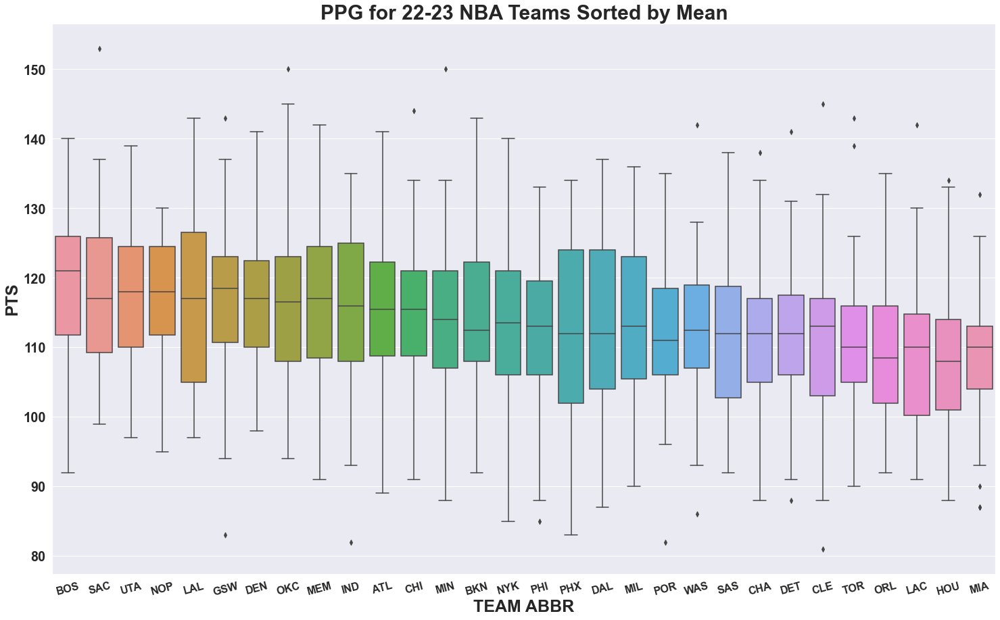

In [15]:
fig, (ax1) = plt.subplots(1, 1)

sns.set(rc={'figure.figsize':(25,15)})

means_ppg = df.groupby(['TEAM_ABBREVIATION'])['PTS'].mean().sort_values(ascending=[False])
sns.boxplot(data=df, x=df.TEAM_ABBREVIATION, y='PTS', order=means_ppg.index, ax=ax1)
ax1.set_title('PPG for 22-23 NBA Teams Sorted by Mean', fontsize=30, fontweight='bold')

#medians_ppg = df.groupby(['TEAM_ABBREVIATION'])['PTS'].median().sort_values(ascending=[False])
#sns.boxplot(data=df, x=df.TEAM_ABBREVIATION, y='PTS', order=medians_ppg.index, ax=ax2)
#ax2.set_title('PPG for 22-23 NBA Teams Sorted by Median', fontsize=20)

plt.xticks(rotation=15, fontsize=16, fontweight='bold')
plt.xlabel('TEAM ABBR', fontsize=25, fontweight='bold')

plt.yticks(rotation=0, fontsize=20, fontweight='bold')

plt.ylabel('PTS', fontsize=25, fontweight='bold')


plt.show()

# TURN THIS INTO FUNCTION

### Points Allowed Per Game

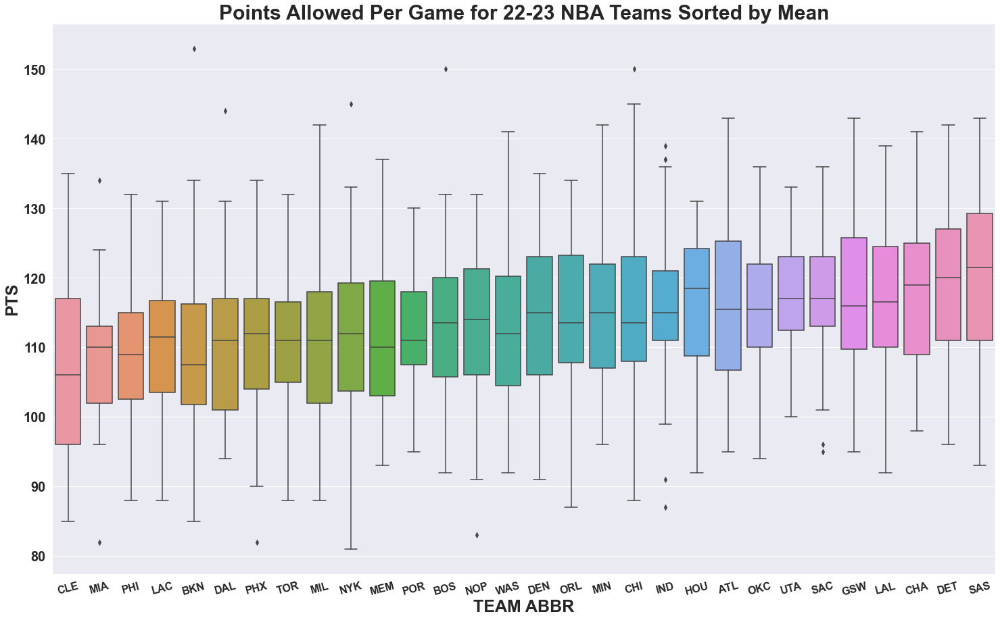

In [24]:
fig, (ax1) = plt.subplots(1, 1)

sns.set(rc={'figure.figsize':(25,15)})

means_ppg = df.groupby(['OPP_TEAM_ABBR'])['PTS'].mean().sort_values(ascending=[True])
sns.boxplot(data=df, x=df.OPP_TEAM_ABBR, y='PTS', order=means_ppg.index, ax=ax1)
ax1.set_title('Points Allowed Per Game for 22-23 NBA Teams Sorted by Mean', fontsize=30, fontweight='bold')

#medians_ppg = df.groupby(['OPP_TEAM_ABBR'])['PTS'].median().sort_values(ascending=[True])
#sns.boxplot(data=df, x=df.OPP_TEAM_ABBR, y='PTS', order=medians_ppg.index, ax=ax2)
#ax2.set_title('Points Allowed Per Game for 22-23 NBA Teams Sorted by Medians', fontsize=20)

plt.xticks(rotation=15, fontsize=16, fontweight='bold')
plt.xlabel('TEAM ABBR', fontsize=25, fontweight='bold')

plt.yticks(rotation=0, fontsize=20, fontweight='bold')

plt.ylabel('PTS', fontsize=25, fontweight='bold')

plt.show()

# TURN THIS INTO FUNCTION

# Visualizations Functions

## Plus-Minus Visualization Function

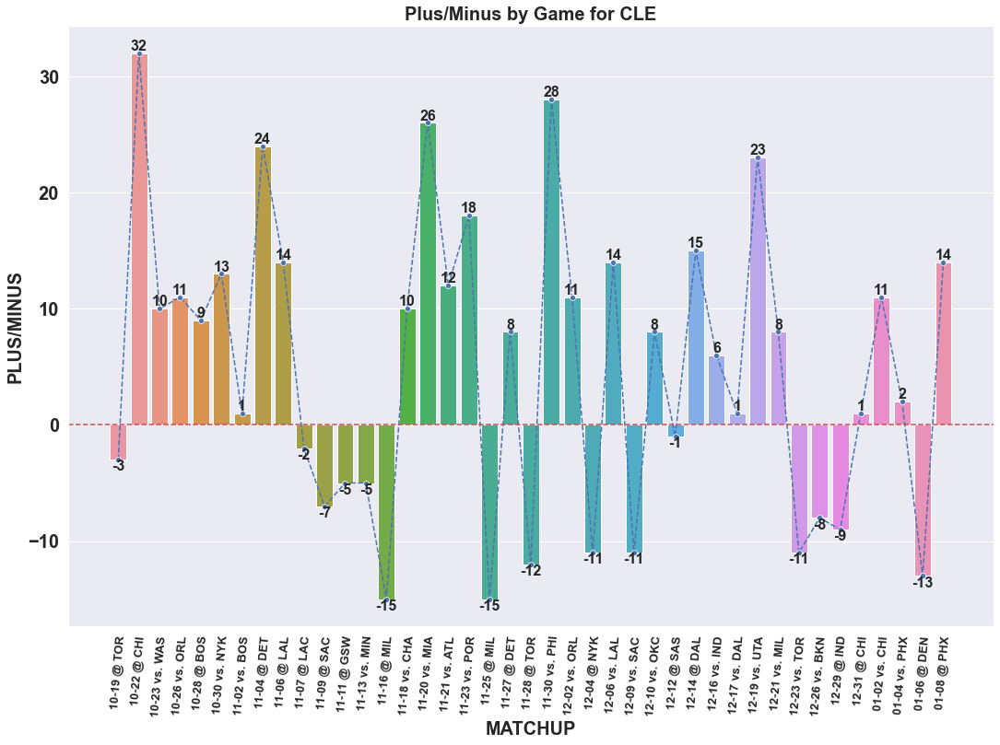

In [25]:
def plus_minus_plot(team_abbr):
    sns.set(rc={'figure.figsize':(18,12)})

    df = get_team_df(team_abbr).sort_values(by='GAME_DATE').reset_index(drop=True)

    ax1=sns.barplot(data=df, x=df.index, y="PLUS_MINUS")
    ax1.bar_label(ax1.containers[0], fontsize=16, fontweight='bold')
    plt.title(f"Plus/Minus by Game for {team_abbr}", fontsize=20, fontweight='bold')

    ax2=sns.lineplot(data=df, x=df.index, y="PLUS_MINUS",linestyle='--', marker='o')
    plt.xticks(rotation=85)
    plt.axhline(y=0, color='r', linestyle='--')

    plt.xticks(df.index,df["DATE_MATCHUP"].values, fontsize=13, fontweight='bold')
    plt.xlabel('MATCHUP', fontsize=20, fontweight='bold')

    plt.yticks(rotation=0, fontsize=20, fontweight='bold')
    plt.ylabel('PLUS/MINUS', fontsize=20, fontweight='bold')

    plt.show()
    
plus_minus_plot('CLE')

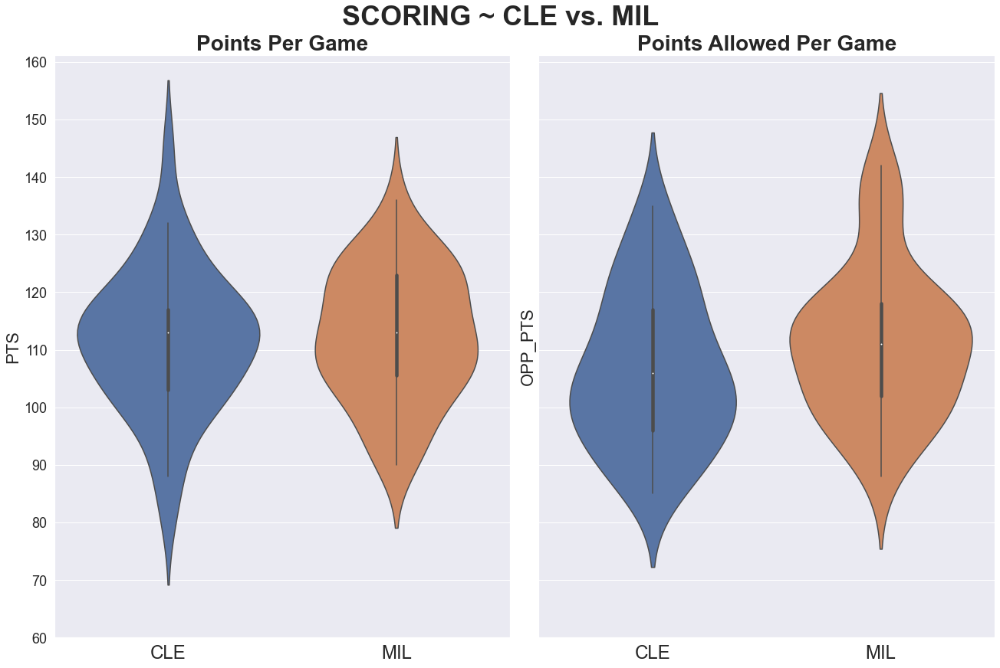

In [26]:
def scored_allowed_compare(team_a_abbr, team_b_abbr):
    df_a = get_team_df(team_a_abbr)
    df_b = get_team_df(team_b_abbr)
    df_merged = pd.concat([df_a,df_b])

    fig, axs = plt.subplots(ncols=2, sharey=True, constrained_layout=True)
    sns.set(rc={'figure.figsize':(18,12)})

    ax2 = sns.violinplot(data=df_merged, x=df_merged.TEAM_ABBREVIATION, y='OPP_PTS', ax=axs[1])
    ax2.set_title('Points Allowed Per Game', fontsize=28, fontweight='bold')
    ax2.tick_params(axis='x', which='major', labelsize=24)
    ax2.set_xlabel('')
    ax2.set_ylabel('OPP_PTS', fontsize=22)

    ax1 = sns.violinplot(data=df_merged, x=df_merged.TEAM_ABBREVIATION, y='PTS', ax=axs[0])
    ax1.set_title('Points Per Game', fontsize=28, fontweight='bold')
    ax1.tick_params(axis='x', which='major', labelsize=24)
    ax1.tick_params(axis='y', which='major', labelsize=18)
    ax1.set_ylabel('PTS', fontsize=22)
    ax1.set_xlabel('')

    plt.yticks([60,70,80,90,100,110,120,130,140,150,160])
    fig.suptitle(f'SCORING ~ {team_a_abbr} vs. {team_b_abbr}', fontsize=36, fontweight='bold')
    plt.show()
    
scored_allowed_compare("CLE", "MIL")

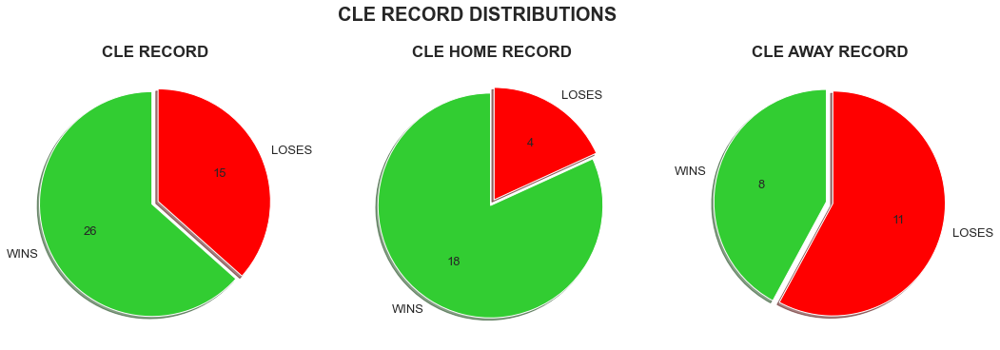

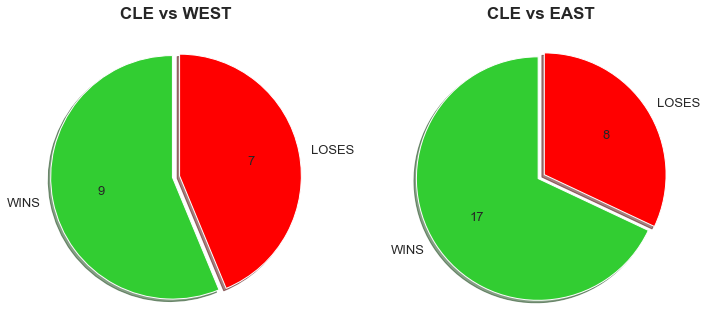

In [21]:
def wl_pies(team_abbr):
    wl_data = np.array([df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].WINS.item(), df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].LOSES.item()])
    wl_data_home = np.array([df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].HOME_WINS.item(), df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].HOME_LOSES.item()])
    wl_data_away = np.array([df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].AWAY_WINS.item(), df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].AWAY_LOSES.item()])

    labels = ['WINS','LOSES']
    colors = ['limegreen', 'red']
    explode=[0.03,0.03]

    def absolute_value_wl(val):
        a  = np.round(val/100.*wl_data.sum(), 0)
        return int(a)

    def absolute_value_wl_home(val):
        a  = np.round(val/100.*wl_data_home.sum(), 0)
        return int(a)

    def absolute_value_wl_away(val):
        a  = np.round(val/100.*wl_data_away.sum(), 0)
        return int(a)

    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))


    ax[0].pie(wl_data,
            labels=labels,
            explode=explode,
            startangle = 90,
            colors=colors,
            shadow = True,
            autopct=absolute_value_wl,
            textprops={'fontsize': 13})
    ax[0].set_title(f"{team_abbr} RECORD", fontsize= 17, fontweight='bold')

    ax[1].pie(wl_data_home,
            labels=labels,
            explode=explode,
            startangle = 90,
            colors=colors,
            shadow = True,
            autopct=absolute_value_wl_home,
            textprops={'fontsize': 13})
    ax[1].set_title(f"{team_abbr} HOME RECORD", fontsize= 17, fontweight='bold')

    ax[2].pie(wl_data_away,
            labels=labels,
            explode=explode,
            startangle = 90,
            colors=colors,
            shadow = True,
            autopct=absolute_value_wl_away,
            textprops={'fontsize': 13})
    ax[2].set_title(f"{team_abbr} AWAY RECORD", fontsize= 17, fontweight='bold')

    fig.suptitle(f'{team_abbr} RECORD DISTRIBUTIONS', fontsize=20, fontweight="bold")

    wl_pies_EW(team_abbr)

    plt.show()


def wl_pies_EW(team_abbr):
    wl_data_east = np.array([df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].EAST_WINS.item(), df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].EAST_LOSES.item()])
    wl_data_west = np.array([df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].WEST_WINS.item(), df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr].WEST_LOSES.item()])

    labels = ['WINS','LOSES']
    colors = ['limegreen', 'red']
    explode=[0.03,0.03]

    def absolute_value_wl_east(val):
        a  = np.round(val/100.*wl_data_east.sum(), 0)
        return int(a)

    def absolute_value_wl_west(val):
        a  = np.round(val/100.*wl_data_west.sum(), 0)
        return int(a)

    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))


    ax[0].pie(wl_data_west,
            labels=labels,
            explode=explode,
            startangle = 90,
            colors=colors,
            shadow = True,
            autopct=absolute_value_wl_west,
            textprops={'fontsize': 13})
    ax[0].set_title(f"{team_abbr} vs WEST", fontsize= 17, fontweight='bold')

    ax[1].pie(wl_data_east,
            labels=labels,
            explode=explode,
            startangle = 90,
            colors=colors,
            shadow = True,
            autopct=absolute_value_wl_east,
            textprops={'fontsize': 13})
    ax[1].set_title(f"{team_abbr} vs EAST", fontsize= 17, fontweight='bold')

    plt.show()
    
wl_pies("CLE")

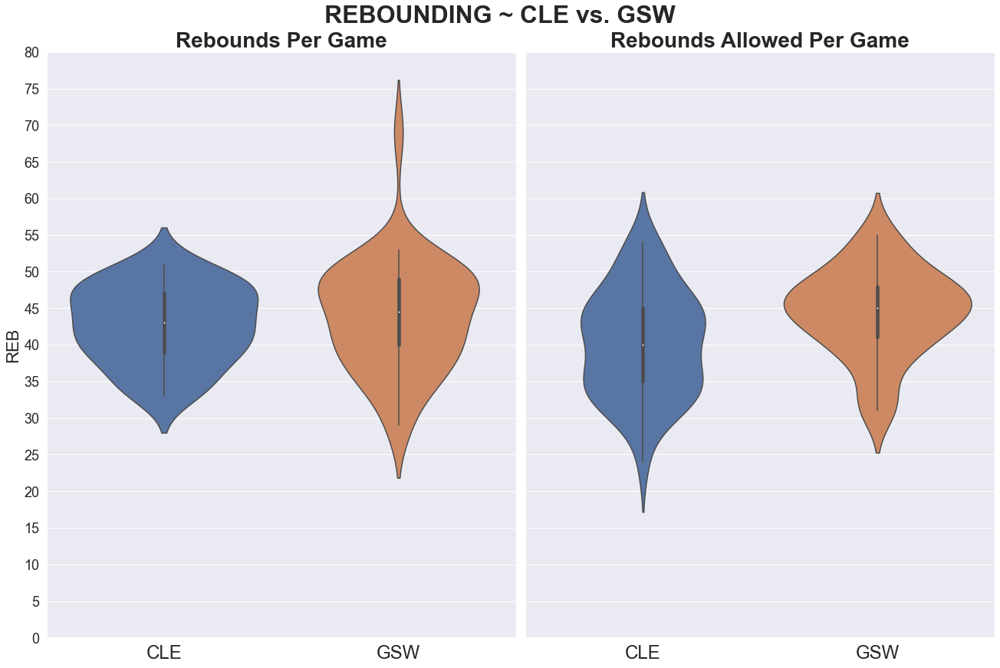

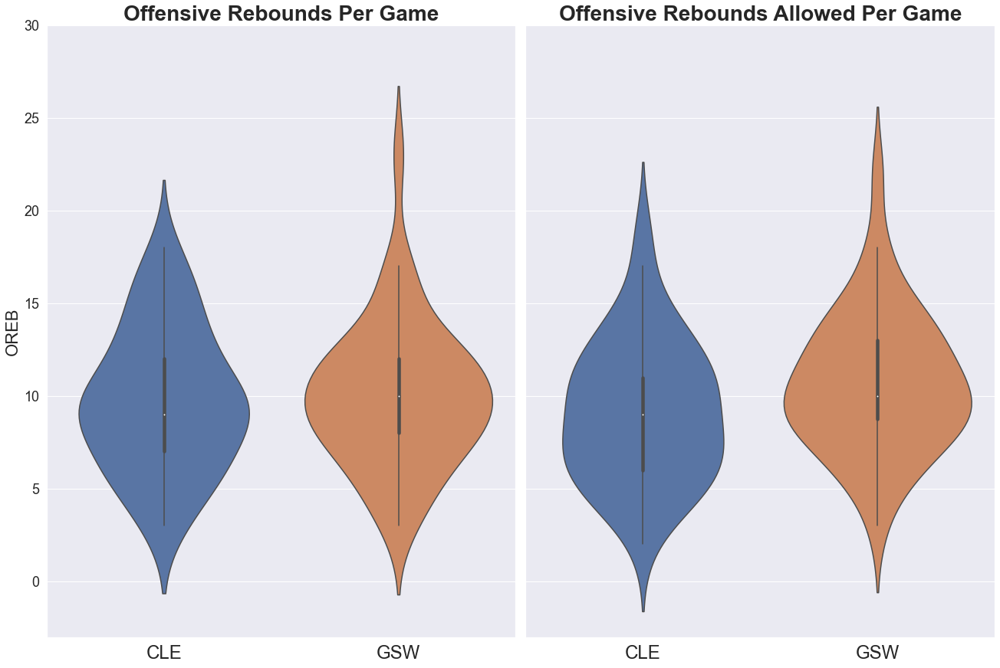

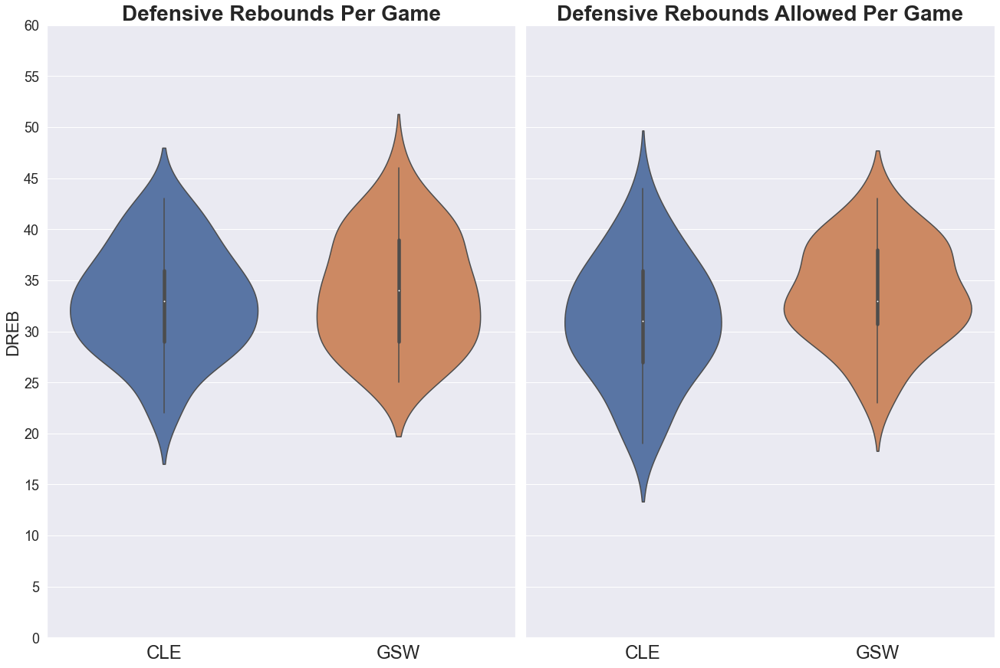

In [27]:
def rebounds_compare(team_a_abbr, team_b_abbr):
    df_a = get_team_df(team_a_abbr)
    df_b = get_team_df(team_b_abbr)
    df_merged = pd.concat([df_a,df_b])

    df_a_def = df[df.OPP_TEAM_ABBR== team_a_abbr]
    df_b_def = df[df.OPP_TEAM_ABBR== team_b_abbr]
    df_def_merged = pd.concat([df_a_def, df_b_def])

    fig, axs = plt.subplots(nrows=1, ncols=2, sharex='col',constrained_layout=True, sharey=True)

    sns.set(rc={'figure.figsize':(18,12)})

    ax1 = sns.violinplot(data=df_merged, x=df_merged.TEAM_ABBREVIATION, y='REB', ax=axs[0])
    ax1.set_title(f'Rebounds Per Game', fontsize=28, fontweight='bold')
    ax1.set_xlabel('')
    ax1.set_ylabel('REB', fontsize=22)
    ax1.tick_params(axis='x', which='major', labelsize=24)
    ax1.tick_params(axis='y', which='major', labelsize=18)

    ax2 = sns.violinplot(data=df_def_merged, x=df_def_merged.OPP_TEAM_ABBR, y='REB', ax=axs[1])
    ax2.set_title(f'Rebounds Allowed Per Game', fontsize=28, fontweight='bold')
    ax2.set_xlabel('')
    ax2.set_ylabel('')
    ax2.tick_params(axis='x', which='major', labelsize=24)

    plt.yticks([0,5,10,15,20,25,30,35,40, 45, 50, 55, 60, 65, 70, 75, 80])

    fig.suptitle(f'REBOUNDING ~ {team_a_abbr} vs. {team_b_abbr}', fontsize=32, fontweight='extra bold')
    plt.show()

    print()
    oreb_compare(team_a_abbr,team_b_abbr)
    print()
    dreb_compare(team_a_abbr,team_b_abbr)
    print()

    # ADD REBOUNDING DIFFERENTIALS

def oreb_compare(team_a_abbr, team_b_abbr):
    df_a = get_team_df(team_a_abbr)
    df_b = get_team_df(team_b_abbr)
    df_merged = pd.concat([df_a,df_b])

    df_a_def = df[df.OPP_TEAM_ABBR== team_a_abbr]
    df_b_def = df[df.OPP_TEAM_ABBR== team_b_abbr]
    df_def_merged = pd.concat([df_a_def, df_b_def])

    fig, axs = plt.subplots(nrows=1, ncols=2, sharex='col',constrained_layout=True, sharey=True)

    sns.set(rc={'figure.figsize':(18,12)})

    ax1 = sns.violinplot(data=df_merged, x=df_merged.TEAM_ABBREVIATION, y='OREB', ax=axs[0])
    ax1.set_title(f'Offensive Rebounds Per Game', fontsize=28, fontweight='bold')
    ax1.set_xlabel('')
    ax1.set_ylabel('OREB', fontsize=22)
    ax1.tick_params(axis='x', which='major', labelsize=24)
    ax1.tick_params(axis='y', which='major', labelsize=18)

    ax2 = sns.violinplot(data=df_def_merged, x=df_def_merged.OPP_TEAM_ABBR, y='OREB', ax=axs[1])
    ax2.set_title(f'Offensive Rebounds Allowed Per Game', fontsize=28, fontweight='bold')
    ax2.set_xlabel('')
    ax2.set_ylabel('')
    ax2.tick_params(axis='x', which='major', labelsize=24)

    plt.yticks([0,5,10,15,20,25,30])

    plt.show()

def dreb_compare(team_a_abbr, team_b_abbr):
    df_a = get_team_df(team_a_abbr)
    df_b = get_team_df(team_b_abbr)
    df_merged = pd.concat([df_a,df_b])

    df_a_def = df[df.OPP_TEAM_ABBR== team_a_abbr]
    df_b_def = df[df.OPP_TEAM_ABBR== team_b_abbr]
    df_def_merged = pd.concat([df_a_def, df_b_def])

    fig, axs = plt.subplots(nrows=1, ncols=2, sharex='col',constrained_layout=True, sharey=True)

    sns.set(rc={'figure.figsize':(18,12)})

    ax1 = sns.violinplot(data=df_merged, x=df_merged.TEAM_ABBREVIATION, y='DREB', ax=axs[0])
    ax1.set_title(f'Defensive Rebounds Per Game', fontsize=28, fontweight='bold')
    ax1.set_xlabel('')
    ax1.set_ylabel('DREB', fontsize=22)
    ax1.tick_params(axis='x', which='major', labelsize=24)
    ax1.tick_params(axis='y', which='major', labelsize=18)

    ax2 = sns.violinplot(data=df_def_merged, x=df_def_merged.OPP_TEAM_ABBR, y='DREB', ax=axs[1])
    ax2.set_title(f'Defensive Rebounds Allowed Per Game', fontsize=28, fontweight='bold')
    ax2.set_xlabel('')
    ax2.set_ylabel('')
    ax2.tick_params(axis='x', which='major', labelsize=24)

    plt.yticks([0,5,10,15,20,25,30,35,40,45,50,55,60])

    plt.show()
    
rebounds_compare('CLE','GSW')

## Function to line plot scores

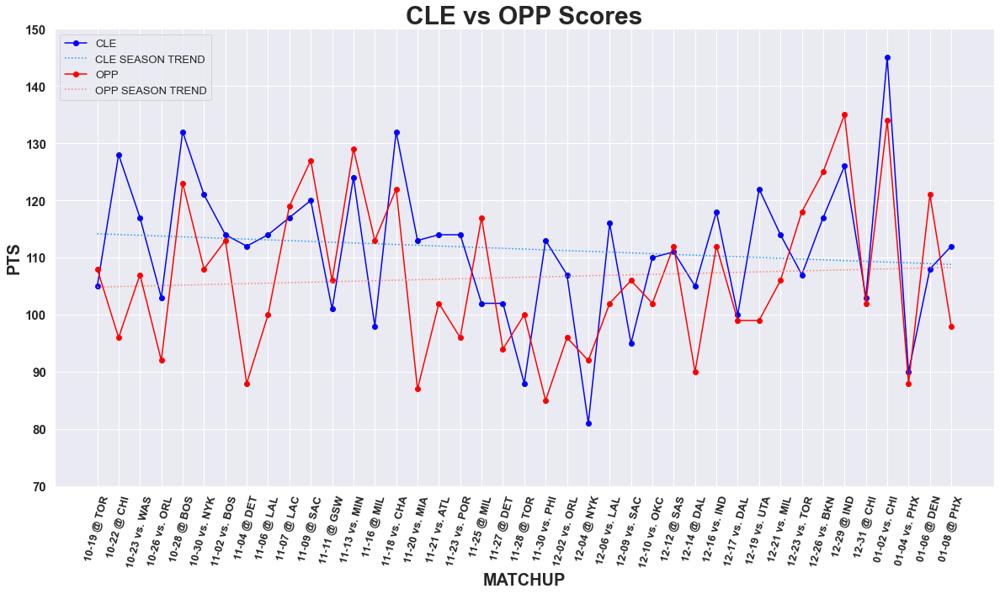

In [28]:
def line_plot_scores(team_abbr):
    plt.rcParams["figure.figsize"] = (20,10)
    df = get_team_df(team_abbr).sort_values(by='GAME_DATE').reset_index(drop=True)
    
    team_score = plt.plot(df.index, df['PTS'], marker='o', label=team_abbr, color='blue')
    z = np.polyfit(df.index, df['PTS'], 1)
    p = np.poly1d(z)
    team_trend = plt.plot(df.index,p(df.index), linestyle='dotted',linewidth=1.5, color='dodgerblue', label=f'{team_abbr} SEASON TREND')
    
    opp_score = plt.plot(df.index, df['OPP_PTS'], marker='o', label='OPP', color='red')
    z = np.polyfit(df.index, df['OPP_PTS'], 1)
    p = np.poly1d(z)
    opp_trend = plt.plot(df.index,p(df.index),linestyle='dotted',linewidth=1.5, color='salmon', label='OPP SEASON TREND')
    
    plt.legend(loc='best', fontsize=13)
    plt.title(f'{team_abbr} vs OPP Scores',fontsize=30, fontweight='bold')
    plt.xticks(df.index,df["DATE_MATCHUP"].values)
    plt.xticks(rotation=75, fontsize=13, fontweight='bold')
    plt.yticks(list(range(0,160,10)), fontsize=15, fontweight='bold')
    plt.ylim(70, 150)
    plt.xlabel('MATCHUP',fontsize=20, fontweight='bold')
    plt.ylabel('PTS', fontsize=20, fontweight='bold')
    plt.show()
    
line_plot_scores("CLE")

## Function to plot scoring trendlines

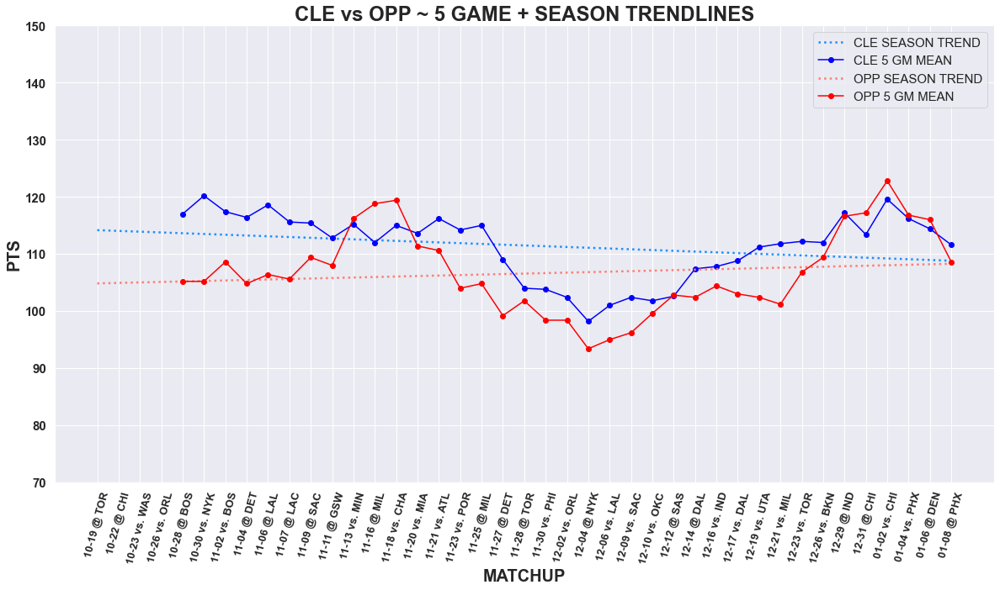

In [29]:
def trend_plot_scores(team_abbr):
    plt.rcParams["figure.figsize"] = (20,10)
    df = get_team_df(team_abbr).sort_values(by='GAME_DATE').reset_index(drop=True)
    
    z = np.polyfit(df.index, df['PTS'], 1)
    p = np.poly1d(z)
    team_trend = plt.plot(df.index,p(df.index), linestyle='dotted',linewidth=2.5, color='dodgerblue', label=f'{team_abbr} SEASON TREND')
    
    rolling_mean = df.PTS.rolling(5).mean()
    rolling_mean_plot = plt.plot(rolling_mean, color="BLUE", alpha=1,marker='o', label=f"{team_abbr} 5 GM MEAN")
    
    z = np.polyfit(df.index, df['OPP_PTS'], 1)
    p = np.poly1d(z)
    opp_trend = plt.plot(df.index,p(df.index),linestyle='dotted',linewidth=2.5, color='salmon', label='OPP SEASON TREND')
    
    rolling_mean = df.OPP_PTS.rolling(5).mean()
    rolling_mean_plot = plt.plot(rolling_mean, color="RED", alpha=1,marker='o', label=f"OPP 5 GM MEAN")
    
    plt.legend(loc='best', fontsize=15)
    plt.title(f'{team_abbr} vs OPP ~ 5 GAME + SEASON TRENDLINES',fontsize=24, fontweight='bold')
    plt.xticks(df.index,df["DATE_MATCHUP"].values)
    plt.xticks(rotation=75, fontsize=13, fontweight='bold')
    plt.yticks(list(range(0,160,10)), fontsize=15,  fontweight='bold')
    plt.ylim(70, 150)
    
    plt.xlabel('MATCHUP', fontsize=20, fontweight='bold')
    plt.ylabel('PTS', fontsize=20, fontweight='bold')
    plt.show()
    
trend_plot_scores("CLE")

## Function to pie plot 2s vs 3s (attempts, makes)

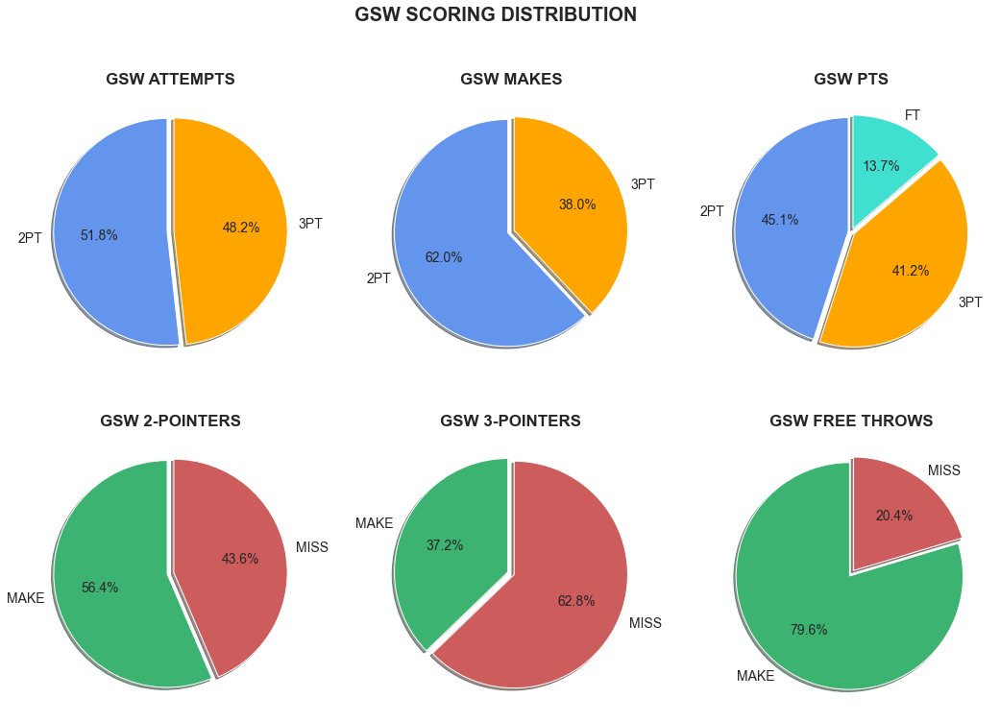

In [30]:
def shot_pies(team_abbr):
    
    df_team = df_team_avg[df_team_avg['TEAM_ABBR']==team_abbr]
    
    data_att = [df_team.FRAC_ATT_2PT.item(), df_team.FRAC_ATT_3PT.item()]
    data_mk = [df_team.FRAC_MK_2PT.item(), df_team.FRAC_MK_3PT.item()]
    data_pts = [df_team.FRAC_PTS_2PT.item(), df_team.FRAC_PTS_3PT.item(), df_team.FRAC_PTS_FT.item()]
    
    data_2pt = [df_team.FG2M.item(), (df_team.FG2A.item() - df_team.FG2M.item())]
    data_3pt = [df_team.FG3M.item(), (df_team.FG3A.item() - df_team.FG3M.item())]
    data_ft = [df_team.FTM.item(), (df_team.FTA.item() - df_team.FTM.item())]
    
    labels1 = ['2PT', '3PT']
    labels2 = ['2PT', '3PT', 'FT']
    labels3 = ['MAKE', 'MISS']
    explode1 = [0.03, 0.03]
    explode2 = [0.03,0.03,0.03]
    colors0 = ['cornflowerblue', 'orange']
    colors1= ['cornflowerblue', 'orange', 'turquoise']
    colors2 = ['mediumseagreen','indianred']
    
    fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(18, 12))
    
    ax[0,0].pie(data_att,
              labels=labels1,
              explode=explode1,
              shadow=True,
              colors=colors0,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[0,0].set_title(f'{team_abbr} ATTEMPTS', fontsize=17, fontweight='bold')
    
    ax[0,1].pie(data_mk,
              labels=labels1,
              explode=explode1,
              shadow=True,
              colors=colors0,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[0,1].set_title(f'{team_abbr} MAKES', fontsize=17, fontweight='bold')
    
    ax[0,2].pie(data_pts,
              labels=labels2,
              explode=explode2,
              shadow=True,
              colors=colors1,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[0,2].set_title(f'{team_abbr} PTS', fontsize=17, fontweight='bold')
    
    ax[1,0].pie(data_2pt,
              labels=labels3,
              explode=explode1,
              colors=colors2,
              shadow=True,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[1,0].set_title(f'{team_abbr} 2-POINTERS', fontsize=17, fontweight='bold')
    
    ax[1,1].pie(data_3pt,
              labels=labels3,
              explode=explode1,
              colors=colors2,
              shadow=True,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[1,1].set_title(f'{team_abbr} 3-POINTERS', fontsize=17, fontweight='bold')
    
    ax[1,2].pie(data_ft,
              labels=labels3,
              explode=explode1,
              colors=colors2,
              shadow=True,
              autopct='%1.1f%%',
              textprops={'fontsize': 14},
              startangle=90)
    ax[1,2].set_title(f'{team_abbr} FREE THROWS', fontsize=17, fontweight='bold')
    
    fig.suptitle(f'{team_abbr} SCORING DISTRIBUTION', fontsize=20, fontweight="bold")
    plt.show()
    
shot_pies('GSW')

## Regression Analysis Plots ~ 22-23 NBA and Team Data

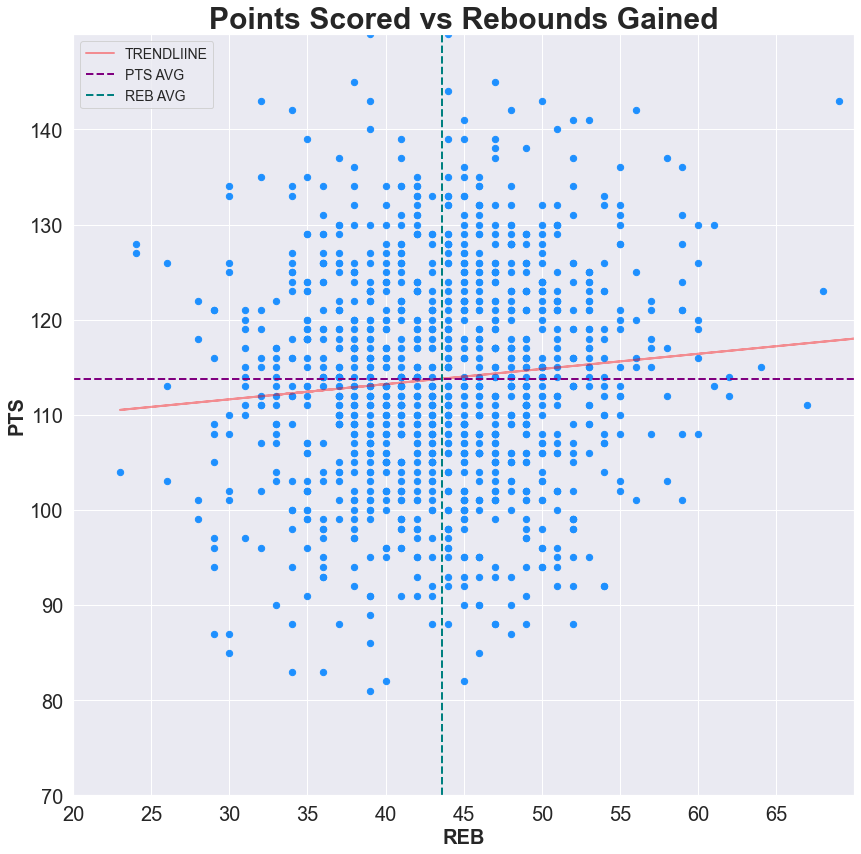

Season Trend Line Equation
y=0.159494x+(106.839612)


In [52]:
plt.rcParams["figure.figsize"] = (14,14)

x=df.REB
y=df.PTS

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, color='dodgerblue', s=40)

plt.axhline(df.PTS.mean(), label="PTS AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axvline(df.REB.mean(), label="REB AVG", linestyle='dashed', color='teal', linewidth=2)

plt.xlim(20,70)
plt.xticks(list(range(20,70,5)), fontsize=20)
plt.xlabel('REB', fontsize=20, fontweight='bold')

plt.ylim(70, 150)
plt.yticks(list(range(70,150,10)), fontsize=20)
plt.ylabel('PTS', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Points Scored vs Rebounds Gained', fontsize=30, fontweight='bold')

plt.show()

print(color.BOLD +'Season Trend Line Equation' +color.END)
print("y=%.6fx+(%.6f)"%(z[0],z[1]))

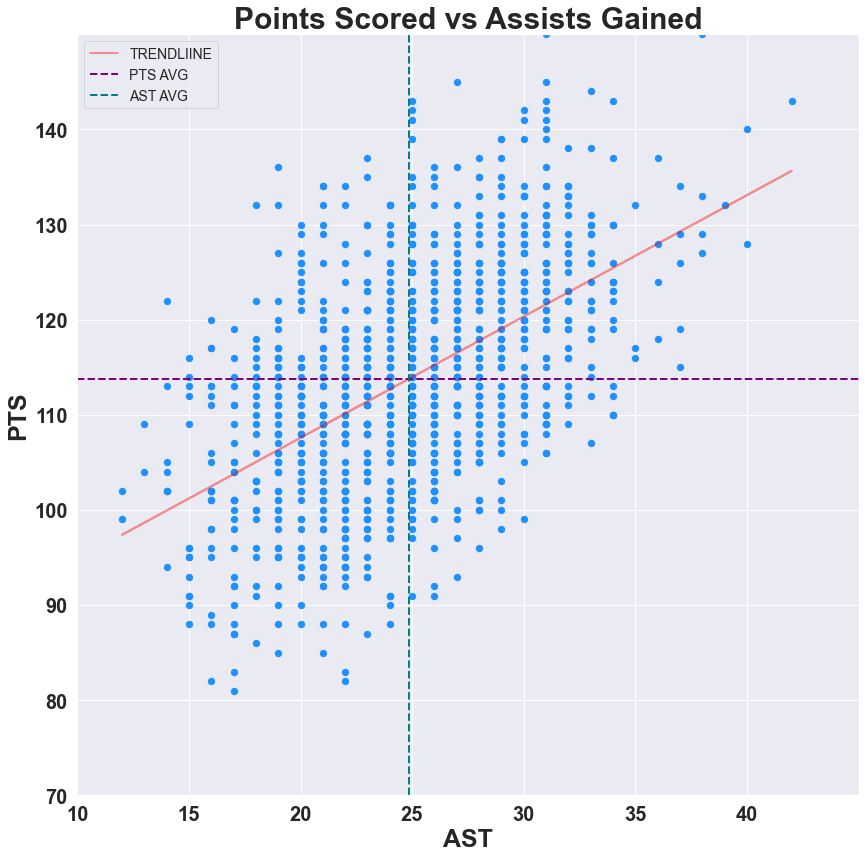

Season Trend Line Equation
y=1.275194x+(82.076966)


In [53]:
plt.rcParams["figure.figsize"] = (14,14)

x=df.AST
y=df.PTS

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, color='dodgerblue', s=40)

plt.axhline(df.PTS.mean(), label="PTS AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axvline(df.AST.mean(), label="AST AVG", linestyle='dashed', color='teal', linewidth=2)

plt.xlim(10,45)
plt.xticks(list(range(10,45,5)), fontsize=20, fontweight='bold')
plt.xlabel('AST', fontsize=25, fontweight='bold')

plt.ylim(70, 150)
plt.yticks(list(range(70,150,10)), fontsize=20, fontweight='bold')
plt.ylabel('PTS', fontsize=25, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Points Scored vs Assists Gained', fontsize=30, fontweight='bold')

plt.show()

print(color.BOLD +'Season Trend Line Equation' + color.END)
print("y=%.6fx+(%.6f)"%(z[0],z[1]))

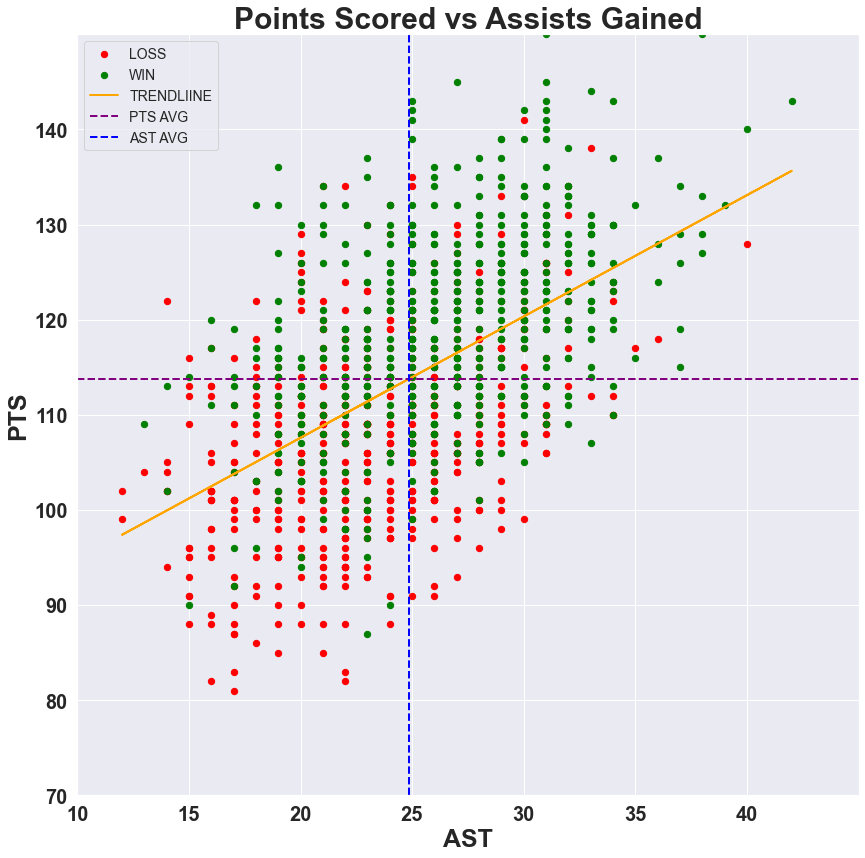

Season Trend Line Equation
y=1.275194x+(82.076966)


In [54]:
plt.rcParams["figure.figsize"] = (14,14)

x=df.AST
y=df.PTS

x_L=df[df.WL=='L'].AST
y_L=df[df.WL=='L'].PTS

x_W=df[df.WL=='W'].AST
y_W=df[df.WL=='W'].PTS

plt.scatter(x_L,y_L, color='red', label='LOSS', s=40)
plt.scatter(x_W,y_W, color='green', label='WIN', s=40)

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=1, color='orange', linewidth=2)

plt.axhline(df.PTS.mean(), label="PTS AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axvline(df.AST.mean(), label="AST AVG", linestyle='dashed', color='blue', linewidth=2)

plt.xlim(10,45)
plt.xticks(list(range(10,45,5)), fontsize=20, fontweight='bold')
plt.xlabel('AST', fontsize=25, fontweight='bold')

plt.ylim(70, 150)
plt.yticks(list(range(70,150,10)), fontsize=20, fontweight='bold')
plt.ylabel('PTS', fontsize=25, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Points Scored vs Assists Gained', fontsize=30, fontweight='bold')

plt.show()

print(color.BOLD +'Season Trend Line Equation' + color.END)
print("y=%.6fx+(%.6f)"%(z[0],z[1]))

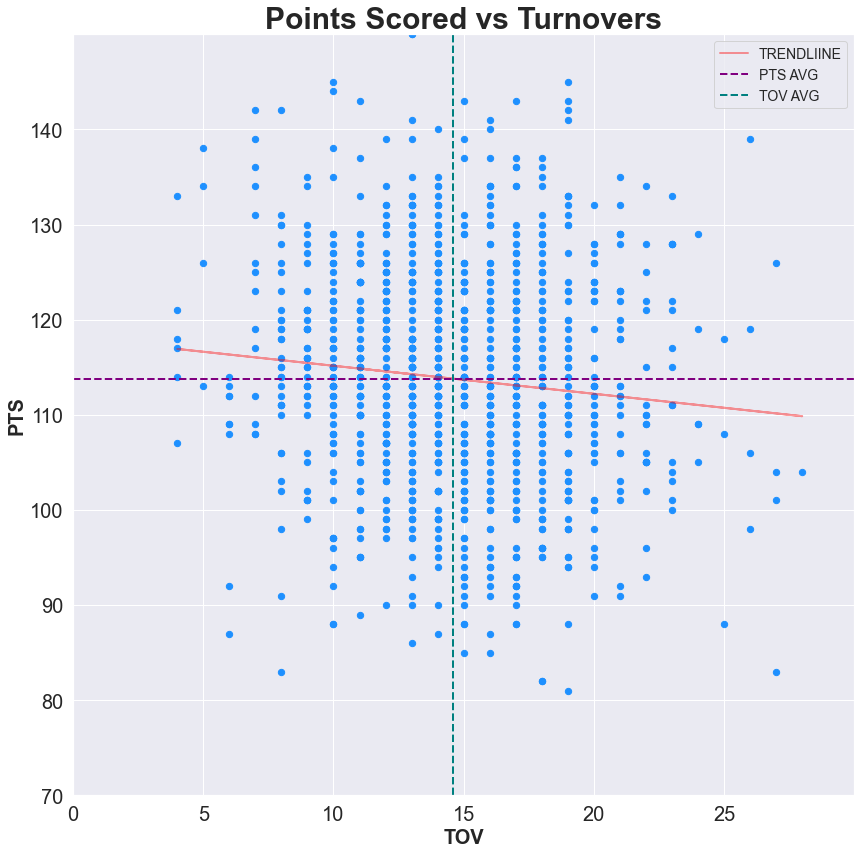

Season Trend Line Equation
y=-0.294500x+(118.097326)


In [56]:
plt.rcParams["figure.figsize"] = (14,14)

x=df.TOV
y=df.PTS

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, color='dodgerblue', s=40)

plt.axhline(df.PTS.mean(), label="PTS AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axvline(df.TOV.mean(), label="TOV AVG", linestyle='dashed', color='teal', linewidth=2)

plt.xlim(0,30)
plt.xticks(list(range(0,30,5)), fontsize=20)
plt.xlabel('TOV', fontsize=20, fontweight='bold')

plt.ylim(70, 150)
plt.yticks(list(range(70,150,10)), fontsize=20)
plt.ylabel('PTS', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Points Scored vs Turnovers', fontsize=30, fontweight='bold')

plt.show()

print(color.BOLD +'Season Trend Line Equation' + color.END)
print("y=%.6fx+(%.6f)"%(z[0],z[1]))

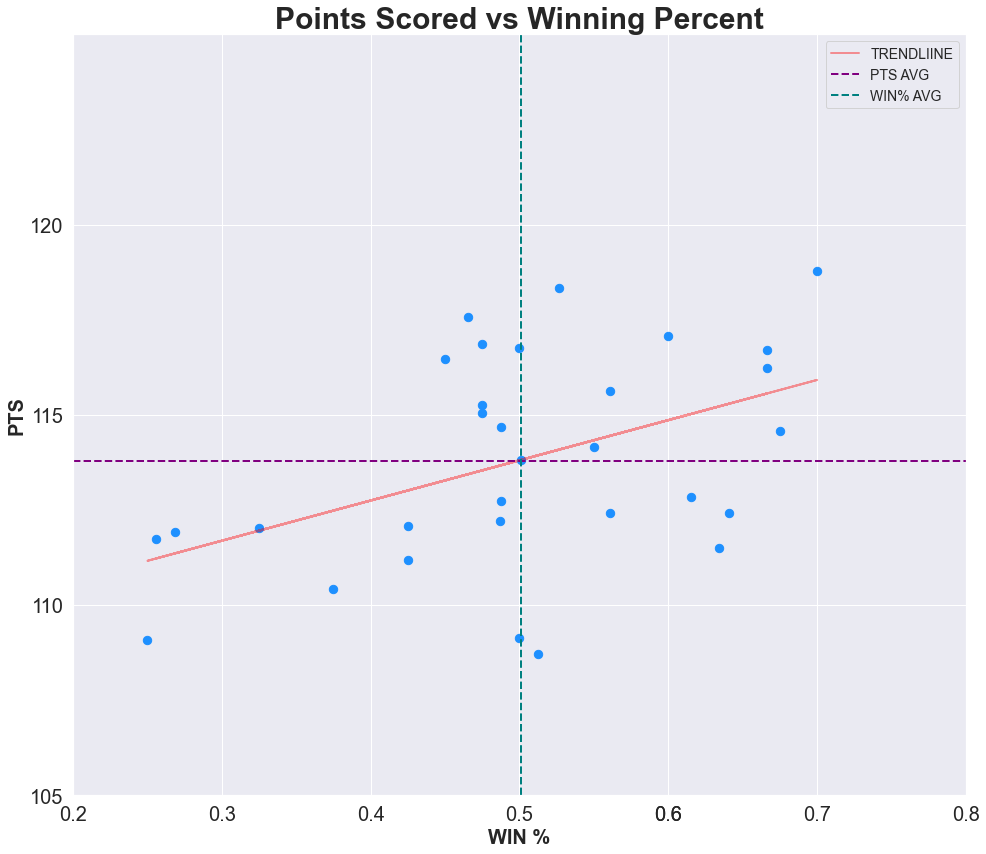

Season Trend Line Equation
y=10.562605x+(108.521970)

R-squared: 0.20851996062468847


In [66]:
plt.rcParams["figure.figsize"] = (16,14)

x=df_team_avg.WIN_PER
y=df_team_avg.PTS

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, s=70, c='dodgerblue')

plt.axhline(df.PTS.mean(), label="PTS AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axvline(df_team_avg.WIN_PER.mean(), label="WIN% AVG", linestyle='dashed', color='teal', linewidth=2)

plt.xlim(0.2,0.8)
plt.xticks([0.2,0.3,0.4,0.5,0.6,0.6,0.7,0.8], fontsize=20)
plt.xlabel('WIN %', fontsize=20, fontweight='bold')

plt.ylim(105, 125)
plt.yticks(list(range(105,125,5)), fontsize=20)
plt.ylabel('PTS', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Points Scored vs Winning Percent', fontsize=30, fontweight='bold')
plt.show()

print(color.BOLD +'Season Trend Line Equation' + color.END)
print("y=%.6fx+(%.6f)"%(z[0],z[1]))

# Calc R-squared
model = LinearRegression()
model.fit(x.values.reshape(-1, 1), y)
r_squared = model.score(x.values.reshape(-1, 1), y)
print()
print(color.BOLD + "R-squared: "+ color.END + str(r_squared))

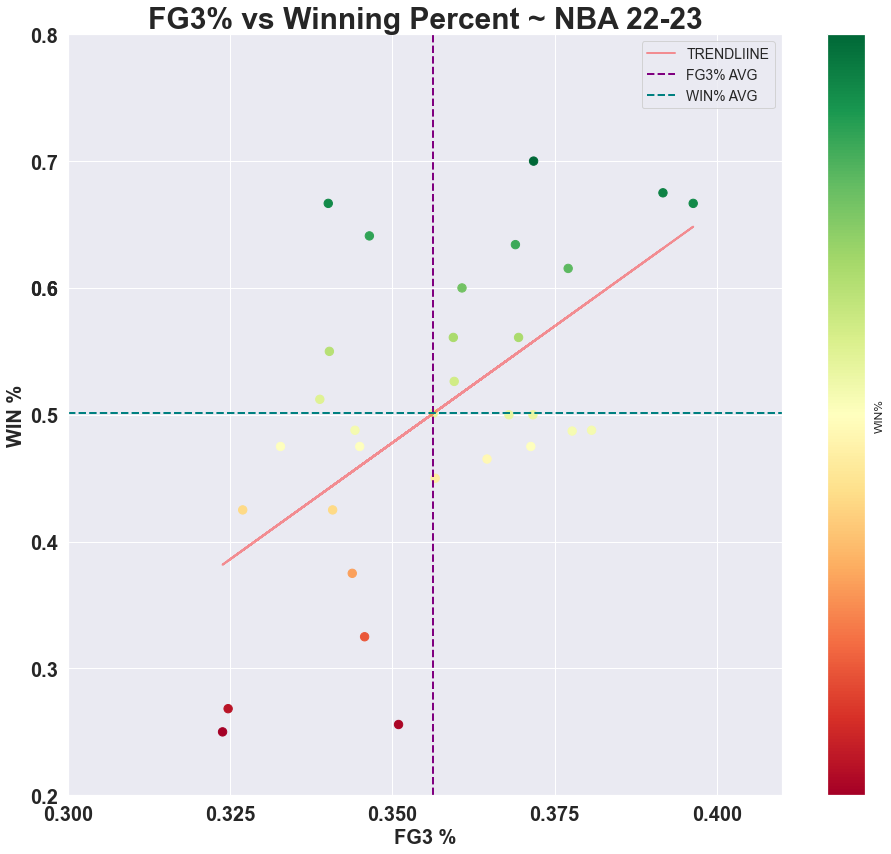


Season Trend Line Equation: y = 3.676831x + (-0.808950)

R-squared: 0.33405329898648883


In [67]:
plt.rcParams["figure.figsize"] = (16,14)

y=df_team_avg.WIN_PER
x=df_team_avg.FG3_PCT

# calc the trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, c=y, cmap='RdYlGn', s=70)

plt.axvline(df.FG3_PCT.mean(), label="FG3% AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axhline(df_team_avg.WIN_PER.mean(), label="WIN% AVG", linestyle='dashed', color='teal', linewidth=2)

plt.ylim(0.2,0.8)
plt.yticks([0.2,0.3,0.4,0.5,0.6,0.6,0.7,0.8], fontsize=20, fontweight='bold')
plt.ylabel('WIN %', fontsize=20, fontweight='bold')

plt.xlim(0.3, 0.41)
plt.xticks([0.3,0.325,0.35,0.375,0.4], fontsize=20, fontweight='bold')
plt.xlabel('FG3 %', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('FG3% vs Winning Percent ~ NBA 22-23', fontsize=30, fontweight='bold')
plt.colorbar(label='WIN%', ticks=np.linspace(0.2,0.,8))
plt.show()

print()
print(color.BOLD +'Season Trend Line Equation: ' + color.END + "y = %.6fx + (%.6f)"%(z[0],z[1]))

# Calc R-squared
model = LinearRegression()
model.fit(x.values.reshape(-1, 1), y)
r_squared = model.score(x.values.reshape(-1, 1), y)
print()
print(color.BOLD + "R-squared: "+ color.END + str(r_squared))

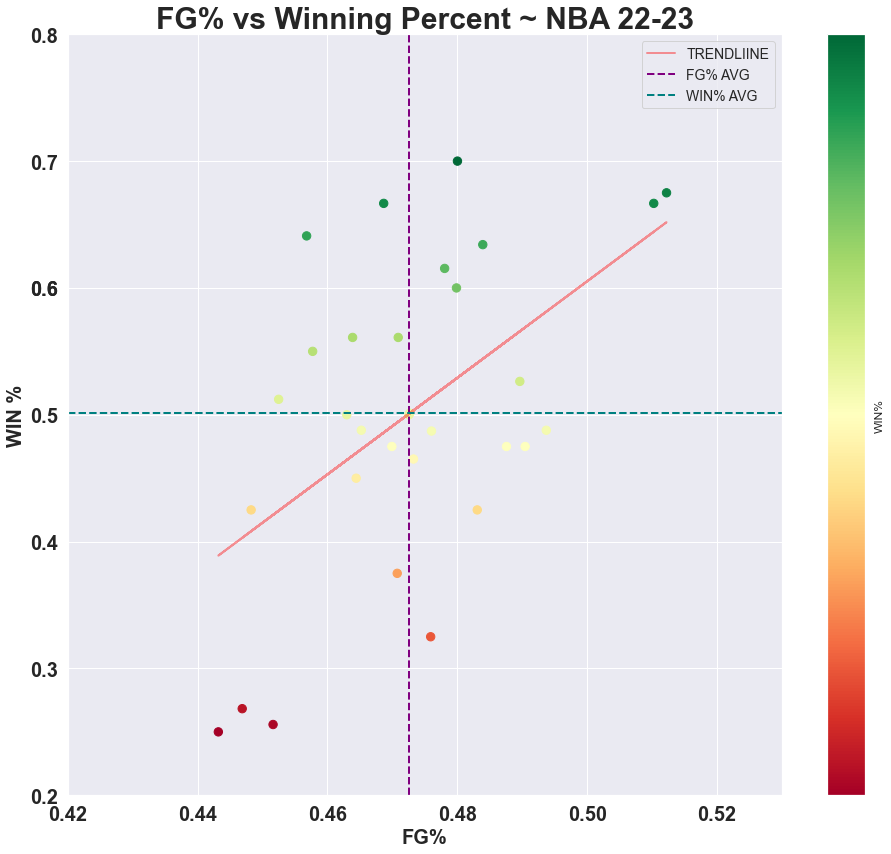


Season Trend Line Equation: y = 3.807590x + (-1.298539)

R-squared: 0.27898335003502095



In [68]:
plt.rcParams["figure.figsize"] = (16,14)

x=df_team_avg.FG_PCT
y=df_team_avg.WIN_PER

# Calc the season trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, c=y, cmap='RdYlGn', s=70)

plt.axvline(df.FG_PCT.mean(), label="FG% AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axhline(df_team_avg.WIN_PER.mean(), label="WIN% AVG", linestyle='dashed', color='teal', linewidth=2)

plt.ylim(0.2,0.8)
plt.yticks([0.2,0.3,0.4,0.5,0.6,0.6,0.7,0.8], fontsize=20, fontweight='bold')
plt.ylabel('WIN %', fontsize=20, fontweight='bold')

plt.xlim(0.42, 0.53)
plt.xticks([i/100 for i in range(42,54,2)], fontsize=20, fontweight='bold')
plt.xlabel('FG%', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('FG% vs Winning Percent ~ NBA 22-23', fontsize=30, fontweight='bold')
plt.colorbar(label='WIN%', ticks=np.linspace(0.2,0.,8))
plt.show()

print()
print(color.BOLD +'Season Trend Line Equation: ' + color.END + "y = %.6fx + (%.6f)"%(z[0],z[1]))

# Calc R-squared
model = LinearRegression()
model.fit(x.values.reshape(-1, 1), y)
r_squared = model.score(x.values.reshape(-1, 1), y)
print()
print(color.BOLD + "R-squared: "+ color.END + str(r_squared))
print()

## NBA Report

In [69]:
def NBA_report():
    pass
    # WIN PIES
    # NBA vs E - NBA vs W - W vs E - E vs E - W vs W
    
    # HOME vs ROAD LEAGUE AVERAGE Pies
    
    # NBA STAT AVERAGES BY MONTH

# Player's Dataframe

In [71]:
url = 'https://stats.nba.com/stats/leaguegamelog'
headers= {'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/96.0.4664.110 Safari/537.36',
          'Referer': 'https://www.nba.com/'}
payload = {
    'Counter': '1000',
    'DateFrom': '',
    'DateTo': '',
    'Direction': 'DESC',
    'LeagueID': '00',
    'PlayerOrTeam': 'P',
    'Season': '2022-23',
    'SeasonType': 'Regular Season',
    'Sorter': 'DATE'}

jsonData = requests.get(url, headers=headers, params=payload).json()


rows = jsonData['resultSets'][0]['rowSet']
columns = jsonData['resultSets'][0]['headers']

df_players = pd.DataFrame(rows, columns=columns)

# ADD PLAYER HEIGHT
# ADD JERSEY NUMBER
# ADD POSITION
# ADD YEARS OF EXPERIENCE
# ADD AGE
# ADD CONTRACT

df_players['DATE_MATCHUP'] = df_players['GAME_DATE'].str[5:] + ' ' + df_players['MATCHUP'].str[4:]

df_players['FG2M'] = df_players.FGM - df_players.FG3M
df_players['FG2A'] = df_players.FGA - df_players.FG3A

df_players['FG2_PTS'] = df_players.FG2M * 2
df_players['FG3_PTS'] = df_players.FG3M * 3

df_players['FRAC_ATT_2PT'] = df_players.FG2A / df_players.FGA
df_players['FRAC_ATT_3PT'] = df_players.FG3A / df_players.FGA

df_players['FRAC_MK_2PT'] = df_players.FG2M / df_players.FGM
df_players['FRAC_MK_3PT'] = df_players.FG3M / df_players.FGM

df_players['FRAC_PTS_2PT'] = df_players.FG2_PTS / df_players.PTS
df_players['FRAC_PTS_3PT'] = df_players.FG3_PTS / df_players.PTS
df_players['FRAC_PTS_FT'] = df_players.FTM / df_players.PTS

df_players = df_players.fillna(0)

df_players.head()

,SEASON_ID,PLAYER_ID,PLAYER_NAME,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,STL,BLK,TOV,PF,PTS,PLUS_MINUS,FANTASY_PTS,VIDEO_AVAILABLE,DATE_MATCHUP,FG2M,FG2A,FG2_PTS,FG3_PTS,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT
0,22022,1628991,Jaren Jackson Jr.,1610612763,MEM,Memphis Grizzlies,0022200600,2023-01-08,MEM vs. UTA,W,29,8,17,0.471,2,5,0.4,1,2,0.5,3,5,8,0,3,5,2,6,19,-5,50.6,1,01-08 vs. UTA,6,12,12,6,0.70588,0.29412,0.75,0.25,0.63158,0.31579,0.052632
1,22022,1627752,Taurean Prince,1610612750,MIN,Minnesota Timberwolves,0022200601,2023-01-08,MIN @ HOU,W,27,6,10,0.6,2,4,0.5,0,0,0,0,0,0,4,0,0,1,4,14,19,19,1,01-08 @ HOU,4,6,8,6,0.6,0.4,0.66667,0.33333,0.57143,0.42857,0
2,22022,1629645,Kevin Porter Jr.,1610612745,HOU,Houston Rockets,0022200601,2023-01-08,HOU vs. MIN,L,38,9,15,0.6,5,9,0.556,2,4,0.5,2,4,6,5,1,1,5,2,25,-12,40.7,1,01-08 vs. MIN,4,6,8,15,0.4,0.6,0.44444,0.55556,0.32,0.6,0.08
3,22022,1629726,Garrison Mathews,1610612745,HOU,Houston Rockets,0022200601,2023-01-08,HOU vs. MIN,L,8,1,5,0.2,1,4,0.25,0,0,0,0,1,1,0,0,0,0,0,3,-13,4.2,1,01-08 vs. MIN,0,1,0,3,0.2,0.8,0,1,0,1,0
4,22022,1630231,Kenyon Martin Jr.,1610612745,HOU,Houston Rockets,0022200601,2023-01-08,HOU vs. MIN,L,22,5,8,0.625,1,3,0.333,1,2,0.5,2,3,5,2,0,0,1,2,12,-6,20,1,01-08 vs. MIN,4,5,8,3,0.625,0.375,0.8,0.2,0.66667,0.25,0.083333


## Function to Return Individual Players Boxscores

In [72]:
def player_boxscores_df(name):
    return df_players[df_players['PLAYER_NAME']==name]

## Player Jersey #, Exp, College, HT, WT, Nationality, College, Draft info Dataframe

In [75]:
'''
df_player_bios = pd.DataFrame()

team_num_dict = {'MIL':'16', 'DET':'8', 'SAS':'26', 'WAS':'30', 'OKC':'33', 'PHI':'22', 'CHI':'4', 'POR':'24', 'IND':'11',
                 'LAL':'13', 'ATL':'1', 'CHA':'3', 'LAC':'12', 'MIN':'17', 'BKN':'38', 'NOP':'19', 'DEN':'7', 'CLE':'5',
                 'PHX':'23', 'MIA':'15', 'TOR':'28', 'NYK':'20', 'UTA':'29', 'DAL':'6', 'BOS':'2', 'HOU':'10', 'ORL':'21',
                 'MEM':'14', 'GSW':'9', 'SAC':'25'}

for i in list(df_players.TEAM_NAME.unique()):
    team_num = team_num_dict[df_players[df_players.TEAM_NAME==i].TEAM_ABBREVIATION.unique().item()]
    
    tables = pd.read_html(f'https://basketball.realgm.com/nba/teams/{i.replace(" ","-")}/{str(team_num)}/Rosters/Regular/2023')
    df_team_player_bios = tables[12]
    df_team_player_bios['Team_abbr'] = i
    df_player_bios = pd.concat([df_player_bios, df_team_player_bios])

df_player_bios.to_csv('df_player_bios.csv', index=False)
'''

## UPDATE FOR 2023-2024 SEASON

df_player_bios = pd.read_csv('df_player_bios.csv')
df_player_bios.head()

,Jersey,Player,Pos,HT,WT,YOS,Pre-Draft Team,Draft Status,Nationality,Free Agent Info,Team_abbr
0,50,Cole Anthony,PG,6-3,195,2,North Carolina,2020 Rnd 1 Pick 15,United States,RFA-2024,Orlando Magic
1,11,Mohamed Bamba,C,7-0,230,4,Texas,2018 Rnd 1 Pick 6,United States,UFA-2024,Orlando Magic
2,5,Paolo Banchero,C,6-10,255,0,Duke,2022 Rnd 1 Pick 1,United States / Italy,TO-2024; TO-2025; RFA-2026,Orlando Magic
3,10,Bol Bol,C,7-2,220,3,Oregon,2019 Rnd 2 Pick 14,United States,UFA-2024,Orlando Magic
4,34,"Wendell Carter, Jr.",PF,6-10,265,4,Duke,2018 Rnd 1 Pick 7,United States,UFA-2026,Orlando Magic


In [76]:
df_player_bios_2 = pd.DataFrame()

for i in df.TEAM_NAME.unique():
    abbr = str(df[df.TEAM_NAME==i].TEAM_ABBREVIATION.unique().item()).lower()
    #print(abbr)
    team = str(i.replace(" ",'-').lower())
    #print(team)
    if abbr == 'nyk': abbr='ny'
    if abbr == 'nop': abbr='no'
    if abbr == 'uta': abbr='utah'
    tables = pd.read_html(f'https://www.espn.com/nba/team/roster/_/name/{abbr}/{team}')
    df_team_player_bios = tables[0]
    df_team_player_bios['Team']=str(i)
    df_team_player_bios['Name'] = df_team_player_bios['Name'].str.replace('\d+', '', regex=True)
    df_player_bios_2 = pd.concat([df_player_bios_2, df_team_player_bios])
    
df_player_bios_2 = df_player_bios_2.drop(columns=['Unnamed: 0'], axis=1)
df_player_bios_2.head()

,Name,POS,Age,HT,WT,College,Salary,Team
0,Davis Bertans,SF,30,"6' 10""",225 lbs,--,"$16,000,000",Dallas Mavericks
1,Reggie Bullock,SF,31,"6' 6""",205 lbs,North Carolina,"$10,012,800",Dallas Mavericks
2,Spencer Dinwiddie,PG,29,"6' 6""",215 lbs,Colorado,"$20,171,427",Dallas Mavericks
3,Luka Doncic,PG,23,"6' 7""",230 lbs,--,"$37,095,000",Dallas Mavericks
4,Dorian Finney-Smith,PF,29,"6' 7""",220 lbs,Florida,"$12,402,000",Dallas Mavericks


## Create player averages dataframe

In [77]:
pivot_player_avg = pd.pivot_table(df_players,
                       index=['PLAYER_NAME', 'TEAM_ABBREVIATION','PLAYER_ID'],
                       aggfunc = 'mean')

df_player_avg = pivot_player_avg.reset_index()

#pivot_player_avg
df_player_avg

,PLAYER_NAME,TEAM_ABBREVIATION,PLAYER_ID,AST,BLK,DREB,FANTASY_PTS,FG2A,FG2M,FG2_PTS,FG3A,FG3M,FG3_PCT,FG3_PTS,FGA,FGM,FG_PCT,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT,FTA,FTM,FT_PCT,MIN,OREB,PF,PLUS_MINUS,PTS,REB,STL,TEAM_ID,TOV,VIDEO_AVAILABLE
0,A.J. Lawson,DAL,1630639,0,0,0,0,0,0,0,0.75,0,0,0,0.75,0,0,0,0.75,0,0,0,0,0,0,0,0,2,0,0,-2.25,0,0,0,1610612742,0,1
1,A.J. Lawson,MIN,1630639,0,0,1,3.2,1,1,2,0,0,0,0,1,1,1,1,0,1,0,1,0,0,0,0,0,2,0,1,-5,2,1,0,1610612750,0,1
2,AJ Green,MIL,1631260,0.47059,0,1,6.8824,0.64706,0.52941,1.0588,2.4118,1,0.26371,3,3.0588,1.5294,0.31059,0.13445,0.57143,0.18529,0.40294,0.15732,0.40291,0.028011,0.23529,0.23529,0.17647,8.8235,0.17647,1.0588,0.23529,4.2941,1.1765,0.23529,1610612749,0.23529,1
3,AJ Griffin,ATL,1631100,1,0.13889,1.5833,16.406,4.0556,2.3333,4.6667,4.3611,1.6111,0.38833,4.8333,8.4167,3.9444,0.47164,0.45861,0.54139,0.52094,0.45128,0.44129,0.49618,0.034747,0.44444,0.38889,0.22222,20.944,0.58333,1.1944,-1,9.8889,2.1667,0.91667,1610612737,0.75,1
4,Aaron Gordon,DEN,203932,2.3824,0.70588,4.3529,32.085,8.5294,5.5,11,2.5,0.94118,0.33968,2.8235,11.029,6.4412,0.58085,0.75788,0.24212,0.84231,0.15769,0.65892,0.16387,0.1772,4.6765,3.0294,0.57668,30.147,2.6176,1.7647,6.8529,16.853,6.9706,0.91176,1610612743,1.5588,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,Zach Collins,SAS,1628380,2.5172,0.82759,3.7586,21.603,4.931,3.069,6.1379,1.5862,0.58621,0.38507,1.7586,6.5172,3.6552,0.593,0.73741,0.26259,0.80394,0.16158,0.61002,0.17953,0.21045,2.2759,1.6207,0.54369,20.828,1.931,3.4138,-4.3793,9.5172,5.6897,0.34483,1610612759,2.0345,1
490,Zach LaVine,CHI,203897,4.25,0.16667,3.7778,35.908,10.111,5.2222,10.444,7.6111,3.0833,0.39,9.25,17.722,8.3056,0.46525,0.57146,0.42854,0.63416,0.36584,0.46116,0.3772,0.16163,4.3333,3.6389,0.76836,35.167,0.55556,2.2778,-1.5278,23.333,4.3333,1,1610612741,2.5,1
491,Zeke Nnaji,DEN,1630192,0.24138,0.2069,0.68966,7.1069,2.1379,1.5517,3.1034,0.65517,0.10345,0.054586,0.31034,2.7931,1.6552,0.41638,0.56242,0.23068,0.55714,0.029064,0.47706,0.035544,0.14257,0.7931,0.62069,0.25576,10.897,0.96552,1.7241,-1.6897,4.0345,1.6552,0.2069,1610612743,0.51724,1
492,Ziaire Williams,MEM,1630533,1.0769,0.15385,2.6923,11.615,2.8462,1.6154,3.2308,2.7692,0.69231,0.291,2.0769,5.6154,2.3077,0.43115,0.50154,0.49846,0.70256,0.29744,0.61678,0.29209,0.091132,0.53846,0.53846,0.30769,16.308,0.38462,2,-2.7692,5.8462,3.0769,0.46154,1610612763,1.3846,1


In [78]:
def team_player_avgs(team_abbr):
    return df_player_avg[df_player_avg['TEAM_ABBREVIATION']==team_abbr].sort_values('PTS',ascending=False).reset_index(drop=True)

team_player_avgs('CLE')

,PLAYER_NAME,TEAM_ABBREVIATION,PLAYER_ID,AST,BLK,DREB,FANTASY_PTS,FG2A,FG2M,FG2_PTS,FG3A,FG3M,FG3_PCT,FG3_PTS,FGA,FGM,FG_PCT,FRAC_ATT_2PT,FRAC_ATT_3PT,FRAC_MK_2PT,FRAC_MK_3PT,FRAC_PTS_2PT,FRAC_PTS_3PT,FRAC_PTS_FT,FTA,FTM,FT_PCT,MIN,OREB,PF,PLUS_MINUS,PTS,REB,STL,TEAM_ID,TOV,VIDEO_AVAILABLE
0,Donovan Mitchell,CLE,1628378,4.8056,0.36111,2.9722,43.103,10.972,6.1389,12.278,9.3333,3.7778,0.39525,11.333,20.306,9.9167,0.48361,0.5249,0.4751,0.60758,0.39242,0.42383,0.39969,0.17649,5.9722,5.2222,0.82761,36.611,0.94444,2.6667,3.6111,28.833,3.9167,1.4444,1610612739,3.0556,1
1,Darius Garland,CLE,1629636,7.8125,0.15625,2.2188,37.5,10.375,5,10,6.125,2.4062,0.37031,7.2188,16.5,7.4062,0.44584,0.63201,0.36799,0.67396,0.32604,0.48526,0.31725,0.19749,4.8438,4.1562,0.79219,35.844,0.4375,2.0312,3.4375,21.375,2.6562,1.2812,1610612739,3.0938,1
2,Evan Mobley,CLE,1630596,2.8205,1.2564,6.4615,33.108,9.4359,5.5641,11.128,1.1026,0.23077,0.12392,0.69231,10.538,5.7949,0.54592,0.89386,0.10614,0.96699,0.033008,0.77351,0.037943,0.18854,3.5385,2.4103,0.62767,34,2.4103,2.7179,1.4872,14.231,8.8718,0.76923,1610612739,2.0769,1
3,Jarrett Allen,CLE,1628386,1.5294,1.2353,7,32.671,8.6176,5.4412,10.882,0.17647,0,0,0,8.7941,5.4412,0.59671,0.96881,0.031187,0.97059,0,0.78223,0,0.21777,3.8529,2.7059,0.61626,33.735,3.1176,2.1471,4.1176,13.588,10.118,0.79412,1610612739,1.4412,1
4,Caris LeVert,CLE,1627747,3.7297,0.16216,3.4054,24.584,6.6486,2.9459,5.8919,4.3514,1.5946,0.34262,4.7838,11,4.5405,0.38905,0.5888,0.4112,0.61336,0.33258,0.4737,0.31987,0.1794,2.6486,1.973,0.532,31.027,0.72973,2.3514,3.3514,12.649,4.1351,0.83784,1610612739,1.6216,1
5,Cedi Osman,CLE,1626224,1.5897,0.10256,2.2564,16.308,3.4872,2.1538,4.3077,4.2821,1.4872,0.30882,4.4615,7.7692,3.641,0.46669,0.44541,0.52895,0.53987,0.38321,0.43668,0.40162,0.08478,1.6667,1.0769,0.37395,23.436,0.30769,1.8974,4.9487,9.8462,2.5641,0.51282,1610612739,0.84615,1
6,Kevin Love,CLE,201567,2.0303,0.21212,6.2121,21.027,2.1212,1.0909,2.1818,5.1212,1.8788,0.32421,5.6364,7.2424,2.9697,0.39358,0.30728,0.69272,0.40683,0.53256,0.28002,0.49884,0.16054,1.7273,1.5152,0.50555,20.939,0.9697,1.7879,3.5758,9.3333,7.1818,0.21212,1610612739,1.2424,1
7,Dean Wade,CLE,1629731,1,0.35294,3.4706,15.488,1.6471,0.88235,1.7647,3.2941,1.3529,0.35418,4.0588,4.9412,2.2353,0.45876,0.30358,0.69642,0.35784,0.52451,0.30383,0.50884,0.069678,0.76471,0.52941,0.19412,23.941,0.58824,2.4706,4.8824,6.3529,4.0588,0.70588,1610612739,0.41176,1
8,Lamar Stevens,CLE,1630205,0.68,0.44,3.04,13.412,3.8,1.84,3.68,1.92,0.56,0.22268,1.68,5.72,2.4,0.38568,0.64621,0.27379,0.66033,0.17967,0.55992,0.19486,0.085222,1.12,0.76,0.25332,21.52,0.72,1.2,0,6.12,3.76,0.36,1610612739,0.64,1
9,Isaac Okoro,CLE,1630171,0.82927,0.39024,1.8049,11.771,2.2927,1.2927,2.5854,1.9268,0.56098,0.2069,1.6829,4.2195,1.8537,0.40546,0.52427,0.42695,0.5752,0.22967,0.46947,0.23495,0.14924,1.2439,0.95122,0.30324,18.976,0.58537,1.9268,-0.41463,5.2195,2.3902,0.60976,1610612739,0.56098,1


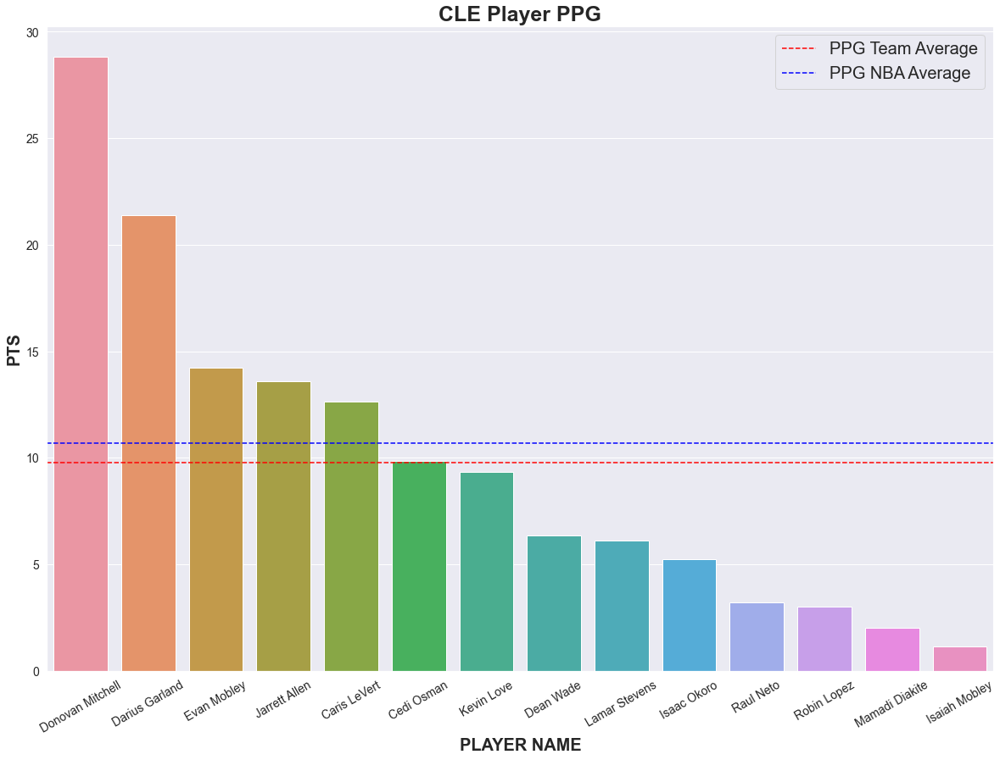

In [80]:
def team_players_ppg_bar(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df_team = team_player_avgs(team_abbr).sort_values('PTS',ascending=False).reset_index(drop=True)
    ax = sns.barplot(data=df_team, x='PLAYER_NAME', y='PTS')
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('PTS', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player PPG', fontsize=25, fontweight='bold')
    plt.axhline(y=df_team.PTS.mean(), color='red', linestyle='--', label='PPG Team Average')
    plt.axhline(y=df_players.PTS.mean(), color='blue', linestyle='--', label='PPG NBA Average') 
    plt.legend(loc='best', fontsize=20)
    plt.show()
    
team_players_ppg_bar('CLE')

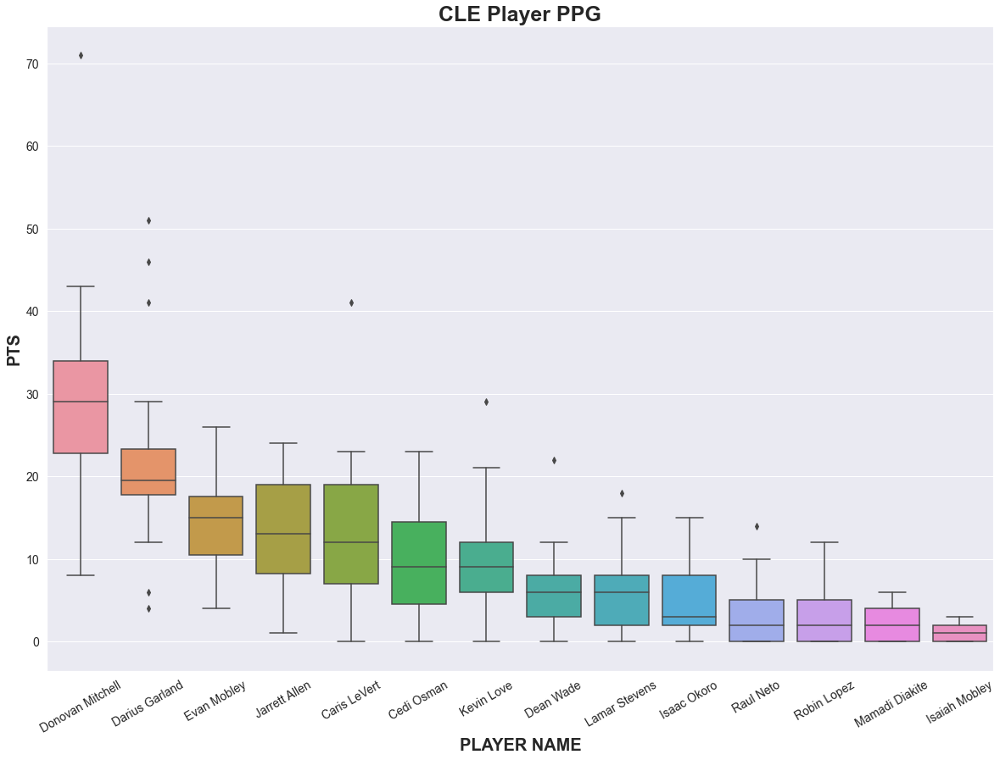

In [81]:
def team_players_ppg_whisker(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df = df_players[df_players.TEAM_ABBREVIATION == team_abbr]
    means_ppg = df.groupby(['PLAYER_NAME'])['PTS'].mean().sort_values(ascending=[False])
    ax = sns.boxplot(data=df, x='PLAYER_NAME', y='PTS', order=means_ppg.index)
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('PTS', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player PPG', fontsize=25, fontweight='bold')
    plt.show()
    
team_players_ppg_whisker('CLE')

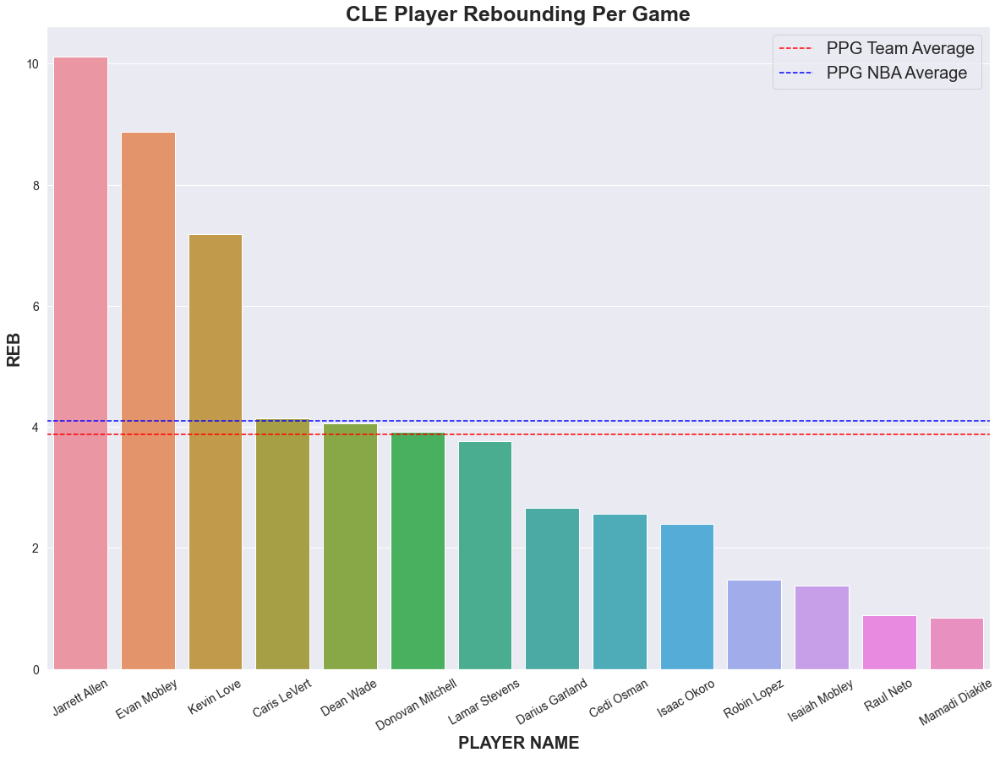

In [82]:
def team_players_reb_bar(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df_team = team_player_avgs(team_abbr).sort_values('REB',ascending=False).reset_index(drop=True)
    ax = sns.barplot(data=df_team, x='PLAYER_NAME', y='REB')
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('REB', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player Rebounding Per Game', fontsize=25, fontweight='bold')
    plt.axhline(y=df_team.REB.mean(), color='red', linestyle='--', label='PPG Team Average')
    plt.axhline(y=df_players.REB.mean(), color='blue', linestyle='--', label='PPG NBA Average') 
    plt.legend(loc='best', fontsize=20)
    plt.show()
    
team_players_reb_bar('CLE')

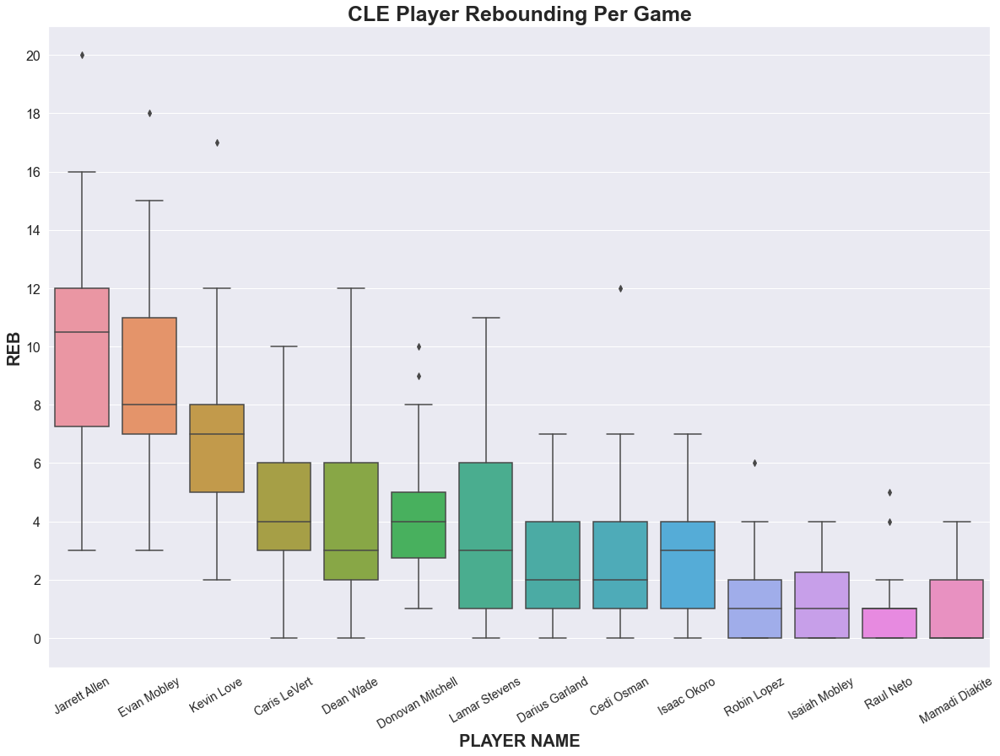

In [83]:
def team_players_reb_whisker(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df = df_players[df_players.TEAM_ABBREVIATION == team_abbr].sort_values('REB',ascending=False).reset_index(drop=True)
    means_reb = df.groupby(['PLAYER_NAME'])['REB'].mean().sort_values(ascending=[False])
    ax = sns.boxplot(data=df, x='PLAYER_NAME', y='REB', order=means_reb.index)
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('REB', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player Rebounding Per Game', fontsize=25, fontweight='bold')
    plt.yticks(list(range(0,df.REB.max()+2,2)),size=16)
    plt.show()
    
team_players_reb_whisker('CLE')

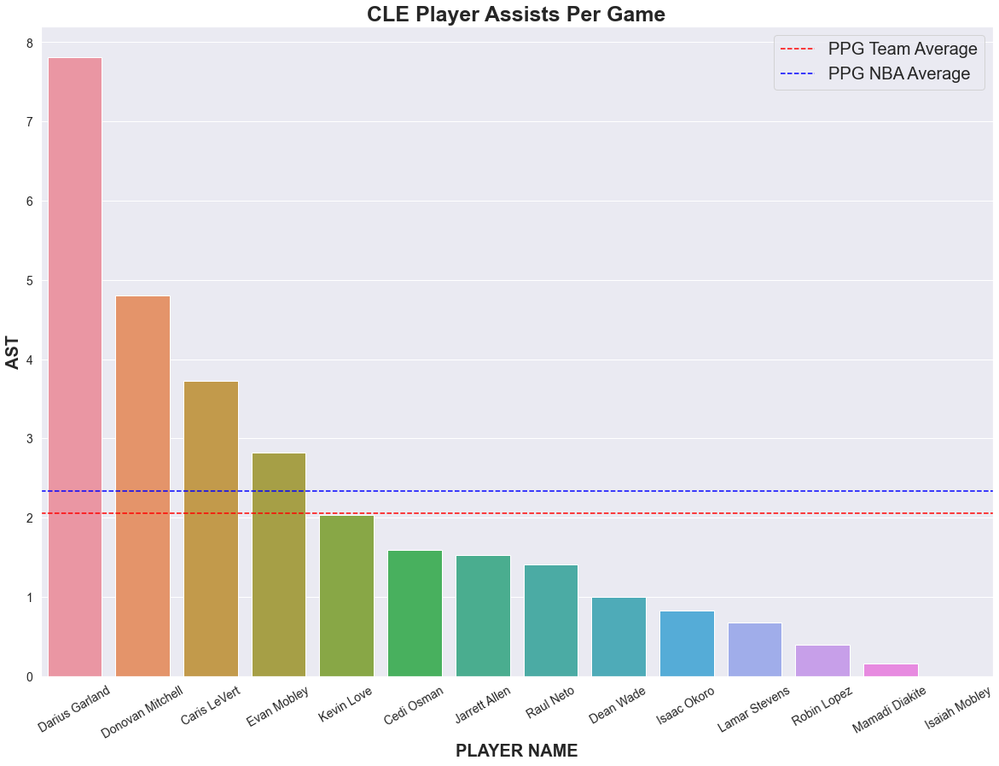

In [84]:
def team_players_ast_bar(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df_team = team_player_avgs(team_abbr).sort_values('AST',ascending=False).reset_index(drop=True)
    ax = sns.barplot(data=df_team, x='PLAYER_NAME', y='AST')
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('AST', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player Assists Per Game', fontsize=25, fontweight='bold')
    plt.axhline(y=df_team.AST.mean(), color='red', linestyle='--', label='PPG Team Average')
    plt.axhline(y=df_players.AST.mean(), color='blue', linestyle='--', label='PPG NBA Average') 
    plt.legend(loc='best', fontsize=20)
    plt.show()
    
team_players_ast_bar('CLE')

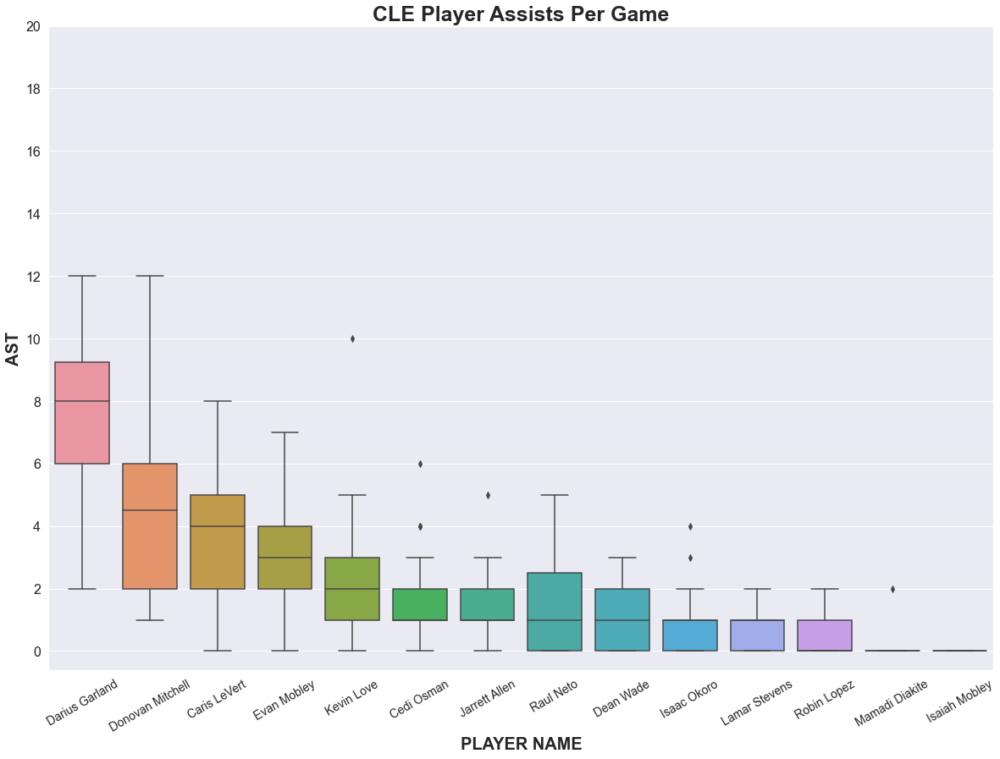

In [107]:
def team_players_ast_whisker(team_abbr):
    plt.rcParams["figure.figsize"] = (20,14)
    df = df_players[df_players.TEAM_ABBREVIATION == team_abbr].sort_values('AST',ascending=False).reset_index(drop=True)
    means_ast = df.groupby(['PLAYER_NAME'])['AST'].mean().sort_values(ascending=[False])
    ax = sns.boxplot(data=df, x='PLAYER_NAME', y='AST', order=means_ast.index)
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30, fontsize=14)
    plt.yticks(fontsize=14)
    ax.set_xlabel('PLAYER NAME', fontsize=20, fontweight='bold')
    ax.set_ylabel('AST', fontsize=20, fontweight='bold')
    ax.set_title(f'{team_abbr} Player Assists Per Game', fontsize=25, fontweight='bold')
    plt.yticks(list(range(0,df.REB.max()+2,2)),size=16)
    plt.show()
    
team_players_ast_whisker('CLE')

## Individual Player Visualizations

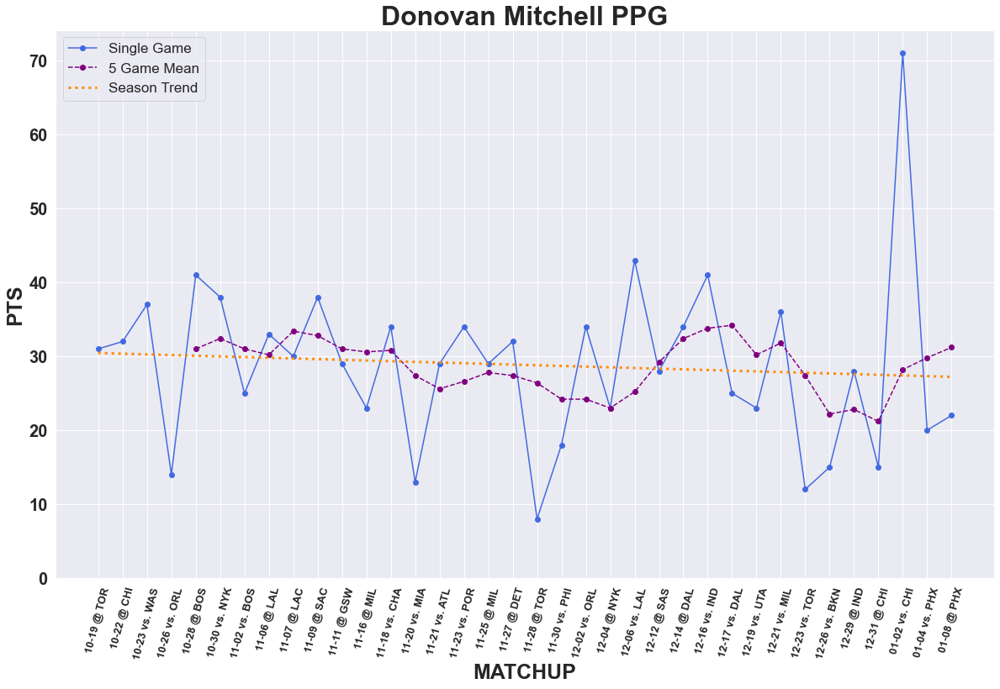

In [108]:
def player_points_plot(name):
    plt.rcParams["figure.figsize"] = (20,12)
    df = player_boxscores_df(name).sort_values(by='GAME_DATE').reset_index(drop=True)
    
    player_ppg = plt.plot(df.index, df['PTS'], marker='o', color='royalblue', label='Single Game')
    if df.GAME_DATE.count()>5:
        rolling_mean_5 = df.PTS.rolling(5).mean()
        rolling_mean_5_plot = plt.plot(rolling_mean_5, color="Purple",linestyle='dashed', alpha=1,marker='o', label="5 Game Mean")
    
    if df.GAME_DATE.count()>1:
        z = np.polyfit(df.index, df['PTS'], 1)
        p = np.poly1d(z)
        season_trend = plt.plot(df.index,p(df.index), linestyle='dotted',linewidth=3, color='darkorange', label='Season Trend')
    
    
    plt.legend(loc='best', fontsize=17)
    plt.xticks(df.index,df["DATE_MATCHUP"].values)
    plt.xticks(rotation=75, size=13, fontweight='bold')
    if df.PTS.max() > 20:
        plt.yticks(list(range(0,df.PTS.max(),10)),size=16, fontweight='bold')
    elif df.PTS.max() <=20:
        plt.yticks(list(range(0,df.PTS.max(),5)),size=16, fontweight='bold')
    elif df.PTS.max() <=5:
        plt.yticks(list(range(0,df.PTS.max()+1,1)),size=16, fontweight='bold')
    plt.ylim(0, None)
    plt.yticks(fontsize=20)
    plt.title(f'{name} PPG', fontsize=32, fontweight='bold')
    plt.xlabel('MATCHUP', fontsize=25, fontweight='bold')
    plt.ylabel('PTS', fontsize=25, fontweight='bold')
    plt.show()
player_points_plot('Donovan Mitchell')

## Function to return individual players box score dataframe

## Function to violin plot a players PTS, REB, AST

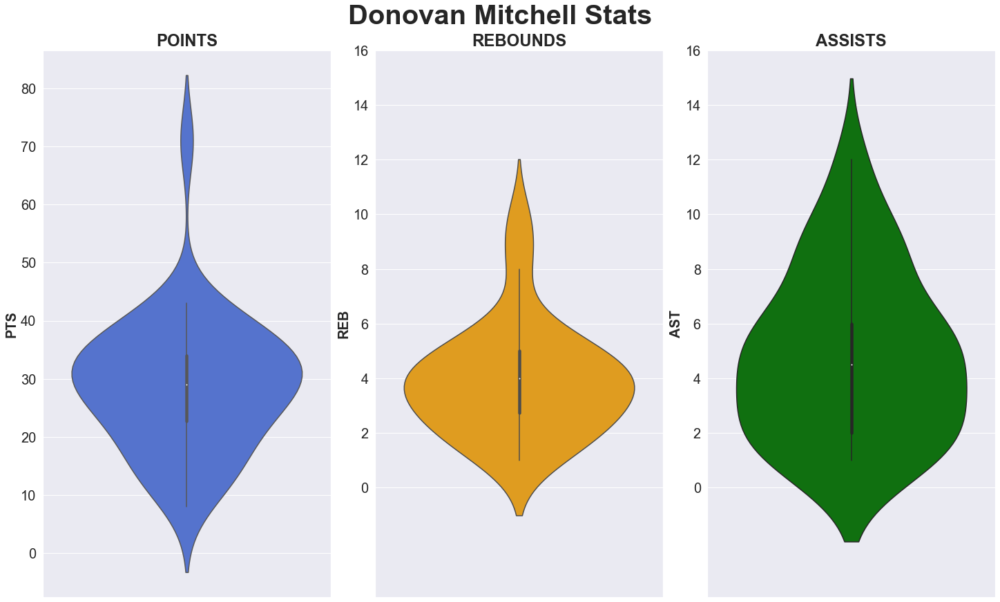

In [109]:
def player_pra_violins(name):
    df = player_boxscores_df(name)
    fig, axs = plt.subplots(nrows=1, ncols=3, sharex='col', constrained_layout=True, sharey=False)
    
    ax1 = sns.violinplot(data=df, x=df.PLAYER_NAME, y='PTS', ax=axs[0], color='royalblue')
    ax1.set_xlabel('')
    ax1.set_ylabel('PTS',fontsize=20, fontweight='bold')
    ax1.tick_params(bottom=False, labelbottom=False)
    ax1.set_title('POINTS', fontsize=24, fontweight='bold')
    ax1.set_ylim(None, None)
    ax1.tick_params(axis='y', which='major', labelsize=20)
    if df.PTS.max() < 10:
        ax1.set_yticks(list(range(0,df.PTS.max()+5,2)))
    elif df.PTS.max() < 20:
        ax1.set_yticks(list(range(0,df.PTS.max()+10,5)))
    else:
        ax1.set_yticks(list(range(0,df.PTS.max()+10,10)))
    
    ax2 = sns.violinplot(data=df, x=df.PLAYER_NAME, y='REB', ax=axs[1], color='orange')
    ax2.set_xlabel('')
    ax2.set_ylabel('REB',fontsize=20, fontweight='bold')
    ax2.tick_params(bottom=False, labelbottom=False)
    ax2.set_title('REBOUNDS', fontsize=24, fontweight='bold')
    ax2.set_ylim(-4, None)
    ax2.tick_params(axis='y', which='major', labelsize=20)
    
    ax3 = sns.violinplot(data=df, x=df.PLAYER_NAME, y='AST', ax=axs[2], color='green')
    ax3.set_xlabel('')
    ax3.set_ylabel('AST',fontsize=20, fontweight='bold')
    ax3.tick_params(bottom=False, labelbottom=False)
    ax3.set_title('ASSISTS', fontsize=24, fontweight='bold')
    ax3.set_ylim(-4, None)
    ax3.tick_params(axis='y', which='major', labelsize=20)
    
    if df.AST.max()>df.REB.max():
        ax2.set_yticks(list(range(0,df.AST.max()+6,2)))
        ax3.set_yticks(list(range(0,df.AST.max()+6,2)))
    elif df.AST.max()<df.REB.max():
        ax2.set_yticks(list(range(0,df.REB.max()+6,2)))
        ax3.set_yticks(list(range(0,df.REB.max()+6,2)))
    
    fig.suptitle(f'{name} Stats', fontsize=40, fontweight='bold')
    plt.show()
    
player_pra_violins('Donovan Mitchell')

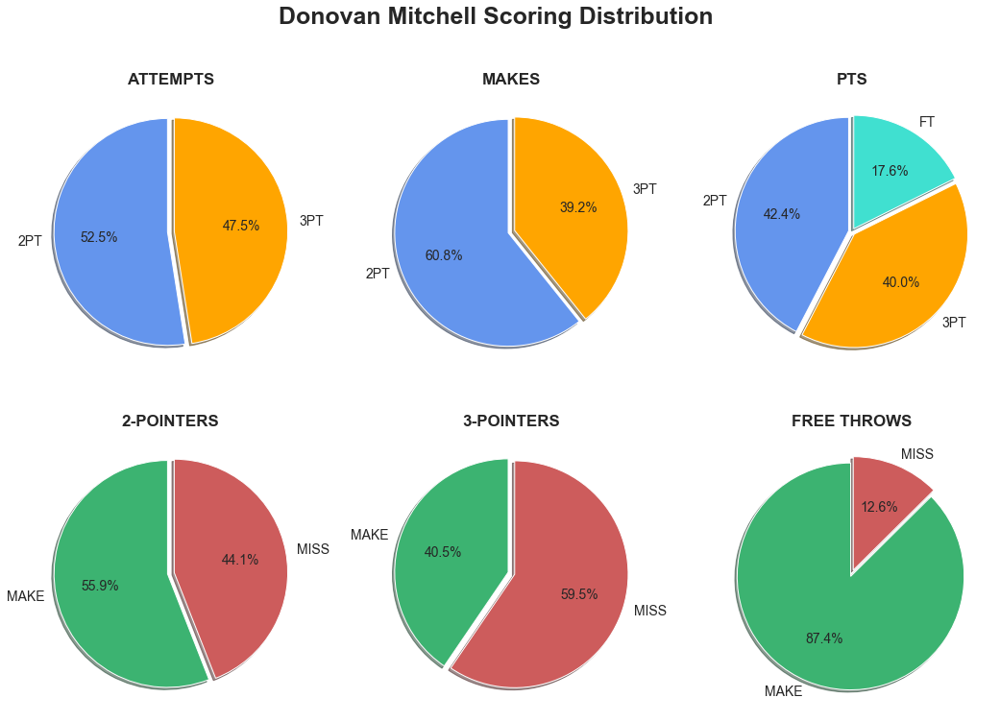

In [110]:
def player_shooter_pies(name):
    try:
        df_player_ind = df_players[df_players.PLAYER_NAME==name]

        data_att = [df_player_ind.FRAC_ATT_2PT.sum(), df_player_ind.FRAC_ATT_3PT.sum()]
        data_mk = [df_player_ind.FRAC_MK_2PT.sum(), df_player_ind.FRAC_MK_3PT.sum()]
        data_pts = [df_player_ind.FRAC_PTS_2PT.sum(), df_player_ind.FRAC_PTS_3PT.sum(), df_player_ind.FRAC_PTS_FT.sum()]

        data_2pt = [df_player_ind.FG2M.sum(), (df_player_ind.FG2A.sum() - df_player_ind.FG2M.sum())]
        data_3pt = [df_player_ind.FG3M.sum(), (df_player_ind.FG3A.sum() - df_player_ind.FG3M.sum())]
        data_ft = [df_player_ind.FTM.sum(), (df_player_ind.FTA.sum() - df_player_ind.FTM.sum())]

        labels1 = ['2PT', '3PT']
        labels2 = ['2PT', '3PT', 'FT']
        labels3 = ['MAKE', 'MISS']
        explode1 = [0.03, 0.03]
        explode2 = [0.03,0.03,0.03]
        colors0 = ['cornflowerblue', 'orange']
        colors1= ['cornflowerblue', 'orange', 'turquoise']
        colors2 = ['mediumseagreen','indianred']

        fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(18, 12))
        ax[0,0].pie(data_att,
                  labels=labels1,
                  explode=explode1,
                  shadow=True,
                  colors=colors0,
                  autopct='%1.1f%%',
                  textprops={'fontsize': 14},
                  startangle=90)
        ax[0,0].set_title('ATTEMPTS', fontsize=17, fontweight='bold')

        ax[0,1].pie(data_mk,
                  labels=labels1,
                  explode=explode1,
                  shadow=True,
                  colors=colors0,
                  autopct='%1.1f%%',
                  textprops={'fontsize': 14},
                  startangle=90)
        ax[0,1].set_title('MAKES', fontsize=17, fontweight='bold')

        ax[0,2].pie(data_pts,
                  labels=labels2,
                  explode=explode2,
                  shadow=True,
                  colors=colors1,
                  autopct='%1.1f%%',
                  textprops={'fontsize': 14},
                  startangle=90)
        ax[0,2].set_title('PTS', fontsize=17, fontweight='bold')
        
        if data_2pt[0]!=0:
            ax[1,0].pie(data_2pt,
                      labels=labels3,
                      explode=explode1,
                      colors=colors2,
                      shadow=True,
                      autopct='%1.1f%%',
                      textprops={'fontsize': 14},
                      startangle=90)
            ax[1,0].set_title('2-POINTERS', fontsize=17, fontweight='bold')
        
        if data_3pt[0]!=0:
            ax[1,1].pie(data_3pt,
                      labels=labels3,
                      explode=explode1,
                      colors=colors2,
                      shadow=True,
                      autopct='%1.1f%%',
                      textprops={'fontsize': 14},
                      startangle=90)
            ax[1,1].set_title('3-POINTERS', fontsize=17, fontweight='bold')

        if data_ft[0]!=0:
            ax[1,2].pie(data_ft,
                      labels=labels3,
                      explode=explode1,
                      colors=colors2,
                      shadow=True,
                      autopct='%1.1f%%',
                      textprops={'fontsize': 14},
                      startangle=90)
            ax[1,2].set_title('FREE THROWS', fontsize=17, fontweight='bold')

        fig.suptitle(f'{name} Scoring Distribution', fontsize=25, fontweight="bold")
        plt.show()
    except: pass
        
player_shooter_pies('Donovan Mitchell')

In [111]:
def get_team_logo(team_name):
    team_name_formatted = team_name.lower()
    team_name_formatted = team_name_formatted.replace(' ','-')
    logo_url = urllib.request.urlretrieve(f'https://cdn.freebiesupply.com/images/large/2x/{team_name_formatted}-logo-transparent.png')
    logo_pic = plt.imread(logo_url[0])
    plt.imshow(logo_pic)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.savefig(f'C:\\Users\\Peter\\NBA_Logos\\{team_name_formatted}.png', pad_inches=0, bbox_inches = 'tight')
    plt.clf()
    
    if team_name == 'Phoenix Suns':
        team_name_formatted = team_name.lower()
        team_name_formatted = team_name_formatted.replace(' ','-')
        logo_url = urllib.request.urlretrieve('https://images.vexels.com/media/users/3/131727/isolated/preview/603218e104d110c73cf33fa5814389ac-phoenix-suns-logo-by-vexels.png')
        logo_pic = plt.imread(logo_url[0])
        plt.imshow(logo_pic)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.savefig(f'C:\\Users\\Peter\\NBA_Logos\\{team_name_formatted}.png', pad_inches=0, bbox_inches = 'tight')
        plt.clf()
        

lebron_team_id = df_players[df_players.PLAYER_NAME=='LeBron James'].TEAM_ID.unique().item()
lebron_team_name = str(df_players[df_players.PLAYER_NAME=='LeBron James'].TEAM_NAME.unique().item())
lebron_id = df_players[df_players.PLAYER_NAME=='LeBron James'].PLAYER_ID.unique().item()

#for i in df.TEAM_NAME.unique():
#    print(i)
#    try: get_team_logo(i)
#    except: print('Couldnt Find')


In [112]:
def career_summary(name):
    player_id = int(df_players[df_players.PLAYER_NAME == name].PLAYER_ID.unique().item(0))
    formatted_name = str(name).replace(' ','-').lower()
    html = requests.get(f'https://www.nba.com/player/{str(player_id)}/{formatted_name}/bio').content
    soup = BeautifulSoup(html, 'html.parser')
    divs = str(soup.find_all("div", {"class": "cplayer-bio__content"})[0].text).replace('\r\n', ' ')
    #div1 = str(div1).split('<h3>')[0]
    print(color.BOLD + 'Professional Summary' + color.END)
    try:
        divs = divs.split("PROFESSIONAL CAREER: ")[1]
        try:
            divs = divs.split("2019-20 SEASON:")[0]
        except: pass
    except: pass
    print(divs)

career_summary('Andre Iguodala')

Professional Summary
Has appeared in 1129 games (779 starts) during his 16-year NBA career and has averaged 12.0 points, 5.1 rebounds, 4.3 assists, 1.49 steals and 33.2 minutes while shooting 46.5 percent from the floor, 33.3 percent from three-point range and 70.9 percent from the foul line…has missed 88 games due to injury/illness, 18 for rest-related purposes, 51 on the inactive list while awaiting a trade and another resulting from a pending trade…missed one game as a DNP-CD…has been crowned NBA Finals MVP once…is a one-time NBA All-Star…two-time participant in the NBA Rookie Challenge, taking home MVP honors once…has been named to the NBA All-Defensive First Team and NBA All-Defensive Second Team once each…was an NBA All-Rookie First Team selection…has scored in double figures on 655 occasions with 197 games of at least 20 points and 15 games with at least 30 points…his longest streak of consecutive double-figure scoring games is 63 (Dec. 1, 2007-Apr. 9, 2008)…has grabbed double-f

## NBA Allstars

In [113]:
tables = pd.read_html("https://en.wikipedia.org/wiki/List_of_NBA_All-Stars")
df_all_stars = tables[1]
df_all_stars.Player = df_all_stars.Player.map(lambda x: x.strip('§*^'))
df_all_stars = df_all_stars.drop(columns=['Reference','Notes'], axis=1)
df_all_stars = df_all_stars.rename(columns={'Selections[c]':'Selections'})
df_all_stars = df_all_stars.rename(columns={'#':'Apps'})
df_all_stars.Selections = df_all_stars.Selections.str.replace('–','-')
df_all_stars.Player = df_all_stars.Player.str.replace('–','-')
df_all_stars['Years'] = ''
df_all_stars.loc[df_all_stars['Player'] == 'Nikola Jokić', 'Player'] = 'Nikola Jokic'
df_all_stars.loc[df_all_stars['Player'] == 'Luka Dončić', 'Player'] = 'Luka Doncic'
df_all_stars

,Player,Apps,Selections,Years
0,Kareem Abdul-Jabbar*[a],19,1970-1977; 1979-1989,
1,Kobe Bryant,18,1998; 2000-2016,
2,LeBron James,18,2005-2022,
3,Tim Duncan,15,1998; 2000-2011; 2013; 2015,
4,Kevin Garnett,15,1997-1998; 2000-2011; 2013,
...,...,...,...,...
439,Mo Williams,1,2009,
440,Zion Williamson,1,2021,
441,Kevin Willis,1,1992,
442,Metta World Peace[d],1,2004,


In [114]:
def convert_selections(a):
    data_yrs = []
    a = str(a)
    a = a.replace(" ","")
    if ';' in a:
        ranges = a.split(';')
        for i in ranges:
            if '-' in i:
                i_min = int(i.split('-')[0])
                i_max = int(i.split('-')[1])
                for j in range(i_min,i_max+1):
                    data_yrs.append(int(j))
            else:
                data_yrs.append(int(i))
    elif '-' in a:
        a_min = int(a.split('-')[0])
        a_max = int(a.split('-')[1])
        for k in range(a_min,a_max+1):
            data_yrs.append(int(k))
    else:
        a_int = int(a)
        data_yrs.append(a_int)
    return data_yrs


In [115]:
df_all_stars.Years = df_all_stars.Selections
df_all_stars.Years = df_all_stars.Years.map(lambda x: convert_selections(x))
df_all_stars_yearly = df_all_stars.copy()
df_all_stars_yearly = df_all_stars_yearly.drop(columns=['Selections'], axis=1)
df_all_stars_yearly

,Player,Apps,Years
0,Kareem Abdul-Jabbar*[a],19,"[1970, 1971, 1972, 1973, 1974, 1975, 1976, 197..."
1,Kobe Bryant,18,"[1998, 2000, 2001, 2002, 2003, 2004, 2005, 200..."
2,LeBron James,18,"[2005, 2006, 2007, 2008, 2009, 2010, 2011, 201..."
3,Tim Duncan,15,"[1998, 2000, 2001, 2002, 2003, 2004, 2005, 200..."
4,Kevin Garnett,15,"[1997, 1998, 2000, 2001, 2002, 2003, 2004, 200..."
...,...,...,...
439,Mo Williams,1,[2009]
440,Zion Williamson,1,[2021]
441,Kevin Willis,1,[1992]
442,Metta World Peace[d],1,[2004]


## NBA Finals Players Dataset

In [116]:
pd.set_option('display.float_format', '{:.10g}'.format)

tables = pd.read_html("https://basketball.fandom.com/wiki/List_of_NBA_champions")
df_finals_teams = tables[0]

df_finals_teams = df_finals_teams.drop(df_finals_teams.columns[[i for i in range(9,27)]], axis=1)
df_finals_teams = df_finals_teams.drop(df_finals_teams.columns[[1,3,6,8]], axis=1)

header_row = df_finals_teams.iloc[3]
df_finals_teams = pd.DataFrame(df_finals_teams.values[4:], columns=header_row).reset_index(drop=True)

df_finals_teams['Champ_abbr'] = df_finals_teams.Champions
df_finals_teams['Champ_abbr'] = df_finals_teams['Champ_abbr'].map(team_name_abbr_dict)

df_finals_teams['Champ_ID'] = df_finals_teams.Champions
df_finals_teams['Champ_ID'] = df_finals_teams['Champ_ID'].map(team_id_dict)


df_finals_teams_post2000 = df_finals_teams[::-1].head(23).reset_index(drop=True)
df_finals_teams_post2000

3,Season,Champions,Series,Losing Team,Most Valuable Player,Champ_abbr,Champ_ID
0,2022,Golden State Warriors,4–2,Boston Celtics,Stephen Curry,GSW,1610612744
1,2021,Milwaukee Bucks,4–2,Phoenix Suns,Giannis Antetokounmpo,MIL,1610612749
2,2020,Los Angeles Lakers,4–2,Miami Heat,LeBron James,LAL,1610612747
3,2019,Toronto Raptors,4–2,Golden State Warriors,Kawhi Leonard,TOR,1610612761
4,2018,Golden State Warriors,4–0,Cleveland Cavaliers,Kevin Durant,GSW,1610612744
5,2017,Golden State Warriors,4–1,Cleveland Cavaliers,Kevin Durant,GSW,1610612744
6,2016,Cleveland Cavaliers,4–3,Golden State Warriors,LeBron James,CLE,1610612739
7,2015,Golden State Warriors,4–2,Cleveland Cavaliers,Andre Iguodala,GSW,1610612744
8,2014,San Antonio Spurs,4–1,Miami Heat,Kawhi Leonard,SAS,1610612759
9,2013,Miami Heat,4–3,San Antonio Spurs,LeBron James,MIA,1610612748


In [117]:
'''
df_finals_champs_roster_post2000 = pd.DataFrame()

team_num_dict = {'BOS':'2', 'GSW':'9', 'CLE':'5', 'MIL':'16', 'LAL':'13', 'TOR':'28', 'SAS':'26', 'MIA':'15', 'DAL':'6', 'DET':'8'}

for i in df_finals_teams_post2000.Season:
    df_champs_roster = pd.DataFrame()
    champs = df_finals_teams_post2000[df_finals_teams_post2000.Season ==i].Champions.item()
    champs_formatted = champs.replace(" ","-")
    champs_abbr = str(df_finals_teams_post2000[df_finals_teams_post2000.Season ==i].Champ_abbr.item())
    season = str(i)
    team_num = team_num_dict[champs_abbr]
    
    tables = pd.read_html(f'https://basketball.realgm.com/nba/teams/{champs_formatted}/{team_num}/Rosters/Playoff/{season}')
    df_champs_roster = tables[12]
    
    df_champs_roster['Champs'] = champs
    df_champs_roster['Champs_abbr'] = champs_abbr
    df_champs_roster['Season'] = season
    df_finals_champs_roster_post2000 = pd.concat([df_finals_champs_roster_post2000, df_champs_roster])
    
df_finals_champs_roster_post2000 = df_finals_champs_roster_post2000.reset_index(drop=True)

df_finals_champs_roster_post2000 = df_finals_champs_roster_post2000.copy()
df_finals_champs_roster_post2000.to_csv('df_finals_champs_roster_post2000.csv', index=False)
'''

# UPDATE AFTER 2023 FINALS !!!

df_finals_champs_roster_post2000 = pd.read_csv('df_finals_champs_roster_post2000.csv')
df_finals_champs_roster_post2000

,Player,Pos,HT,WT,Birth Date,Age,Pre-Draft Team,YOS,Draft Status,Champs,Champs_abbr,Season
0,Juan Toscano-Anderson,SF,6-6,213,"Apr 10, 1993",29,Marquette,2,"2015 NBA Draft, Undrafted",Golden State Warriors,GSW,2022
1,Nemanja Bjelica,PF,6-10,235,"May 9, 1988",33,KK Crvena Zvezda (Serbia),6,"2010 2nd Rnd, #35, Washington Wizards",Golden State Warriors,GSW,2022
2,Stephen Curry,PG,6-3,198,"Mar 14, 1988",34,Davidson,12,"2009 1st Rnd, #7, Golden State Warriors",Golden State Warriors,GSW,2022
3,Draymond Green,PF,6-6,234,"Mar 4, 1990",32,Michigan State,9,"2012 2nd Rnd, #35, Golden State Warriors",Golden State Warriors,GSW,2022
4,Andre Iguodala,SF/SG,6-6,215,"Jan 28, 1984",38,Arizona,17,"2004 1st Rnd, #9, Philadelphia Sixers",Golden State Warriors,GSW,2022
...,...,...,...,...,...,...,...,...,...,...,...,...
335,Tyronn Lue,PG,6-0,170,"May 3, 1977",22,Nebraska,1,"1998 1st Rnd, #23, Denver Nuggets",Los Angeles Lakers,LAL,2000
336,Shaquille O'Neal,C,7-1,325,"Mar 6, 1972",28,LSU,7,"1992 1st Rnd, #1, Orlando Magic",Los Angeles Lakers,LAL,2000
337,Glen Rice,PF,6-8,228,"May 28, 1967",32,Michigan,10,"1989 1st Rnd, #4, Miami Heat",Los Angeles Lakers,LAL,2000
338,John Salley,C,6-11,230,"May 16, 1964",35,Georgia Tech,10,"1986 1st Rnd, #11, Detroit Pistons",Los Angeles Lakers,LAL,2000


## Player Scatter Plots for All Player Performances

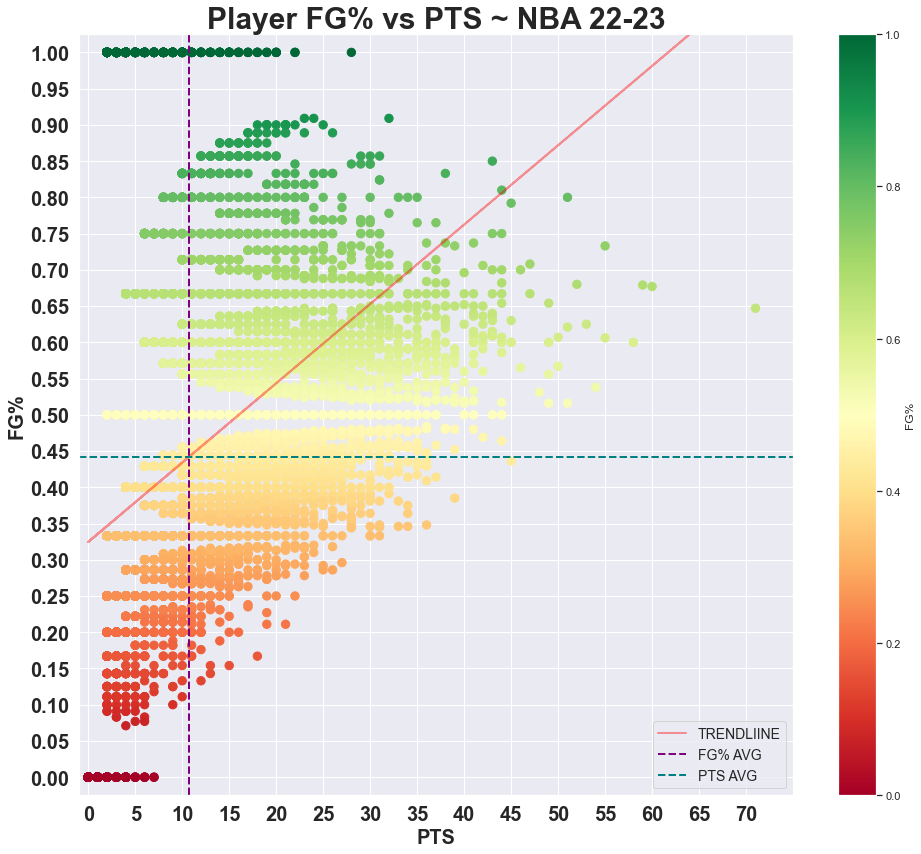


Season Trend Line Equation: y = 0.010946x + (0.324531)

R-squared: 0.14719012094023598



In [118]:
plt.rcParams["figure.figsize"] = (16,14)

x=df_players.PTS
y=df_players.FG_PCT


# Calc the season trendline
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x,p(x), label='TRENDLIINE', linestyle = 'solid', alpha=0.4, color='red', linewidth=2)

plt.scatter(x,y, c=y, cmap='RdYlGn', s=70)

plt.axvline(x.mean(), label="FG% AVG", linestyle='dashed', color='purple', linewidth=2)
plt.axhline(y.mean(), label="PTS AVG", linestyle='dashed', color='teal', linewidth=2)

plt.ylim(-0.025,1.025)
plt.yticks([i/100 for i in range(0,105,5)], fontsize=20, fontweight='bold')
plt.ylabel('FG%', fontsize=20, fontweight='bold')

plt.xlim(-1, 75)
plt.xticks([i for i in range(0,75,5)], fontsize=20, fontweight='bold')
plt.xlabel('PTS', fontsize=20, fontweight='bold')

plt.legend(loc='best', fontsize=14)

plt.title('Player FG% vs PTS ~ NBA 22-23', fontsize=30, fontweight='bold')
plt.colorbar(label='FG%')
plt.show()

print()
print(color.BOLD +'Season Trend Line Equation: ' + color.END + "y = %.6fx + (%.6f)"%(z[0],z[1]))

# Calc R-squared
model = LinearRegression()
model.fit(x.values.reshape(-1, 1), y)
r_squared = model.score(x.values.reshape(-1, 1), y)
print()
print(color.BOLD + "R-squared: "+ color.END + str(r_squared))
print()

## Function to Display Player Image

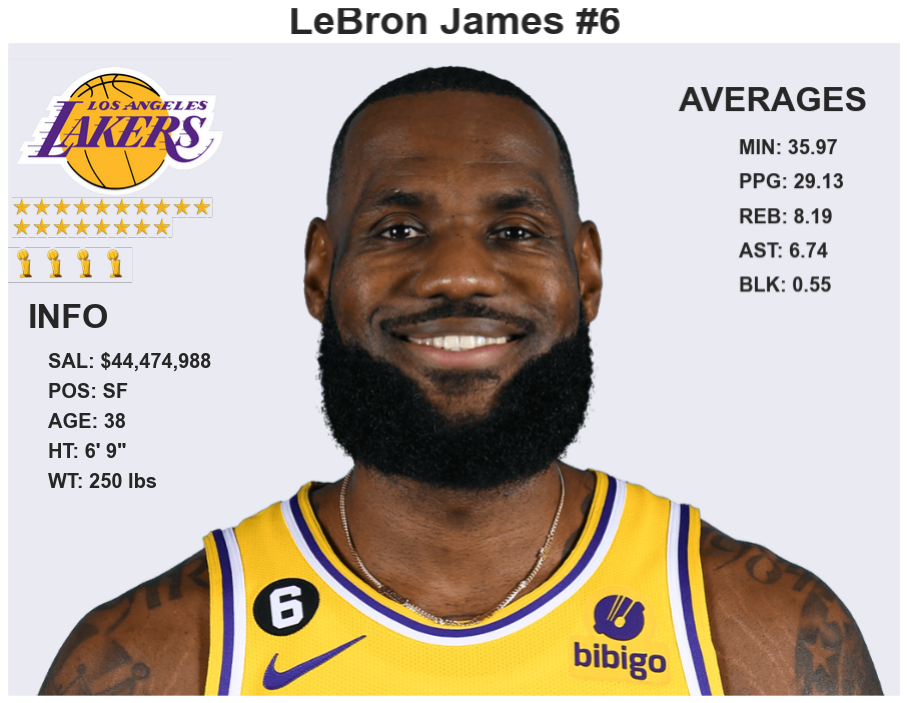

In [119]:
def display_player_image(player_id):
    
    team_index = len(df_players[df_players.PLAYER_ID==lebron_id].TEAM_NAME.unique()) - 1
    
    team_name = str(df_players[df_players.PLAYER_ID==player_id].TEAM_NAME.unique().item(team_index))
    team_name_formatted = team_name.lower()
    team_name_formatted = team_name_formatted.replace(' ','-')
    
    player_name = df_players[df_players.PLAYER_ID == player_id].PLAYER_NAME.unique().item()
    player_name_formatted = player_name.replace(' ','_')
    
    pic = urllib.request.urlretrieve(f"https://cdn.nba.com/headshots/nba/latest/1040x760/{player_id}.png")
    player_pic = plt.imread(pic[0])
    ax1 = plt.imshow(player_pic)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.text(780, 80, 'AVERAGES', fontsize=34, fontweight='bold')
    
    minutes = "{:.2f}".format(df_players[df_players.PLAYER_ID==player_id].MIN.mean())
    plt.text(850, 130, f'MIN: {minutes}', fontsize=20, fontweight='bold')
    
    ppg = "{:.2f}".format(df_players[df_players.PLAYER_ID==player_id].PTS.mean())
    plt.text(850, 170, f'PPG: {ppg}', fontsize=20, fontweight='bold')
    
    reb = "{:.2f}".format(df_players[df_players.PLAYER_ID==player_id].REB.mean())
    plt.text(850, 210, f'REB: {reb}', fontsize=20, fontweight='bold')
    
    ast = "{:.2f}".format(df_players[df_players.PLAYER_ID==player_id].AST.mean())
    plt.text(850, 250, f'AST: {ast}', fontsize=20, fontweight='bold')
    
    blk = "{:.2f}".format(df_players[df_players.PLAYER_ID==player_id].BLK.mean())
    plt.text(850, 290, f'BLK: {blk}', fontsize=20, fontweight='bold')

    
    #plt.text(770, 250, 'Pros', fontsize=34, fontweight='bold')
    
    
    logo_image = Image.open(f'C:\\Users\\Peter\\NBA_Logos\\{team_name_formatted}.png')
    baseheight = 150
    hpercent = (baseheight / float(logo_image.size[1]))
    wsize = int((float(logo_image.size[0]) * float(hpercent)))
    logo_image = logo_image.resize((wsize, baseheight), Image.Resampling.LANCZOS)
    
    try:
        num = int(df_player_bios[df_player_bios.Player == player_name].Jersey.item())
        title = f'{player_name} #{num}'
    except:
        title=f'{player_name}'
        
    plt.title(title, fontsize=40, fontweight='bold')
    plt.savefig(f'C:\\Users\\Peter\\NBA_Player_Summaries\\{player_name_formatted}.png',  pad_inches=0, bbox_inches = 'tight')
    plt.clf()
    
    player_image = Image.open(f'C:\\Users\\Peter\\NBA_Player_Summaries\\{player_name_formatted}.png')
    
    width1, height1 = player_image.size
    width2, height2 = logo_image.size
    player_image.paste(logo_image, (0, height2-100))
    
    plt.imshow(player_image)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.savefig(f'C:\\Users\\Peter\\NBA_Player_Summaries\\{player_name_formatted}.png',  pad_inches=0, bbox_inches = 'tight')
    plt.clf()
    
    player_image = Image.open(f'C:\\Users\\Peter\\NBA_Player_Summaries\\{player_name_formatted}.png')
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    star_image = Image.open('C:\\Users\\Peter\\star.png')
    baseheight_star = 20
    hpercent_star = (baseheight_star / float(star_image.size[1]))
    wsize_star = int((float(star_image.size[0]) * float(hpercent_star)))
    star_image = star_image.resize((wsize_star, baseheight_star), Image.Resampling.LANCZOS)
    
    logos_bottom_height=height2+80
    
    all_star=False
    all_star_10=False
    
    for i in df_all_stars.Player:
        if player_name == i:
            all_star=True
            for i in range(int(df_all_stars[df_all_stars.Player == player_name].Apps.item())):
                if i<=9: 
                    logos_bottom_height=height2+110
                    player_image.paste(star_image, (5+i*20, height2+40))
                elif i>9:
                    all_star_10=True
                    logos_bottom_height = height2+130
                    player_image.paste(star_image, (5+(i-10)*20, height2+60))
                    
    trophy_image = Image.open('C:\\Users\\Peter\\finals_trophy.png')
    baseheight_trophy = 35
    hpercent_trophy = (baseheight_trophy / float(trophy_image.size[1]))
    wsize_trophy = int((float(trophy_image.size[0]) * float(hpercent_trophy)))
    trophy_image = trophy_image.resize((wsize_trophy, baseheight_trophy), Image.Resampling.LANCZOS)
    
    #df_finals_champs_roster_post2000[df_finals_champs_roster_post2000.Player=='LeBron James'].Season.count()
    
    for i in df_finals_champs_roster_post2000.Player:
        if player_name == i:
            for i in range(int(df_finals_champs_roster_post2000[df_finals_champs_roster_post2000.Player == player_name].Season.count())):
                if all_star_10 == True:
                    player_image.paste(trophy_image, (i*30, height2+90))
                    logos_bottom_height= height2+170
                elif all_star == True:
                    player_image.paste(trophy_image, (i*30, height2+70))
                    logos_bottom_height= height2+150
                else:
                    player_image.paste(trophy_image, (i*30, height2+50))
                    logos_bottom_height= height2+130
    
    try:
        sal = df_player_bios_2[df_player_bios_2.Name == player_name].Salary.item()
        plt.text(40, logos_bottom_height+40, f'SAL: {sal}', fontsize=20, fontweight='bold')
        
        pos = df_player_bios_2[df_player_bios_2.Name == player_name].POS.item()
        age = df_player_bios_2[df_player_bios_2.Name == player_name].Age.item()
        ht = df_player_bios_2[df_player_bios_2.Name == player_name].HT.item()
        wt = df_player_bios_2[df_player_bios_2.Name == player_name].WT.item()

        plt.text(20, logos_bottom_height, 'INFO', fontsize=34, fontweight='bold')
        plt.text(40, logos_bottom_height+70, f'POS: {pos}', fontsize=20, fontweight='bold')
        plt.text(40, logos_bottom_height+100, f'AGE: {age}', fontsize=20, fontweight='bold')
        plt.text(40, logos_bottom_height+130, f'HT: {ht}', fontsize=20, fontweight='bold')
        plt.text(40, logos_bottom_height+160, f'WT: {wt}', fontsize=20, fontweight='bold')
    except:
        pass
    
    plt.imshow(player_image)
    
    plt.savefig(f'C:\\Users\\Peter\\NBA_Player_Summaries\\{player_name_formatted}.png',  pad_inches=0, bbox_inches = 'tight')
    plt.show()
    
display_player_image(lebron_id)


## Function to Display Roster Summary of Players

In [120]:
def display_roster_summary(team_abbr):
    for i in df_player_avg[df_player_avg['TEAM_ABBREVIATION']==team_abbr].sort_values('PTS',ascending=False).reset_index(drop=True).PLAYER_ID.unique():
        display_player_image(i)
        try:
            career_summary(df_players[df_players.PLAYER_ID == i].PLAYER_NAME.unique().item().strip())
        except: pass
        if df_players[df_players.PLAYER_ID==i].PTS.count() > 0:
            player_points_plot(df_players[df_players.PLAYER_ID==i].PLAYER_NAME.unique().item())
            try:
                if df_players[df_players.PLAYER_ID==i].AST.count() > 0 and df_players[df_players.PLAYER_ID==i].REB.count() > 0:
                    player_pra_violins(df_players[df_players.PLAYER_ID==i].PLAYER_NAME.unique().item())
            except: pass
            try:
                player_shooter_pies(df_players[df_players.PLAYER_ID==i].PLAYER_NAME.unique().item())
            except: pass
        print()
        print()
        print('------------------------------------------------------------------------------------------------------------------')
        print()
        print()
#display_roster_summary('CLE')

## Team Report Function

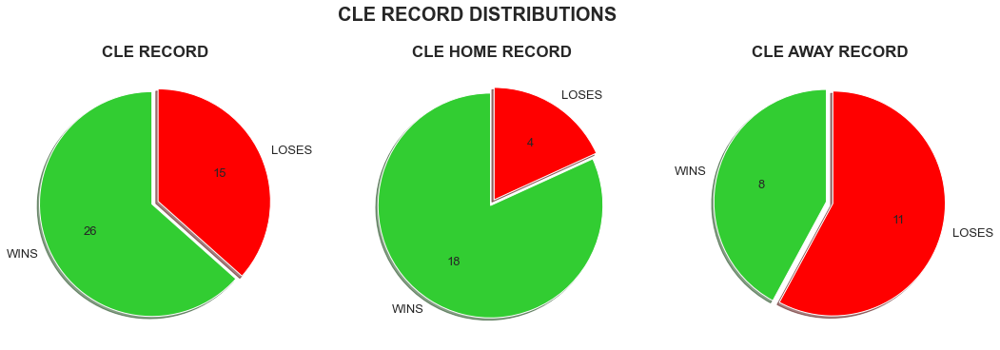

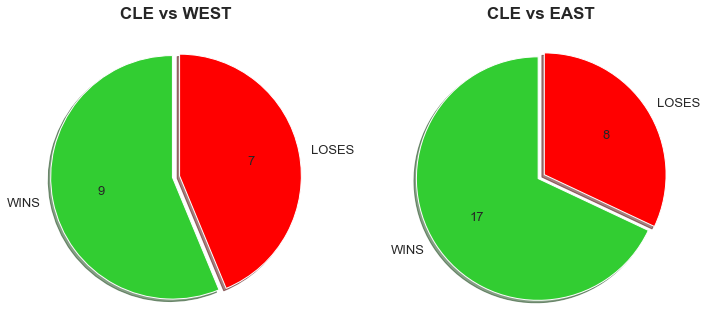

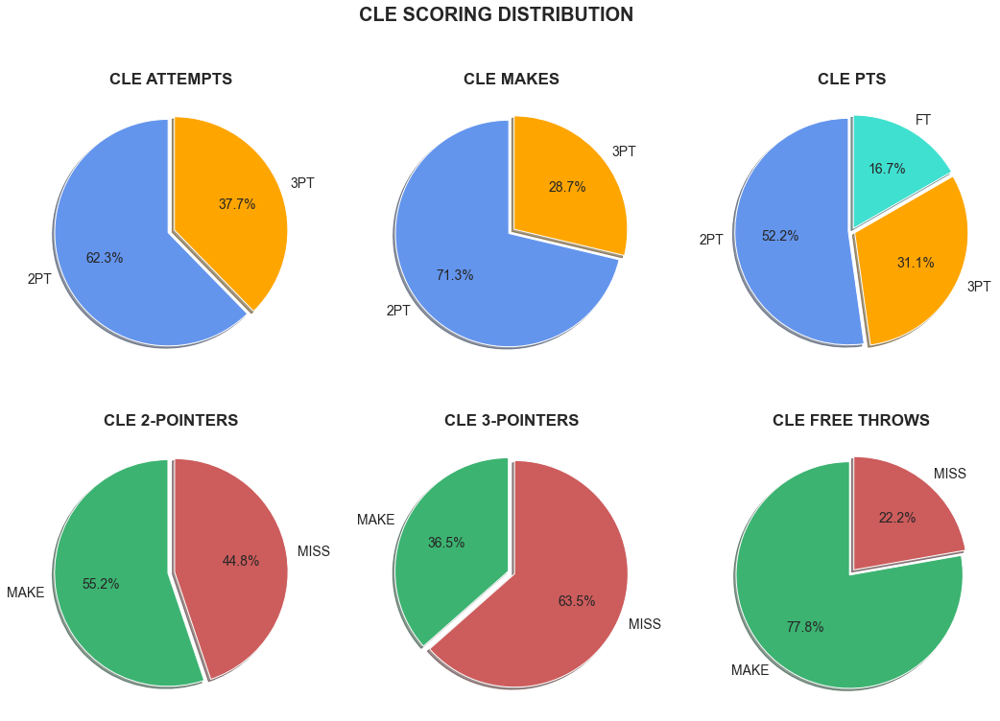

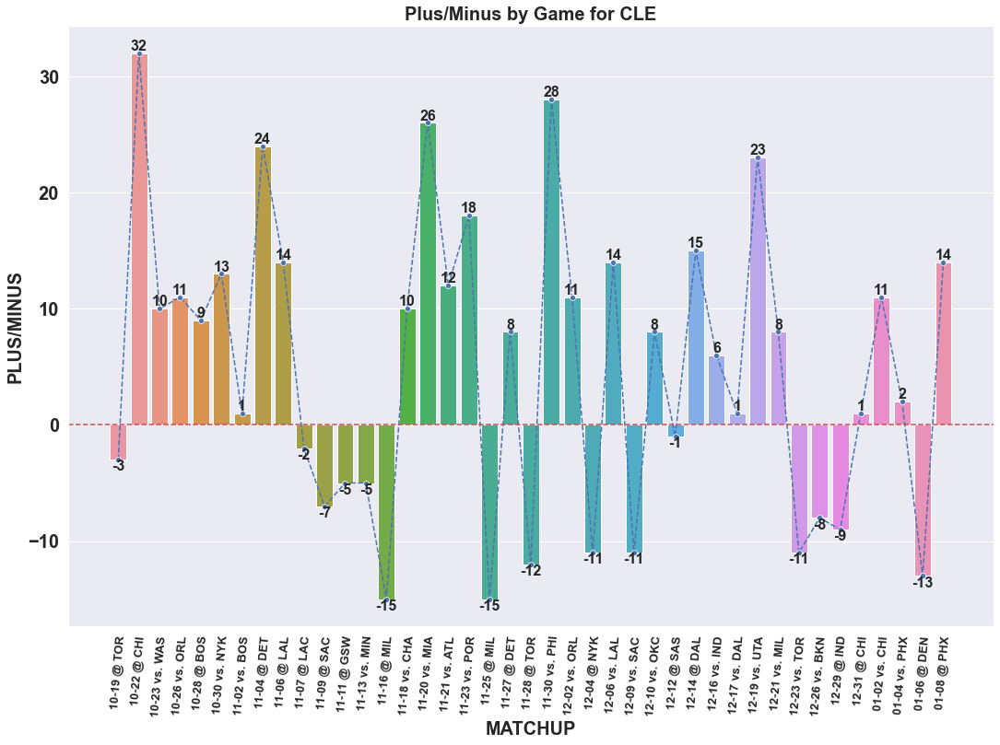

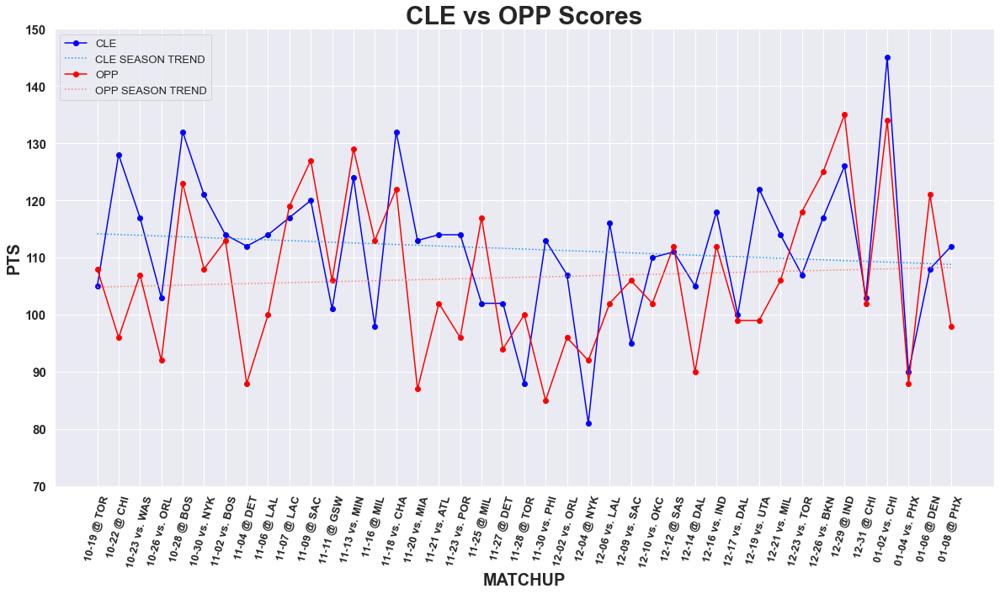

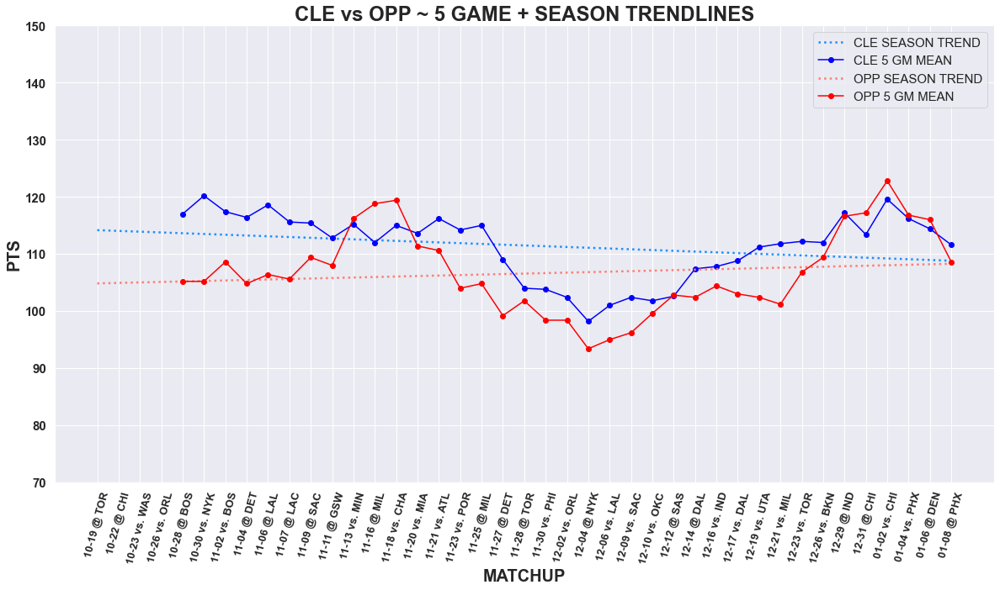

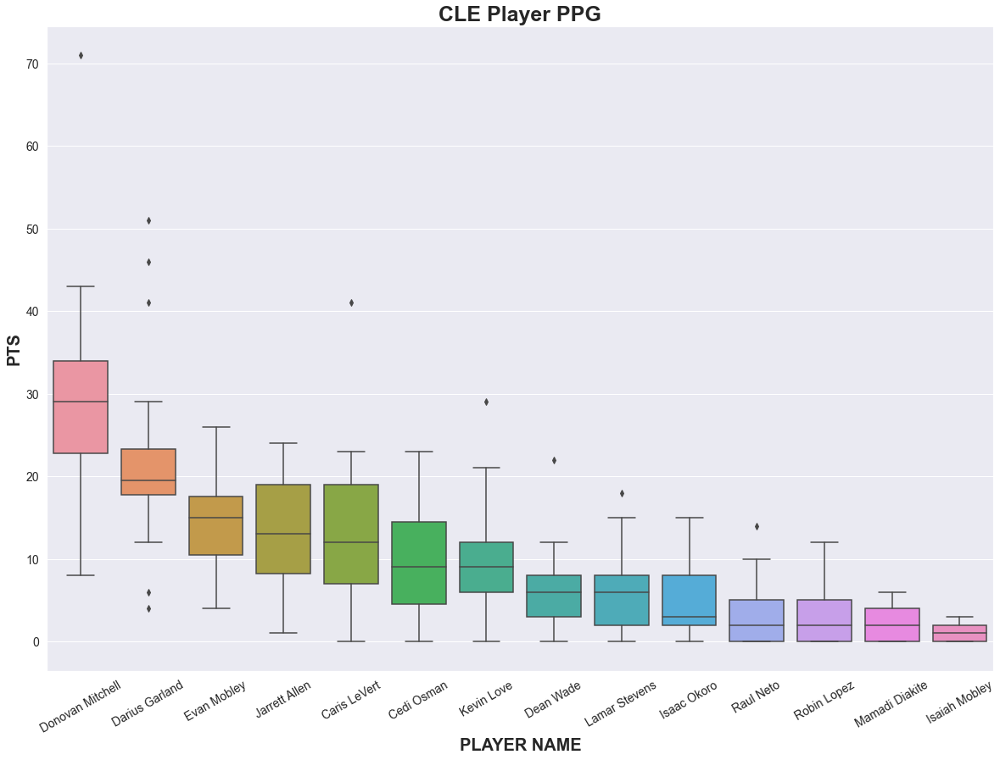

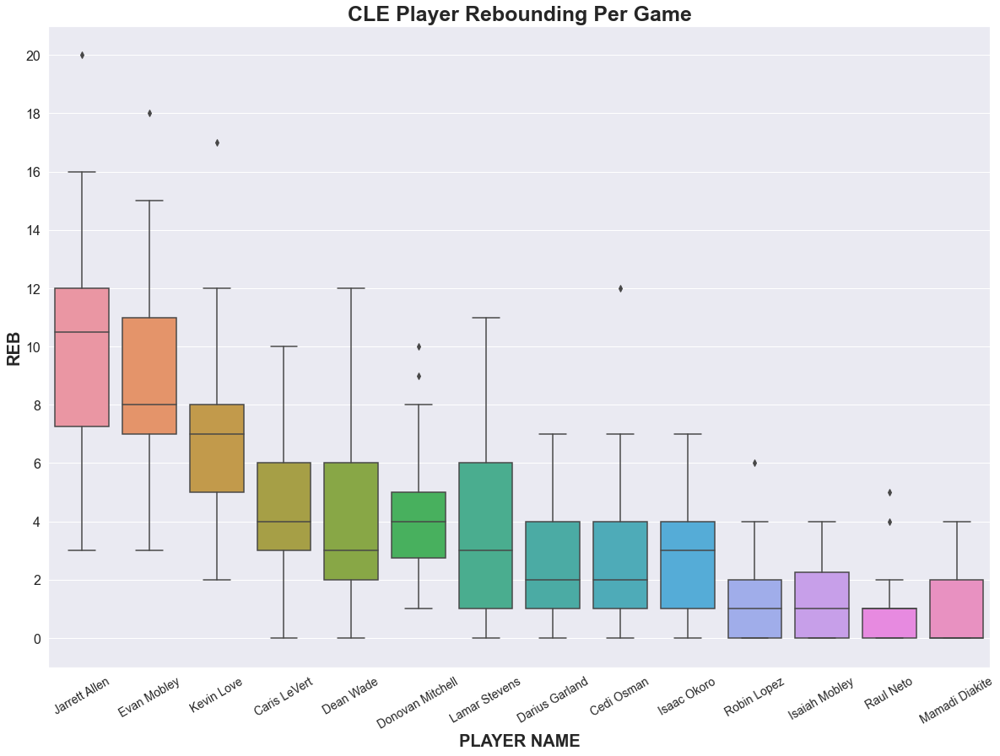

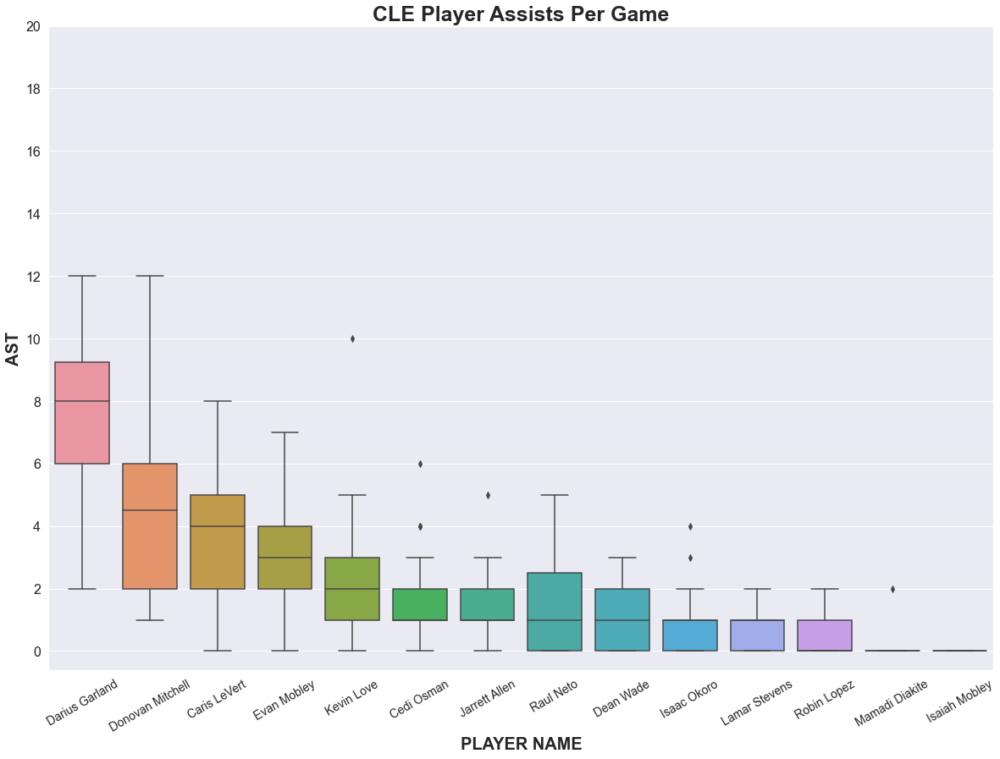

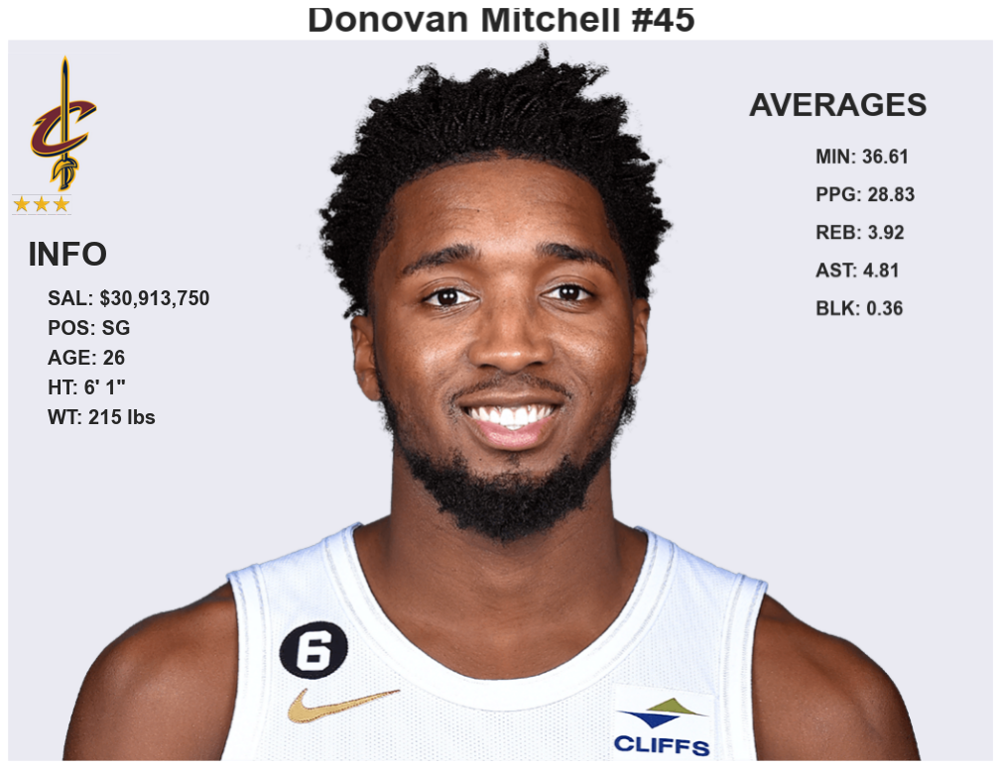

Professional Summary
A 6-foot-3 guard, Donovan Mitchell took the NBA by storm during his rookie season. Mitchell led all rookies in scoring at 20.5 points per game, and he was named Western Conference Rookie of the Month for December, January, February and March/April. Mitchell scored at least 25 points 27 times, and dropped 41 points in a home win over the Pelicans on December 1.  The Denver Nuggets selected Mitchell with the No. 13 overall pick in the 2017 NBA Draft—and then immediately traded him to the Jazz. He won the 2018 NBA Slam Dunk Contest, and he finished second in Rookie of the Year voting.  In 2020, Mitchell was named an NBA All-Star.  Mitchell's jersey number is 45, which he wears in honor of Michael Jordan, who wore the number while playing baseball and when he first returned to the NBA in 1995. Mitchell goes by the nickname "Spida," which has become an official entry on dictionary.com.


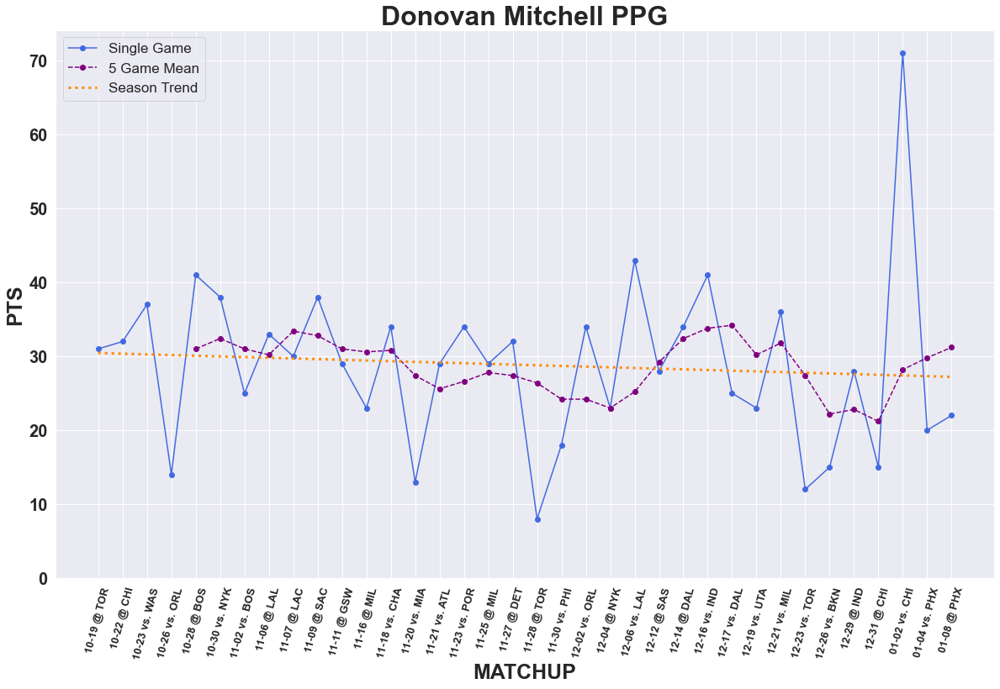

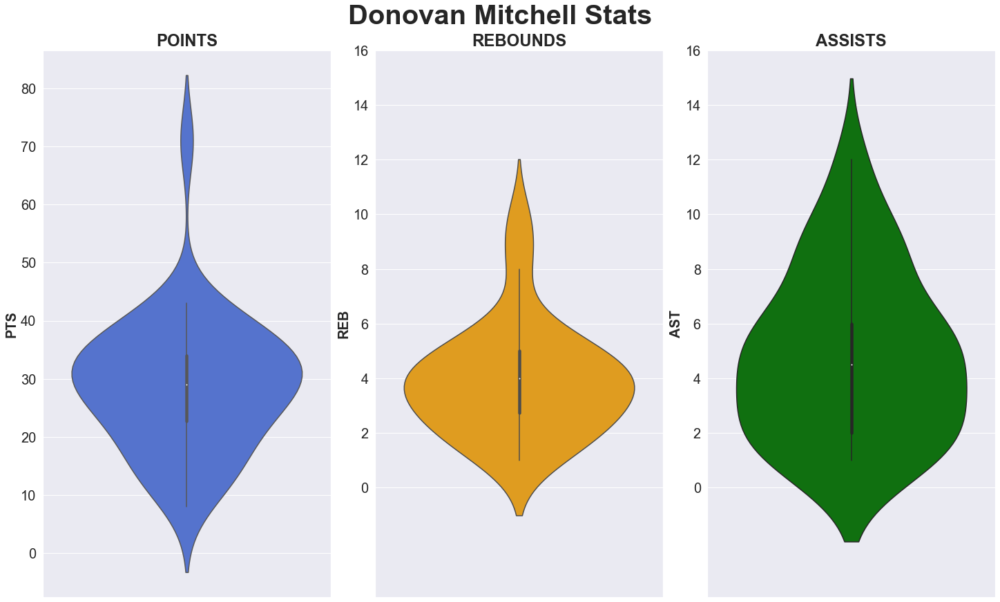

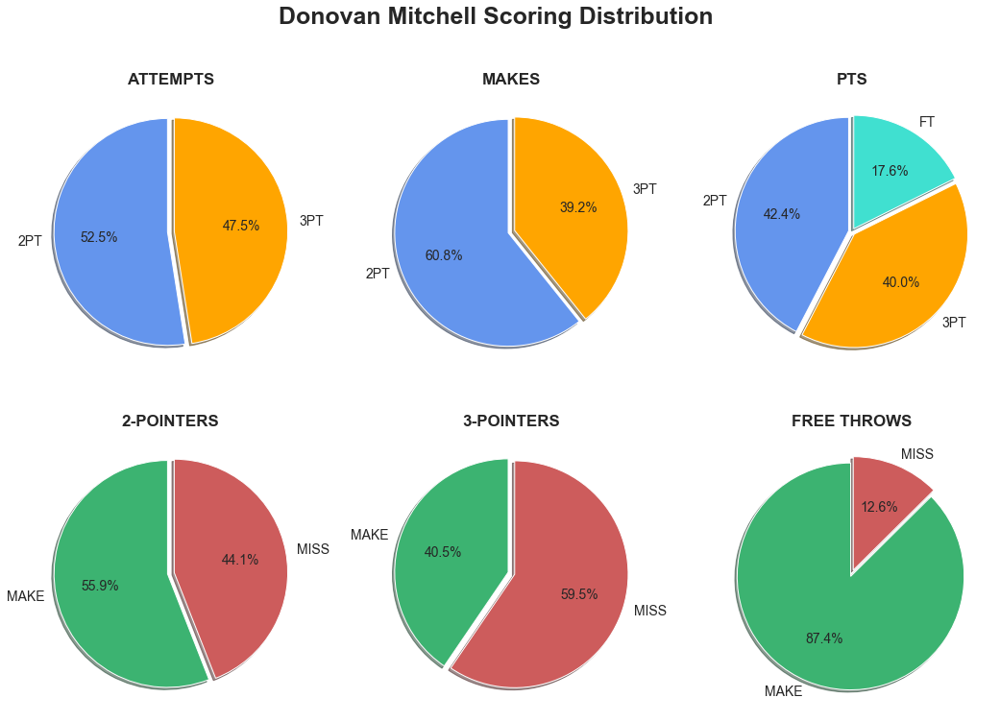



------------------------------------------------------------------------------------------------------------------




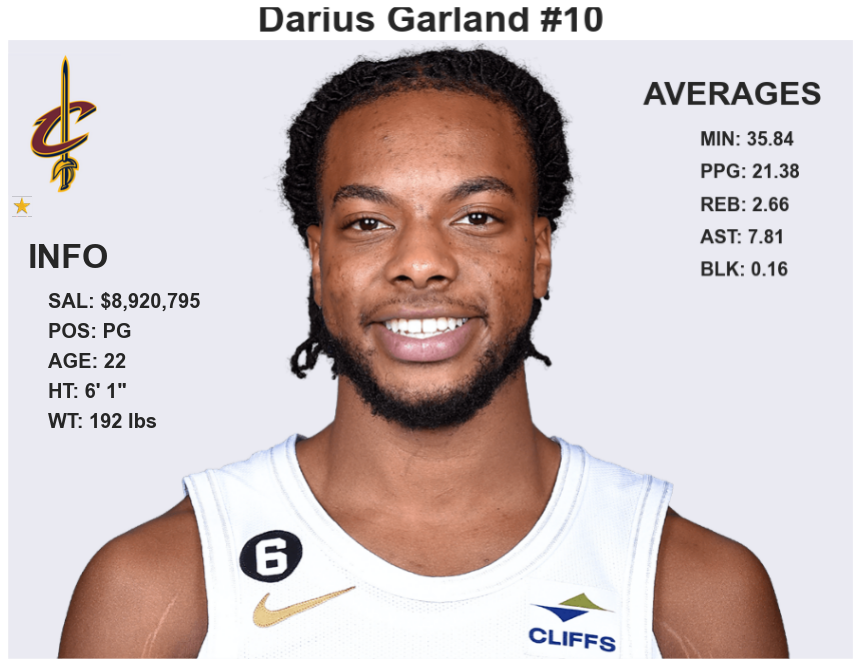

Professional Summary
DRAFTED: Selected in the first round (5th overall pick) of the 2019 NBA Draft by the Cleveland Cavaliers. 


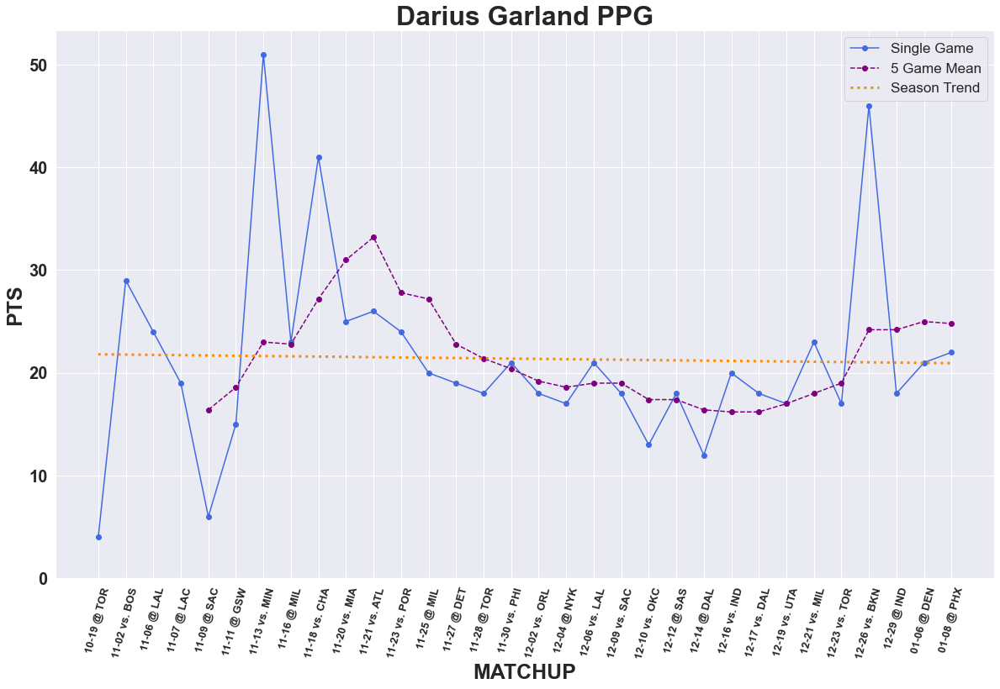

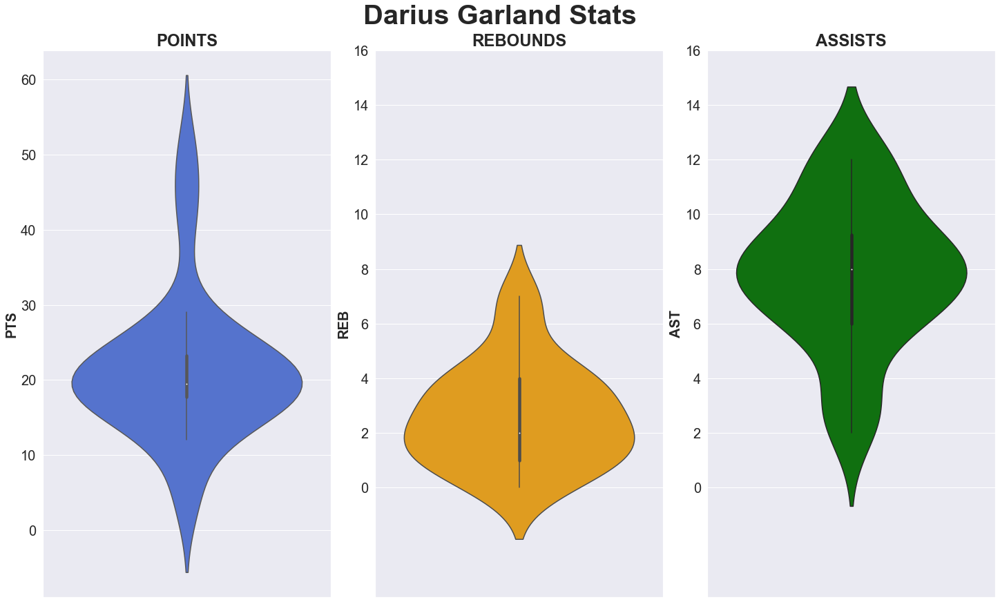

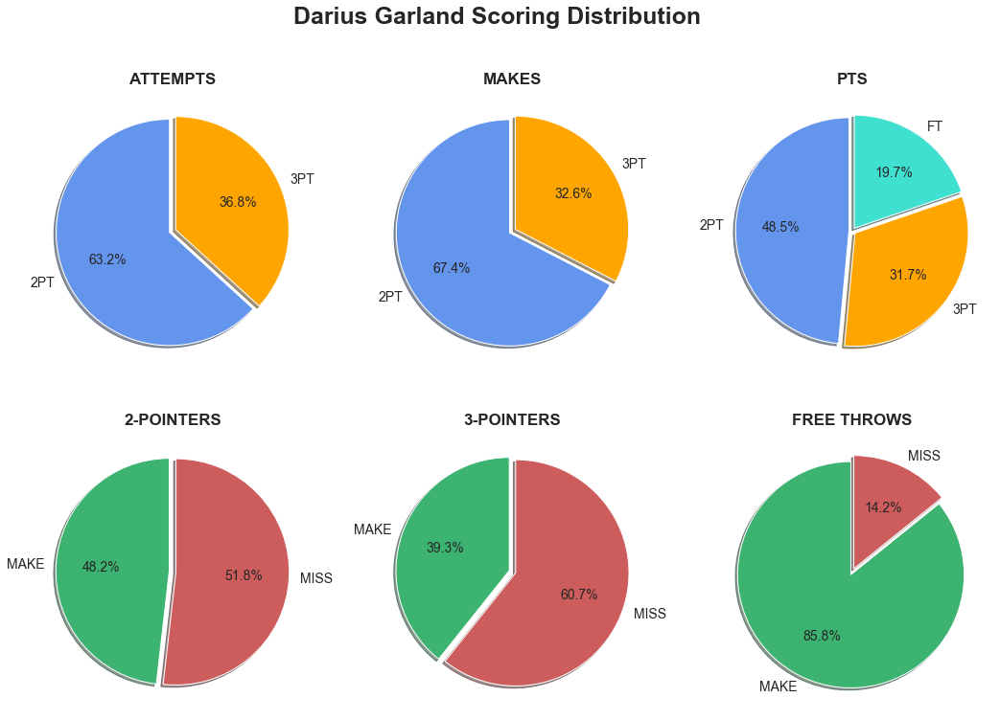



------------------------------------------------------------------------------------------------------------------




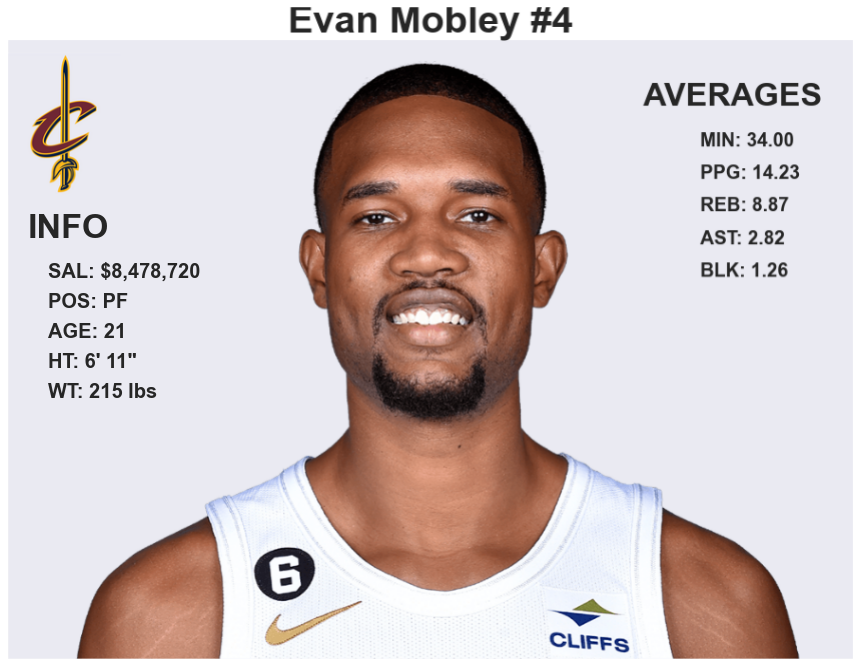

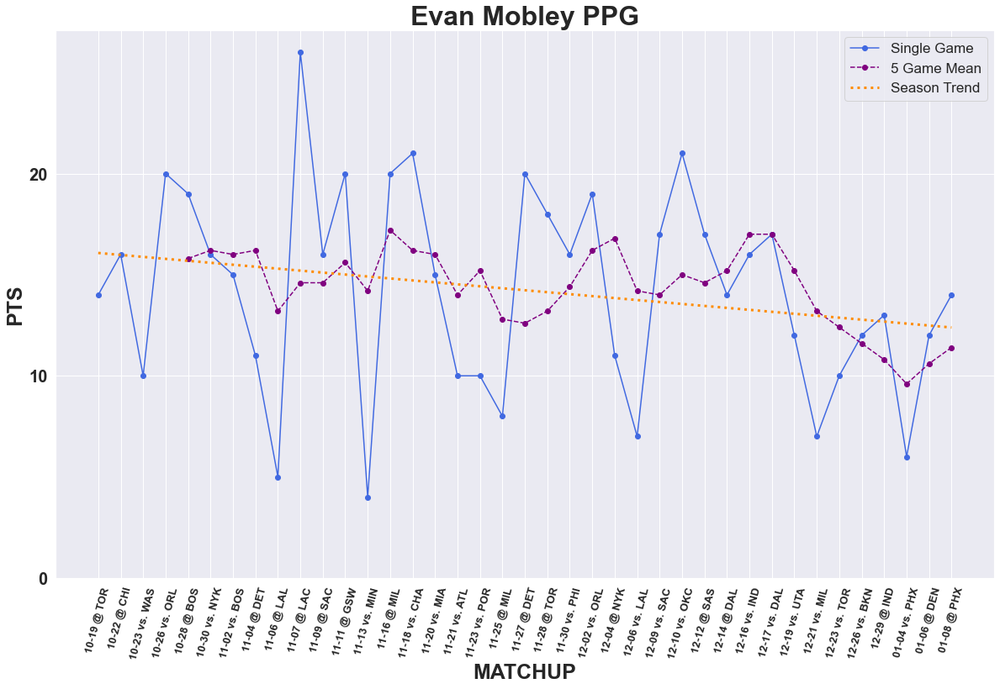

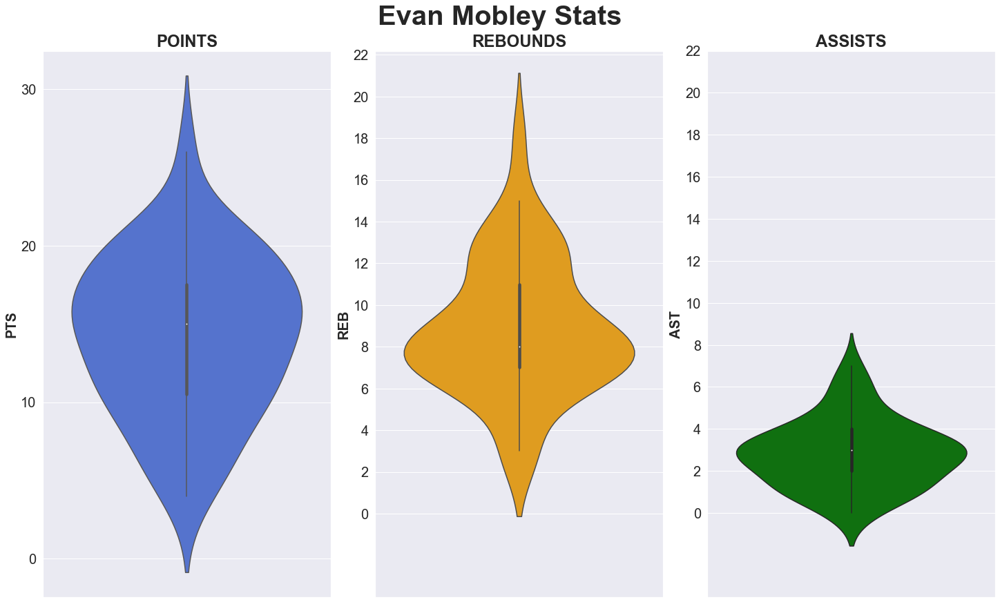

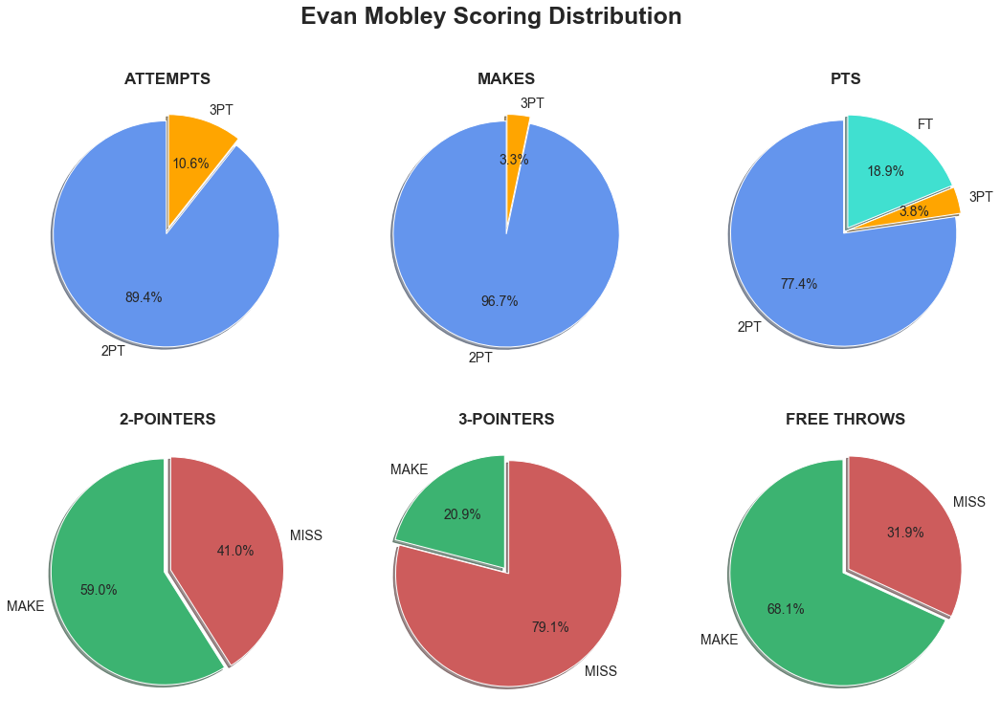



------------------------------------------------------------------------------------------------------------------




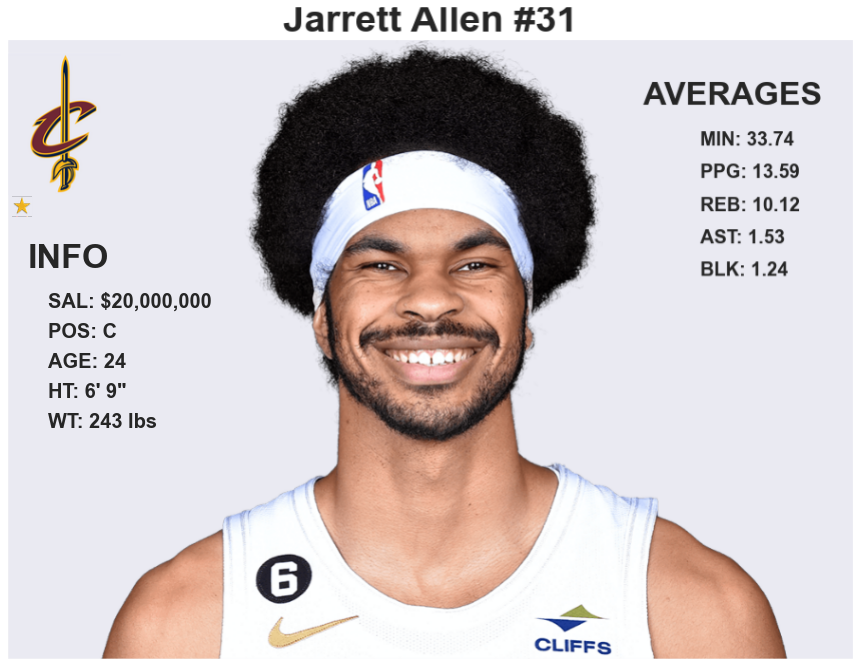

Professional Summary
In two seasons with the Brooklyn Nets, has appeared in 152 games (111 starts), averaging 9.6 points, 7.0 rebounds, 1.0 assists and 1.4 blocks in 23.3 minutes per game… Has shot a career .590 (569-of-965) from the field, .183 (11-of-60) from the 3-point line and .732 (311-of-425) from the charity stripe.


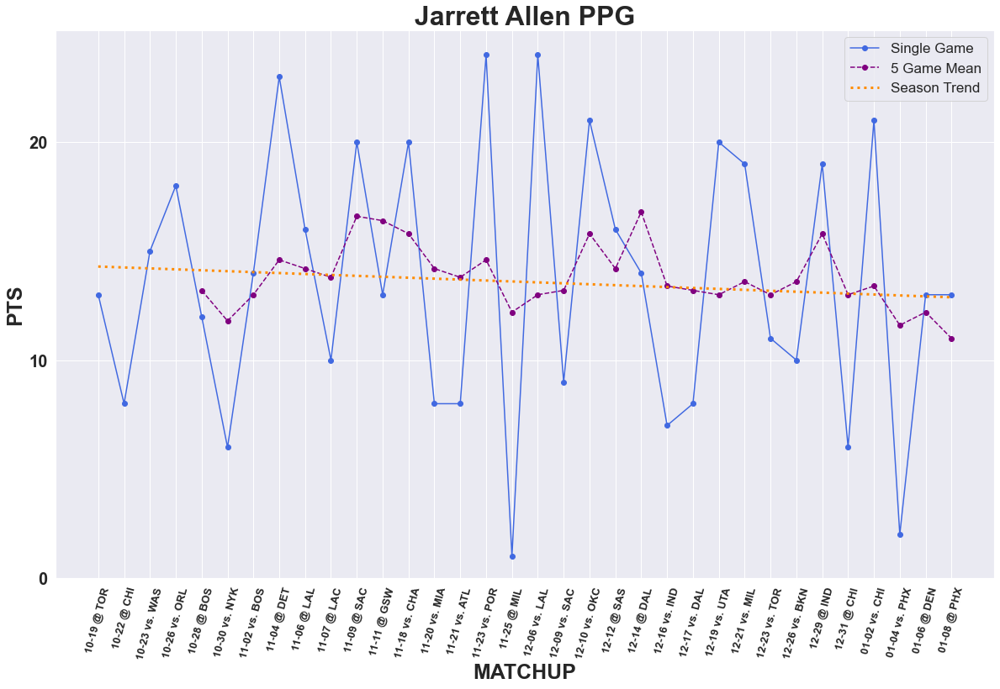

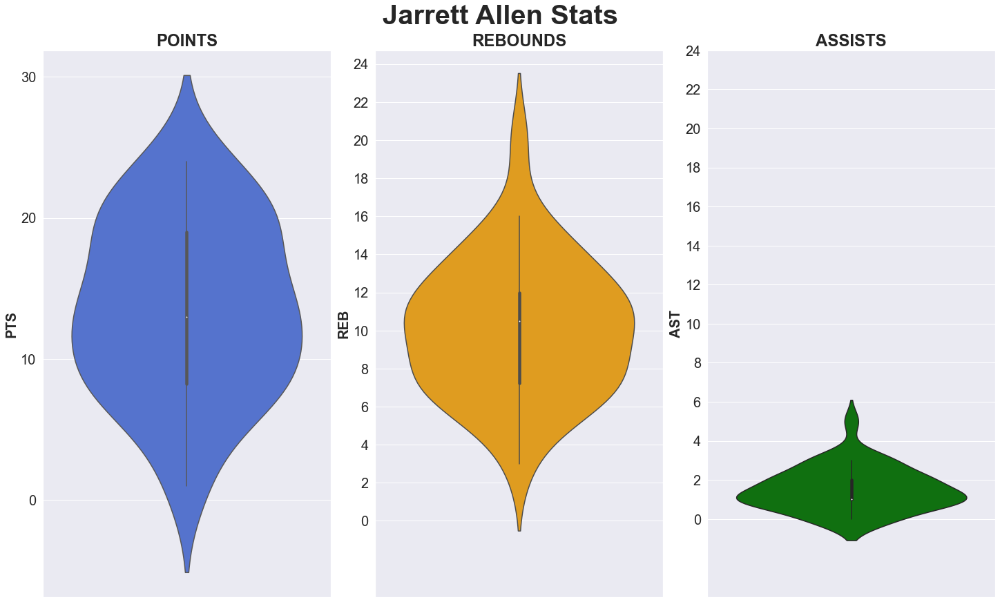

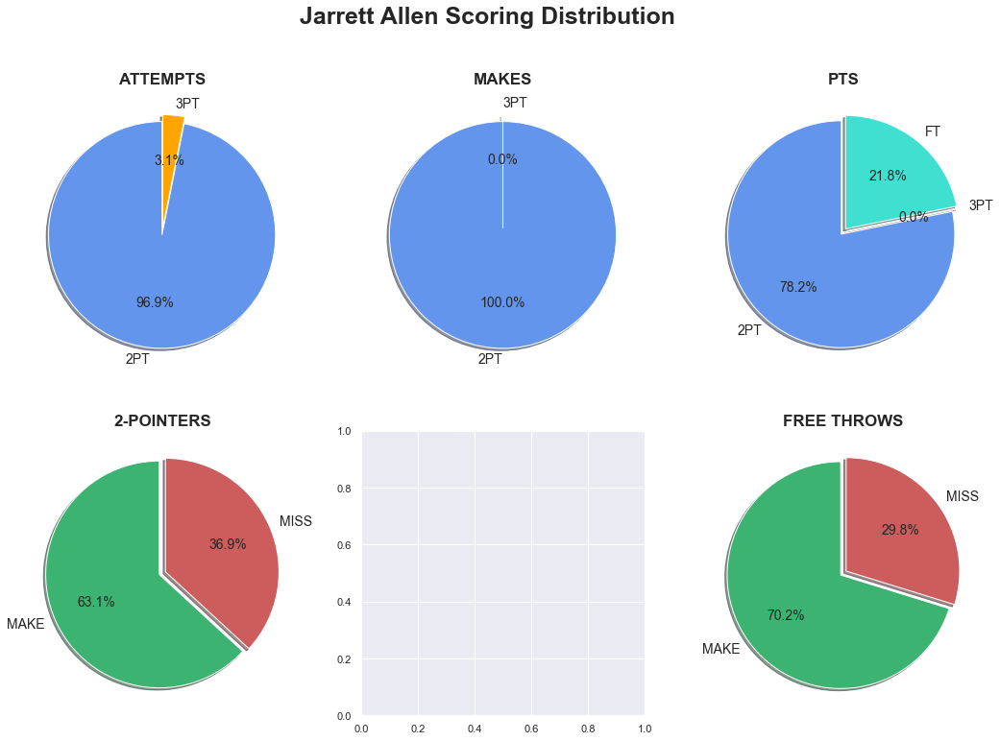



------------------------------------------------------------------------------------------------------------------




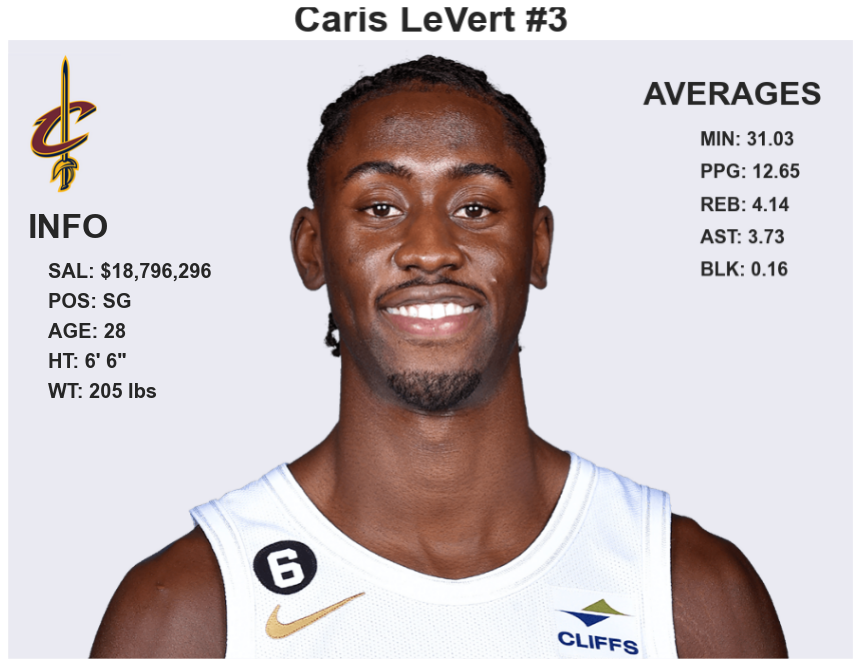

Professional Summary
Has appeared in 168 career NBA games (61 starts), averaging 11.1 points, 3.6 rebounds, 3.4 assists and 1.0 steals in 24.8 minutes per contest… A career .437 (698-of-1598) shooter from the field, .329 (192-of-583) from long distance and .707 (285-of-403) from the charity stripe… 2017-18 Season (Brooklyn Nets): Appeared in 71 games (10 starts), averaging 12.1 points, 3.7 rebounds, 4.2 assists and 1.2 steals in 26.2 minutes per game… Shot .435 (320-of-735 FG), .347 (85-of-245 3FG) and .711 (133-of-187 FT).


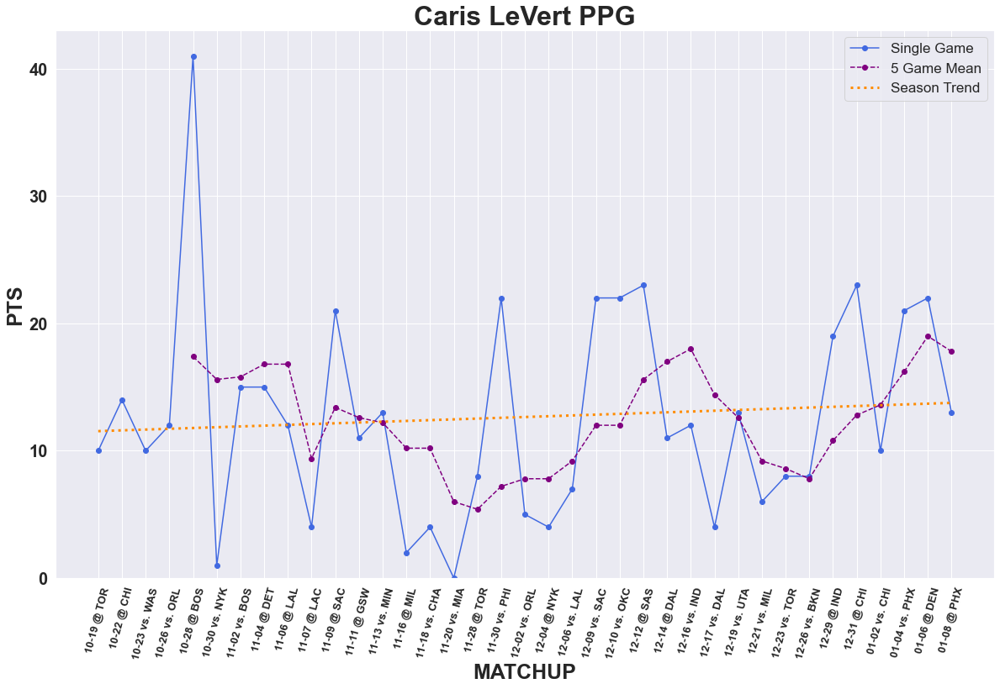

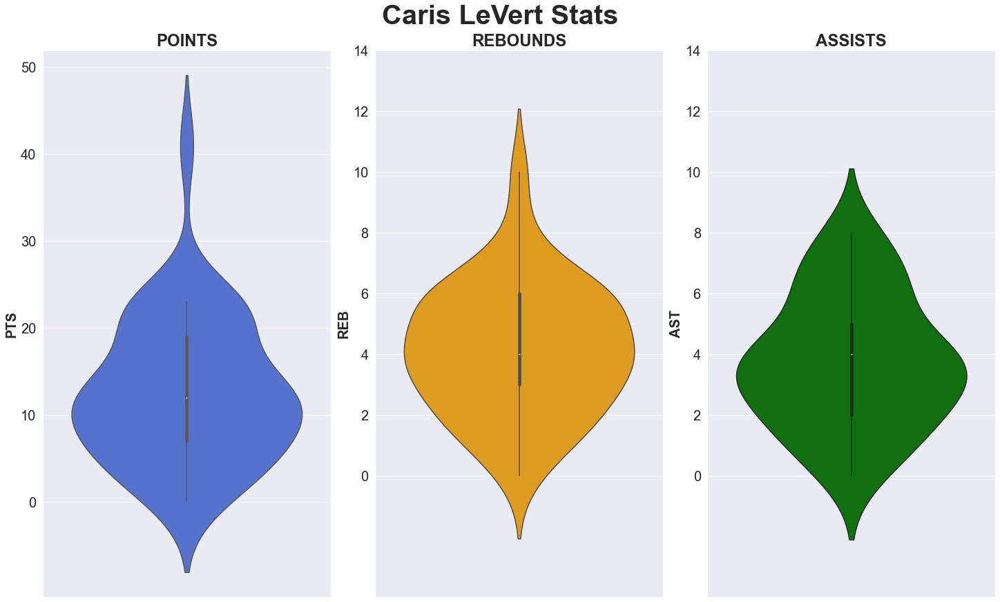

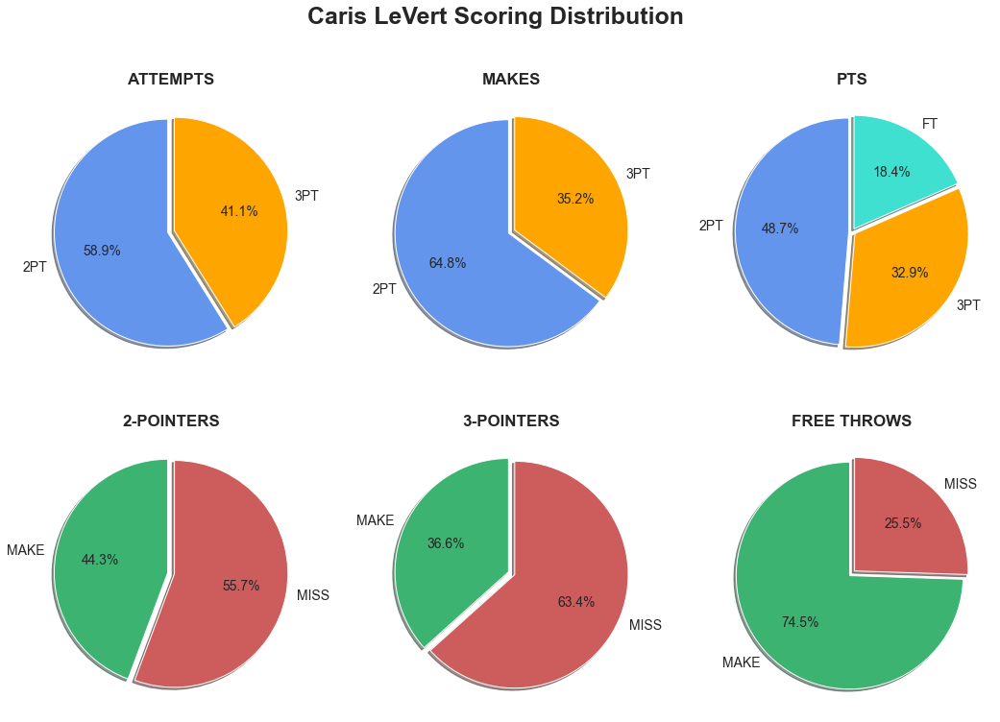



------------------------------------------------------------------------------------------------------------------




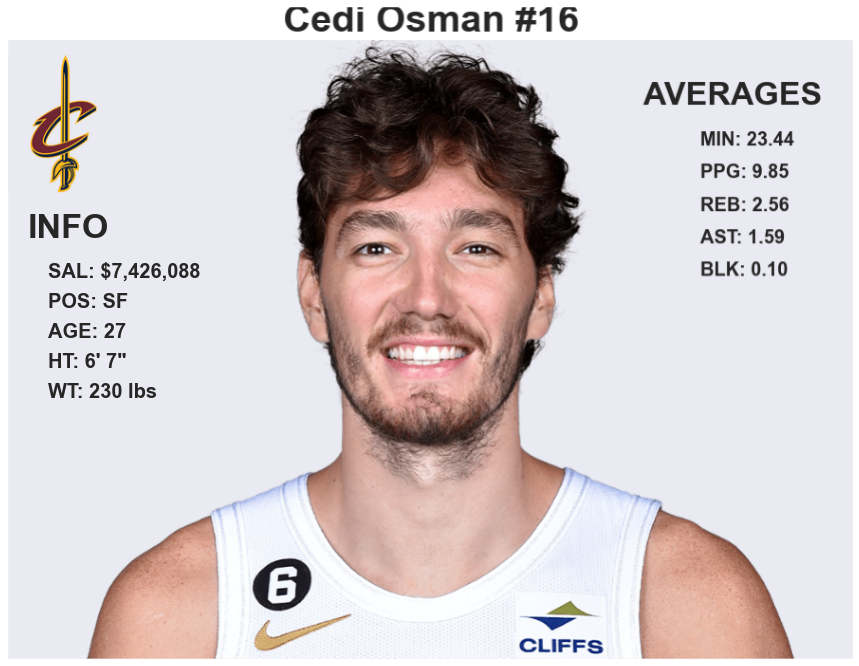

Professional Summary
Has played in 137 career contests (87 starts) over two seasons with the Cavaliers…holds career averages of 9.0 points on .437 shooting, 3.5 rebounds and 1.7 assists in 22.7 minutes per game…also shooting .351 from three-point territory and .736 from the charity stripe.  NOTABLE: Was named to the World Team for the 2019 MTN DEW ICE Rising Stars at NBA All-Star Weekend 2019 in Charlotte…had two points, three rebounds, four assists and two steals in 15 minutes of action for the World Team in the game, held on Feb. 15, 2019…represented Turkey in the FIBA World Cup 2019 and the 2018 FIBA World Cup qualifying tournament…BSL All-Star (2015, 2016, 2017)…2015 Turkish Cup winner…2015 Turkish Supercup winner…2014 FIBA Europe Under-20 Championship MVP…2012 Albert Schweitzer Tournament Most Talented Player…member of the Turkish national basketball team. 


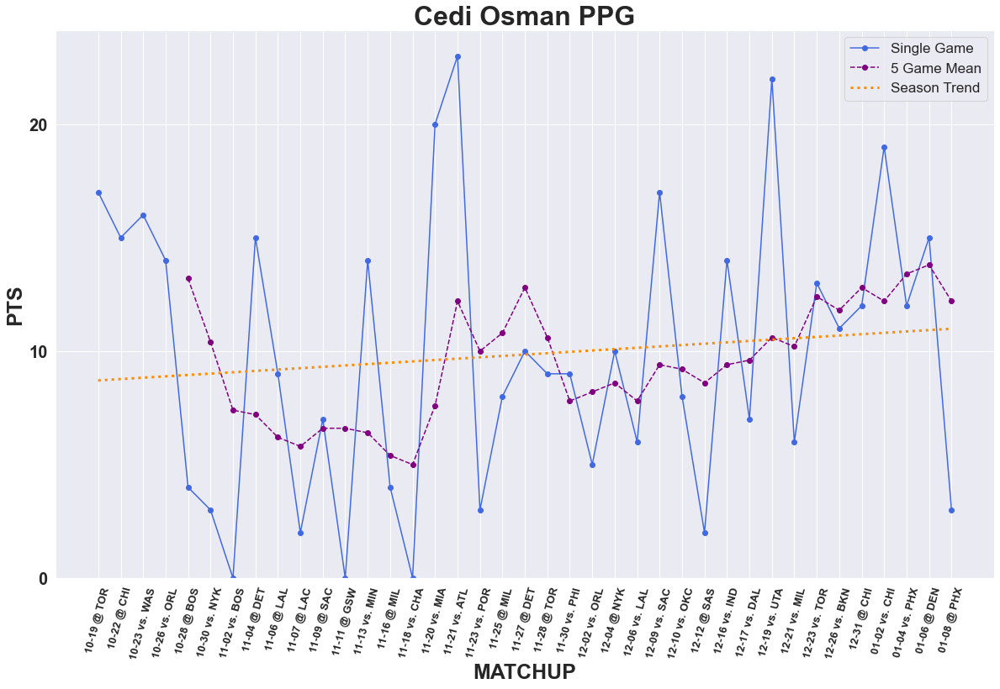

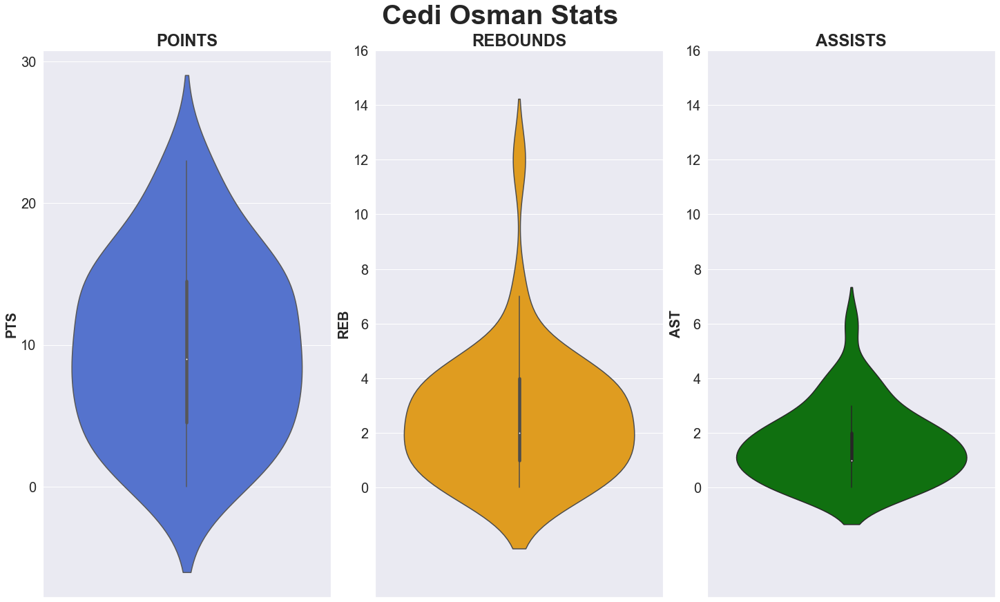

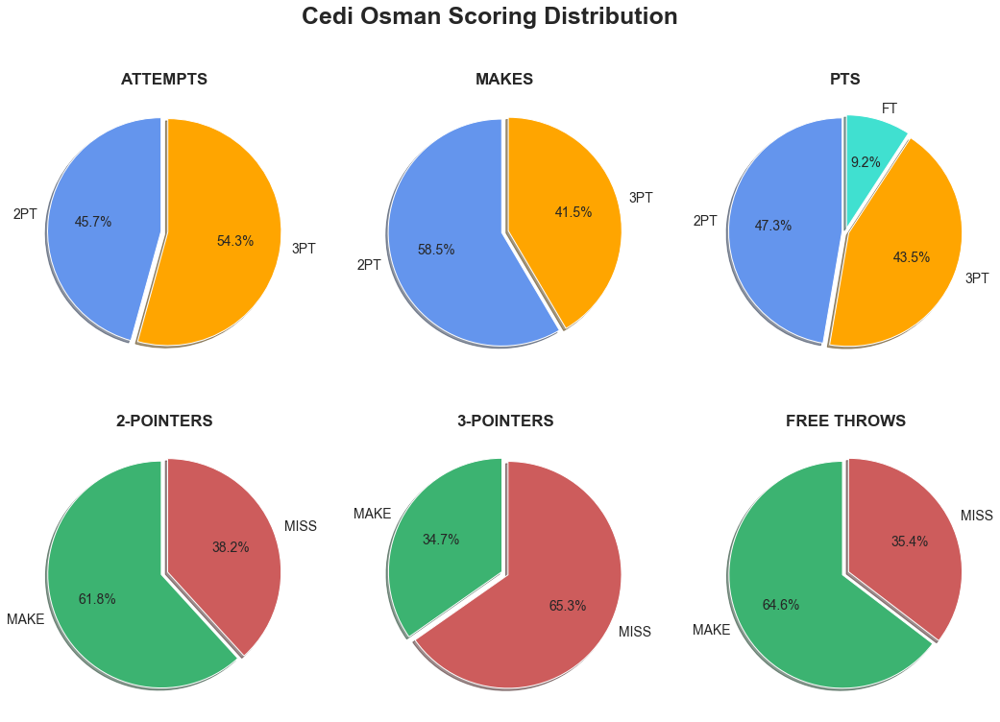



------------------------------------------------------------------------------------------------------------------




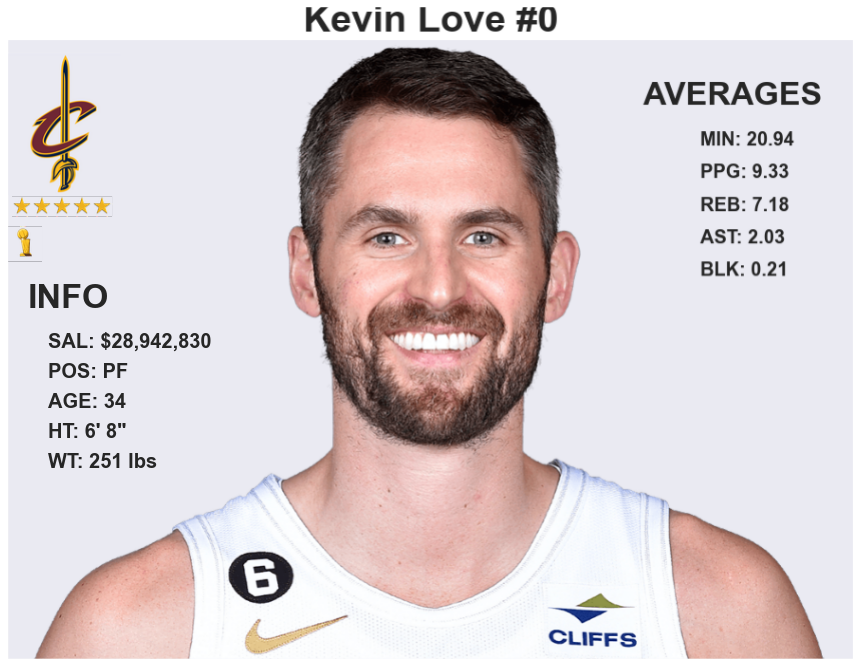

Professional Summary
Owns career averages of 18.3 points on .442 shooting, 11.3 rebounds and 2.3 assists in 32.0 minutes per game in 657 games (574 starts) over 11 seasons with Minnesota and Cleveland…also shooting .370 from three-point range and .827 from the free throw line for his career…has 413 double-doubles and three triple-doubles…has averaged at least 9.0 rebounds in all 11 of his NBA seasons and since entering the league…since 1980-81, he is one of only three players to have at least two seasons with 26.0 points and 12.5 rebounds (2011-12, 2013-14), along with Shaquille O’Neal (4) and Moses Malone (2)…is the only player in league history to average 10.0 rebounds and make over 1,000 three-pointers….has an NBA-record 27 career games with at least 25 points, 15 rebounds and three three-pointers.  NOTABLE: NBA Champion (2016)…a five-time NBA All-Star (2011, 2012, 2014, 2017, 2018), two-time All-NBA Second Team selection (2012, 2014), Olympic gold medalist (2012) and winner of the 

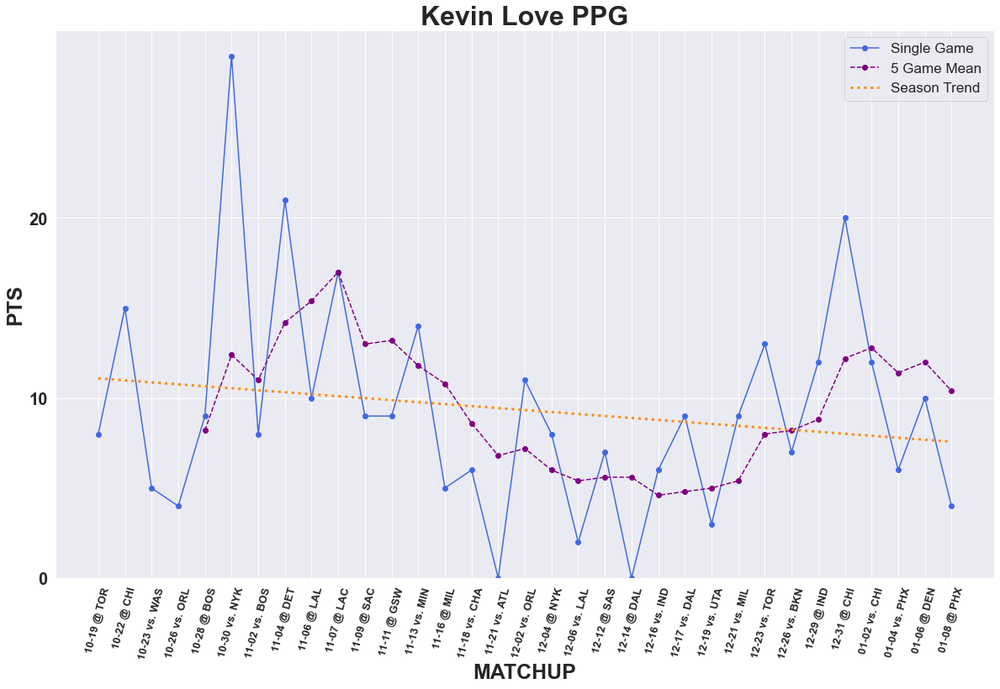

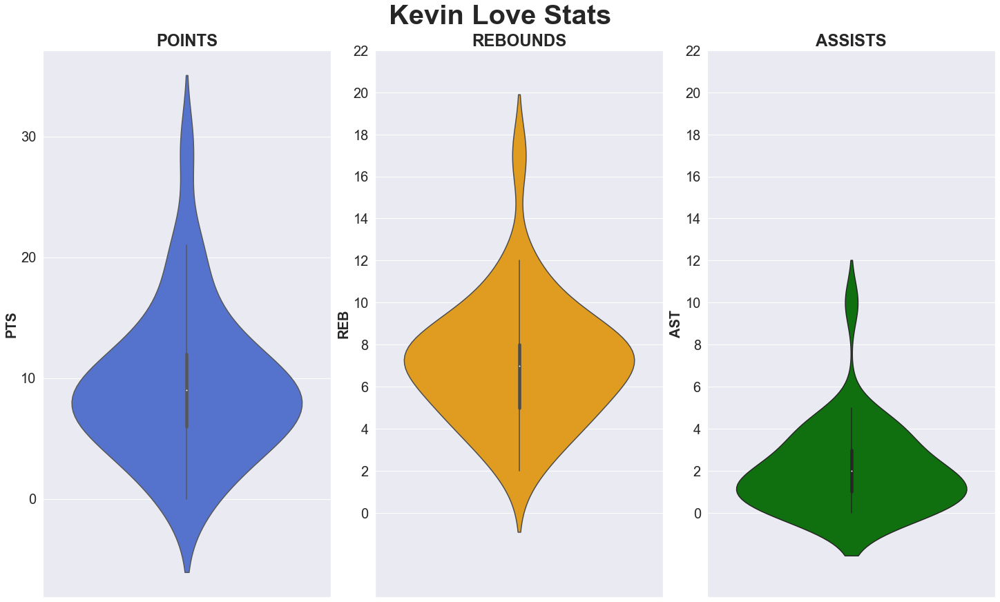

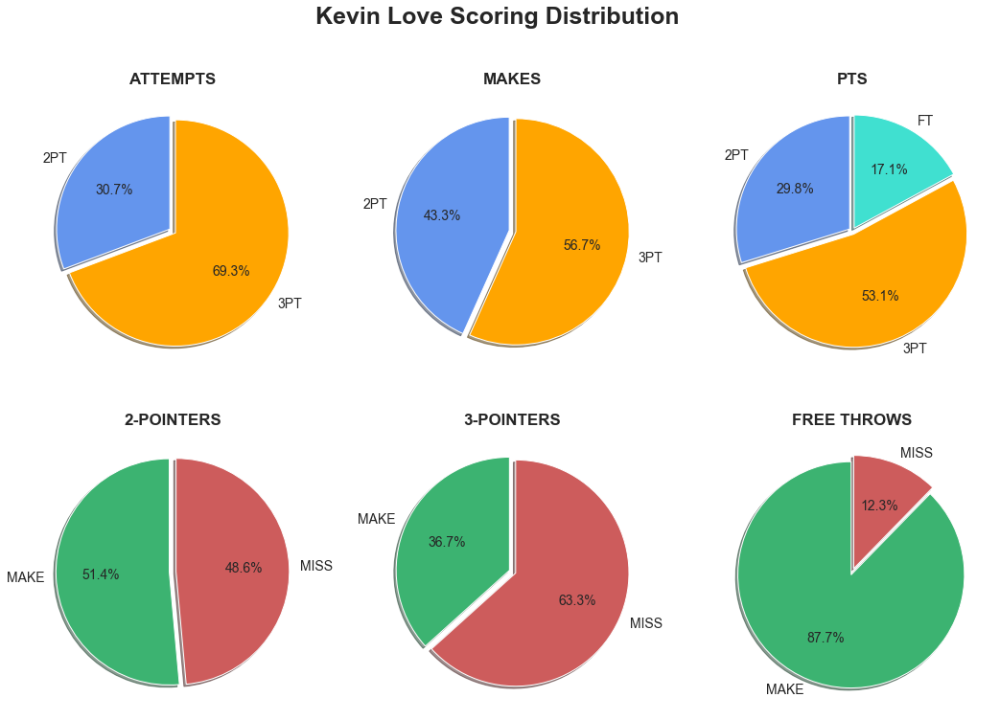



------------------------------------------------------------------------------------------------------------------




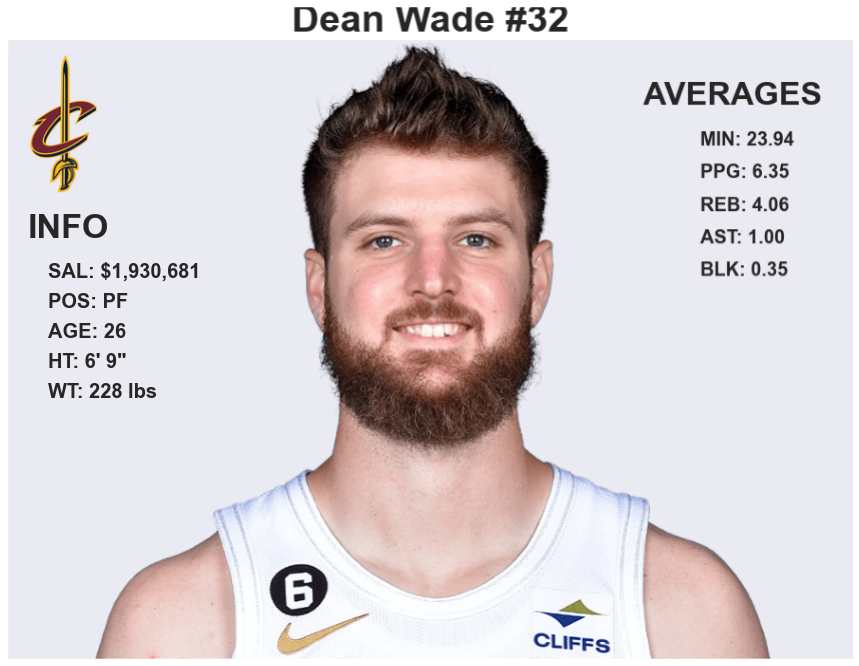

Professional Summary
HOW ACQUIRED: Signed to a Two-Way contract by the Cleveland Cavaliers on July 9, 2019. 


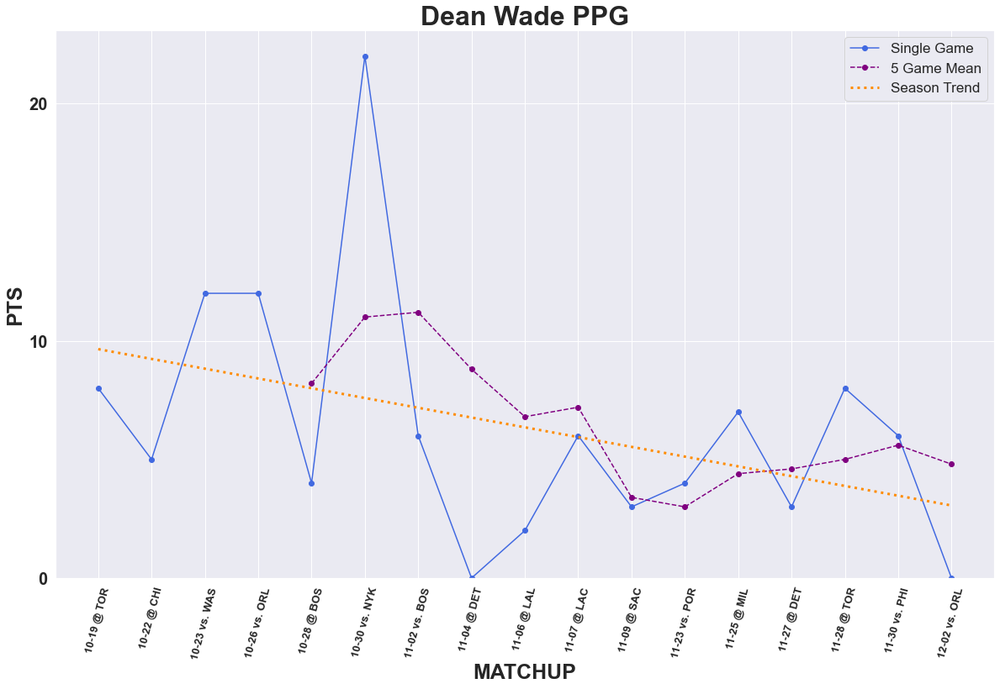

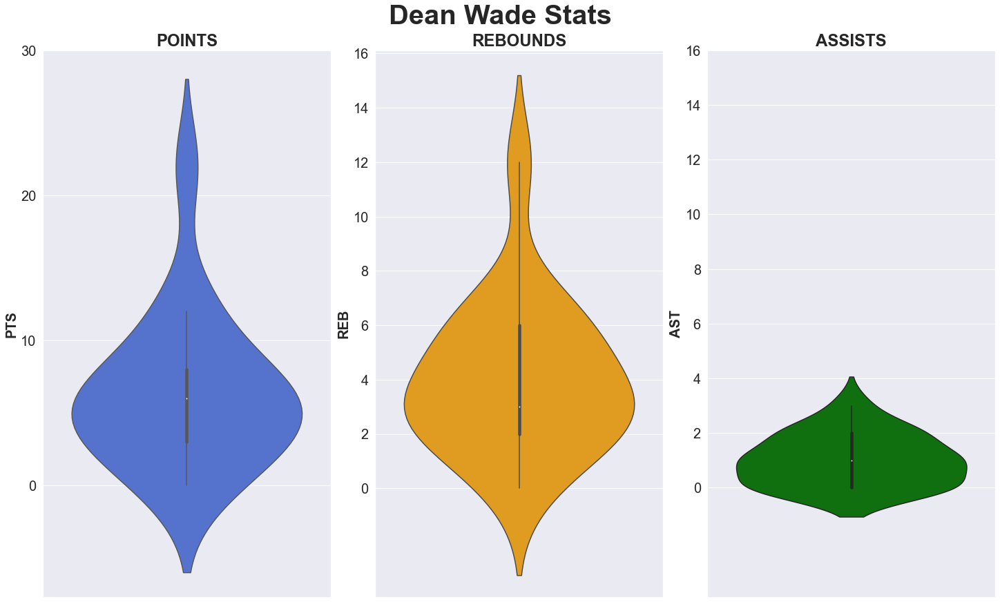

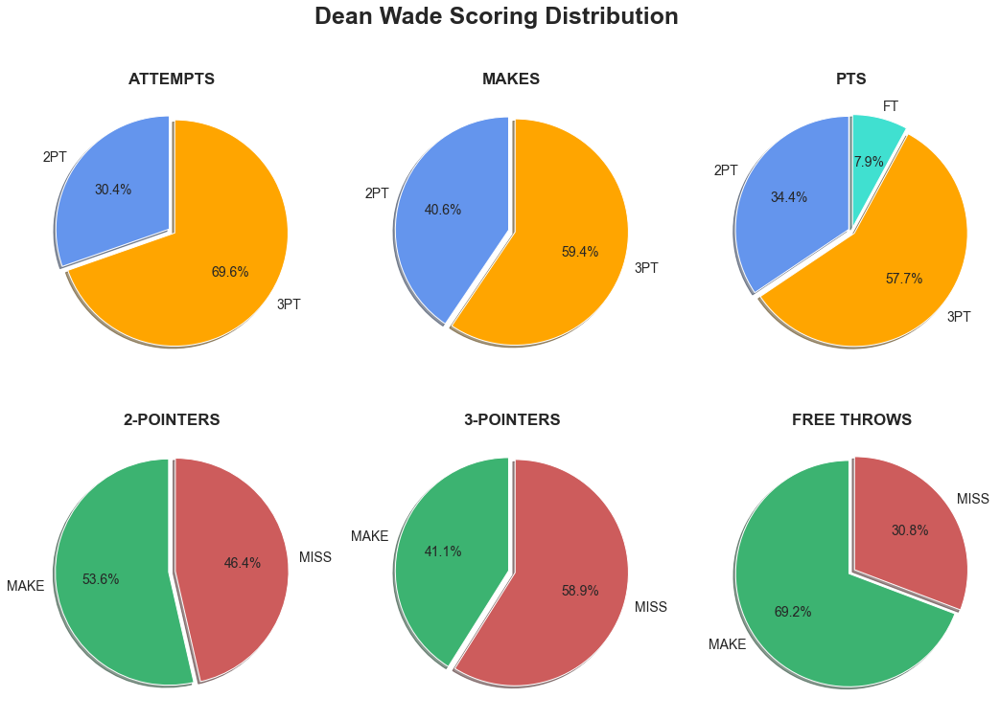



------------------------------------------------------------------------------------------------------------------




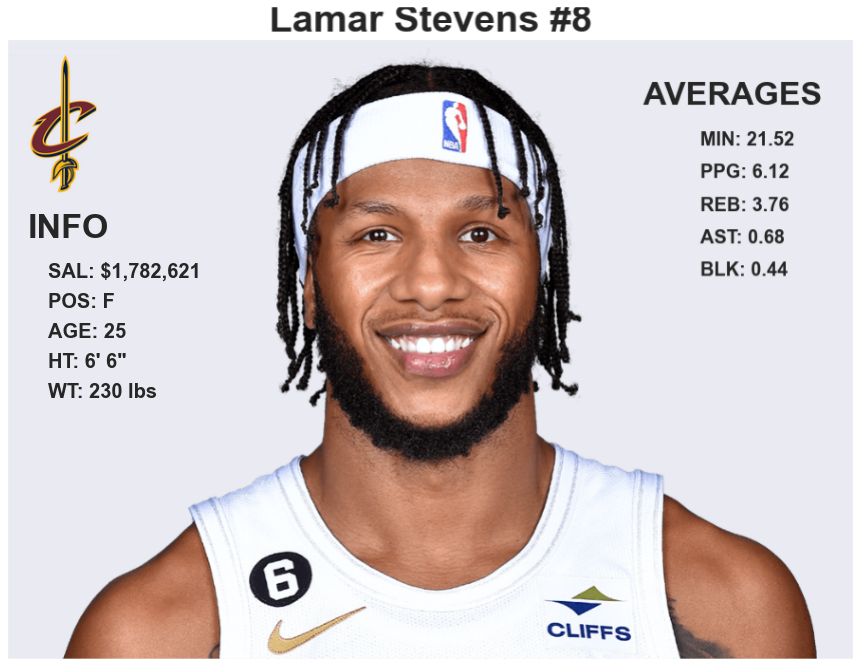

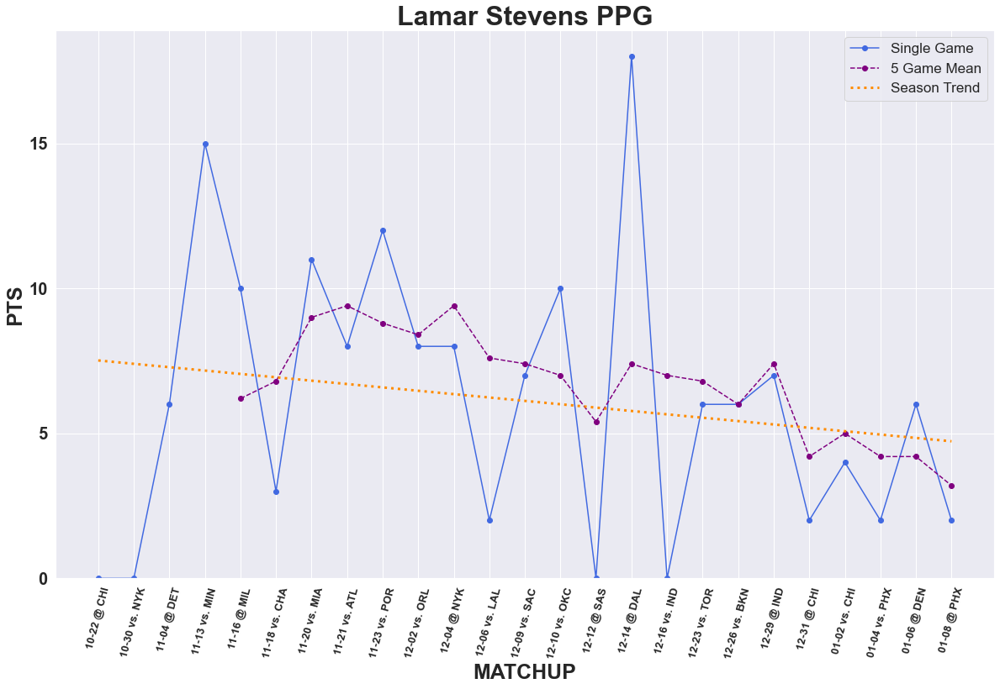

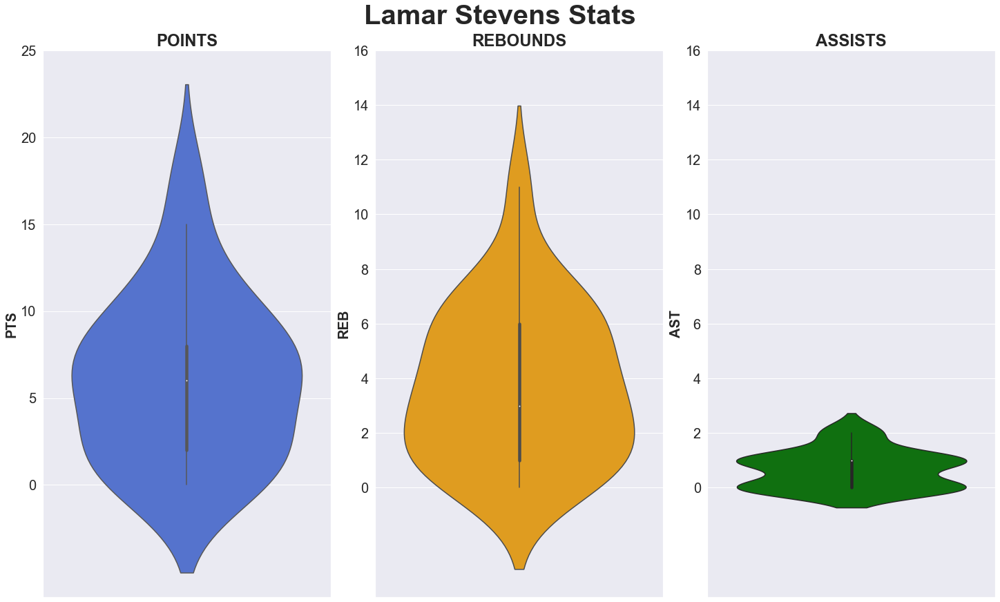

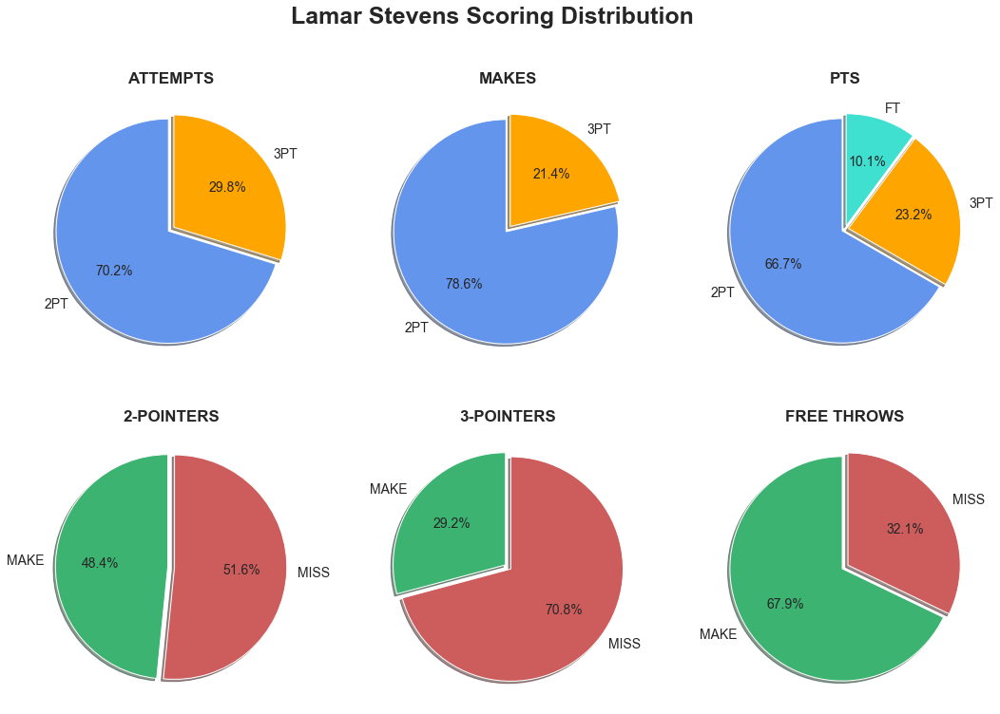



------------------------------------------------------------------------------------------------------------------




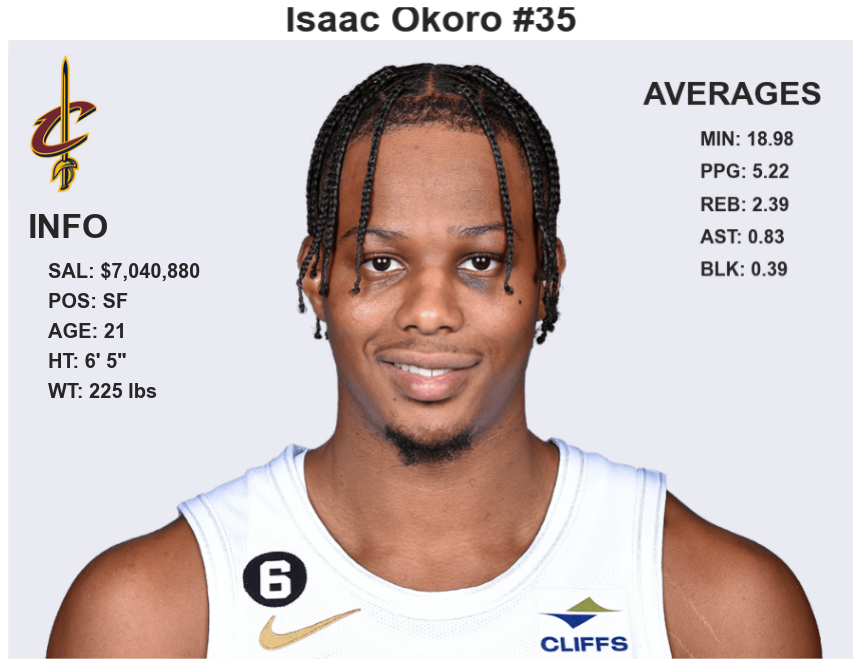

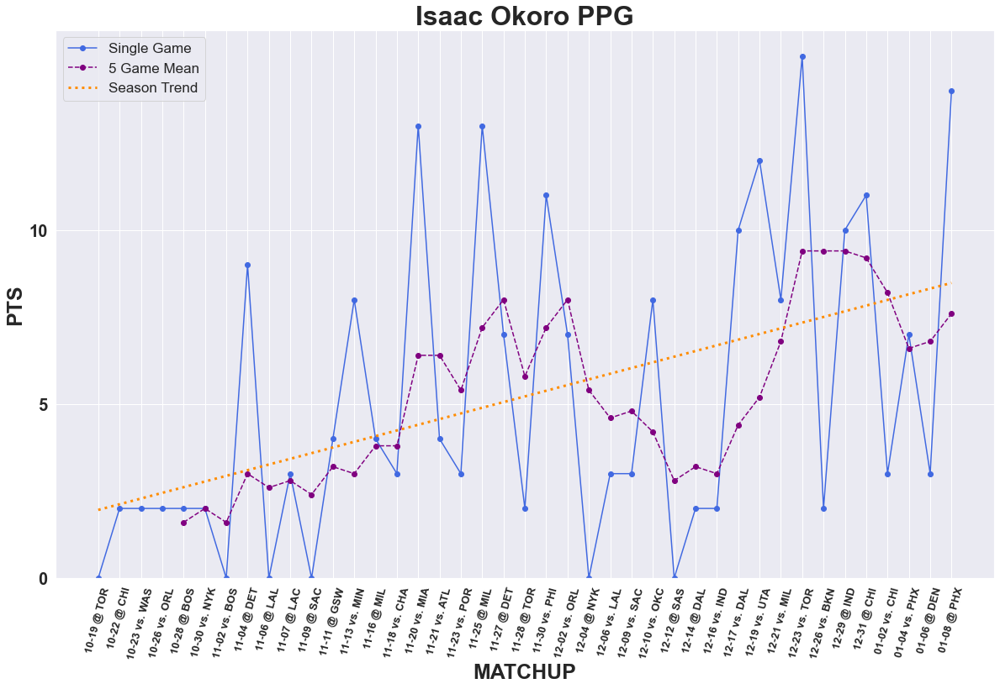

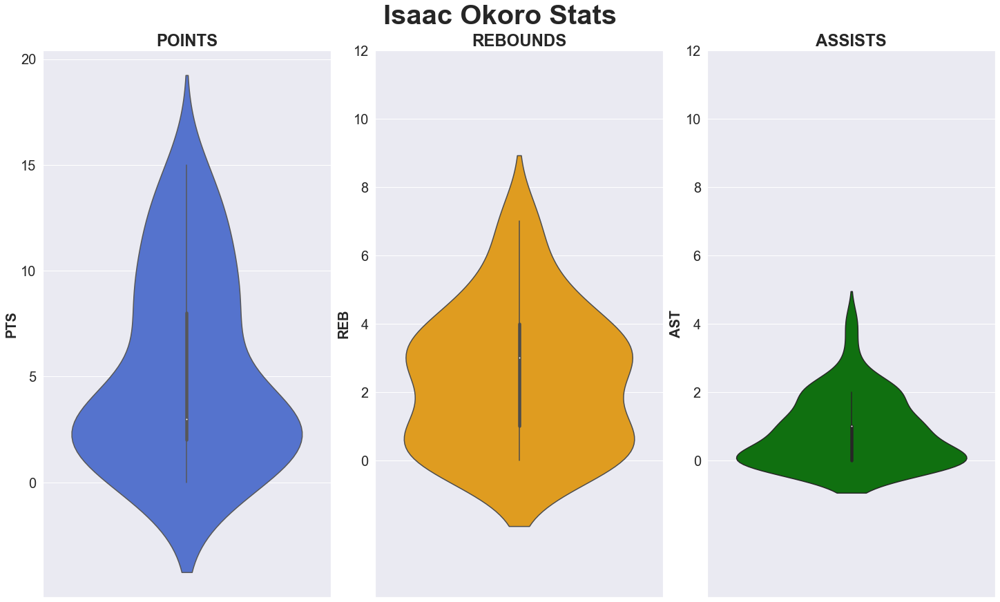

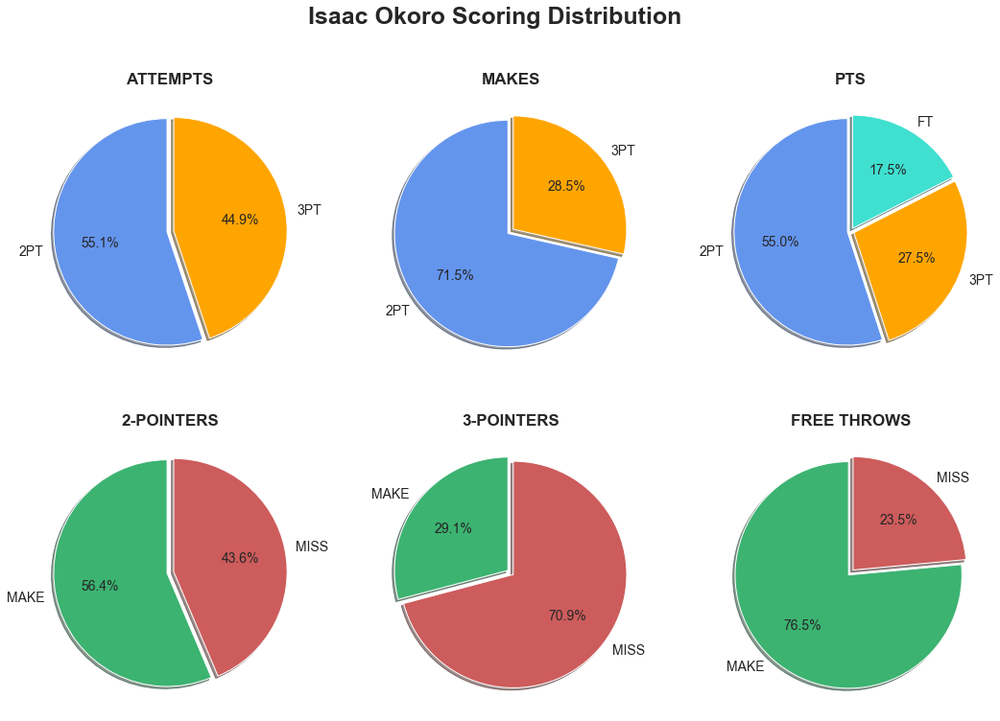



------------------------------------------------------------------------------------------------------------------




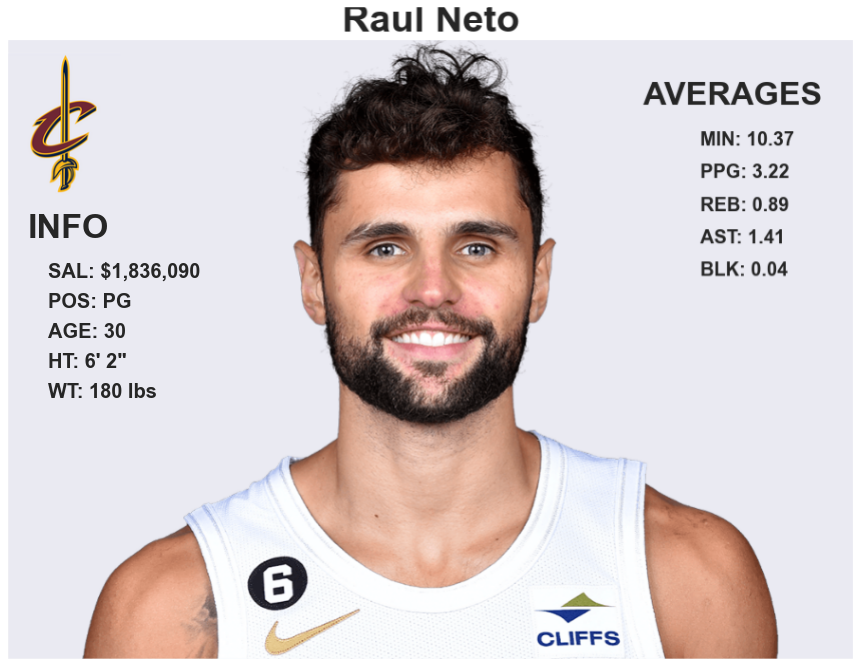

Professional Summary
Has appeared in 199 games (54 starts), averaging 4.8 points, 1.3 rebounds and 1.9 assists in 14.2 minutes.


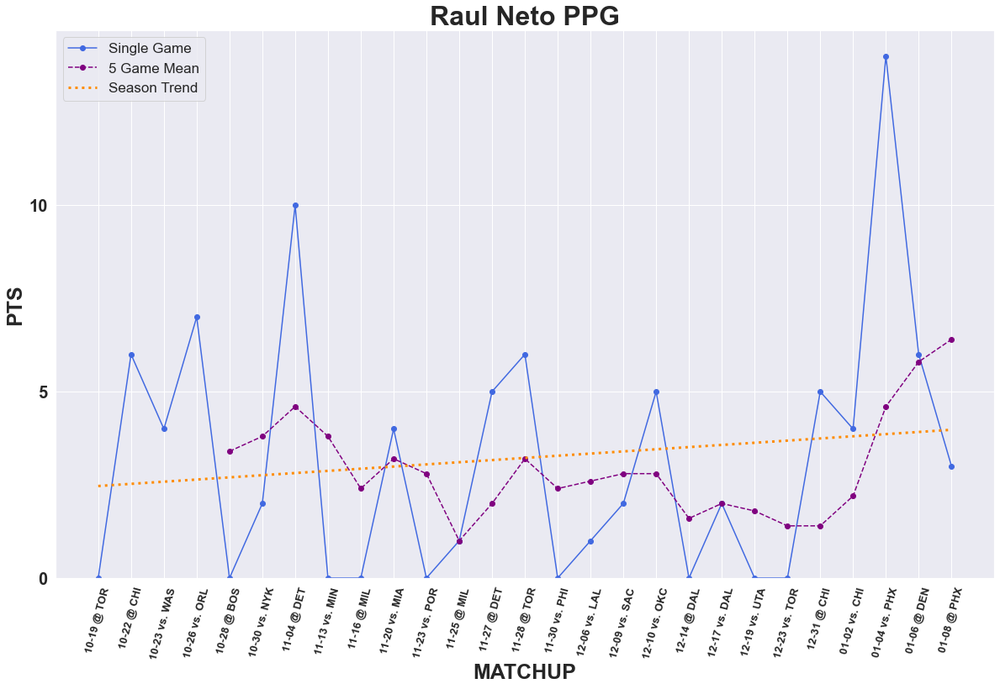

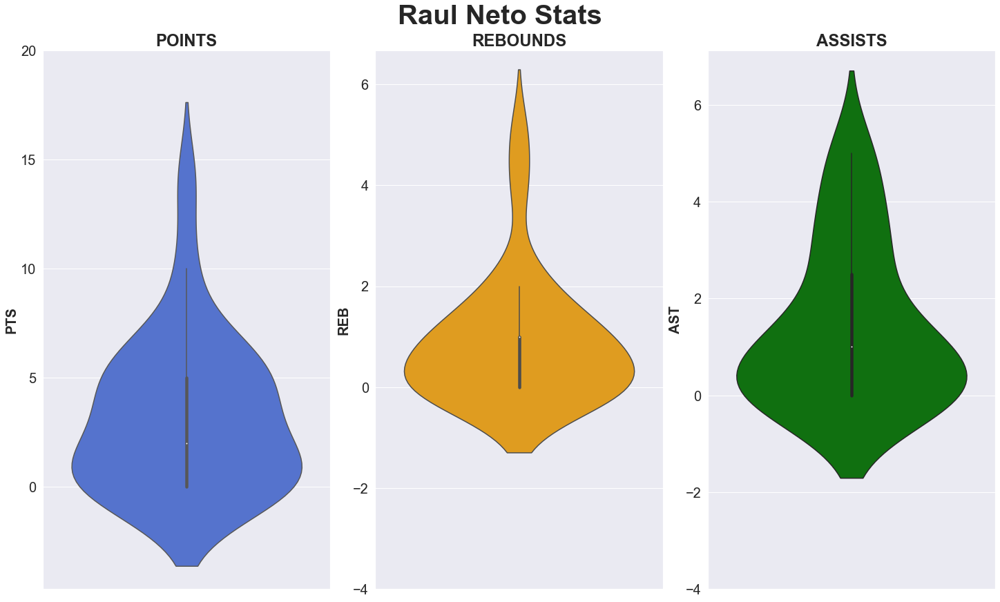

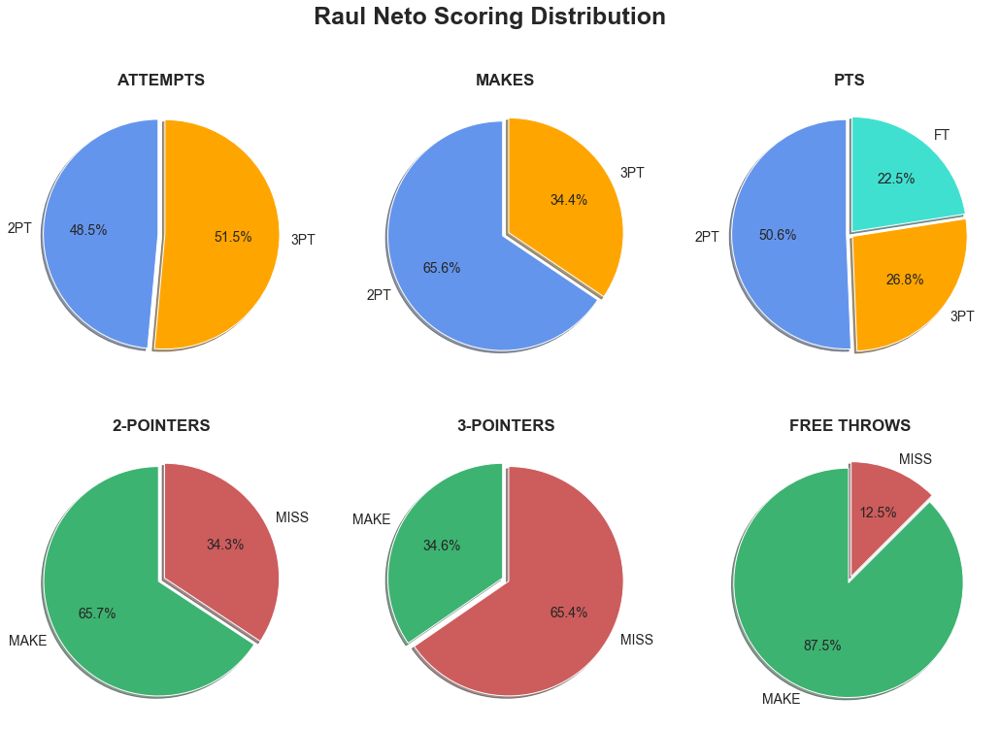



------------------------------------------------------------------------------------------------------------------




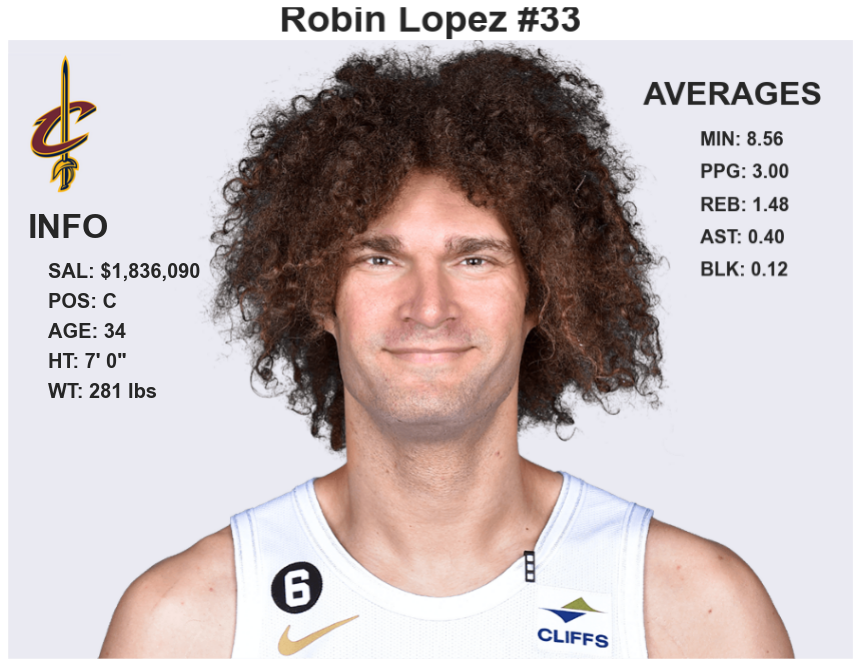

Professional Summary
Appeared in 903 career NBA regular season games (594 starts) with Phoenix, New Orleans, Portland, New York, Chicago, Milwaukee and Washington, averaging 8.8 ppg., 5.0 rpg. and 1.13 blkpg. in 22.1 minpg., while shooting .536 (3,319-6,195) from the floor…Has 81 career double-doubles…Also played in 36 career playoff games (28 starts), averaging 8.4 ppg., 5.6 rpg. and 1.00 blkpg. in 23.4 minpg., while shooting .575 (126-219) from the floor...2019-20: Played in 66 games (five starts) with Milwaukee, averaging 5.4 ppg. and 2.4 rpg. in 14.5 minpg.…Scored in double figures 13 times…Also played in three postseason outings, averaging 2.0 ppg. and 1.3 rpg. in 7.0 minpg.…2018-19: Appeared in 74 games (36 starts) with Chicago, averaging 9.5 ppg., 3.9 rpg., 1.2 apg. and 1.05 blkpg. in 21.7 minpg., while shooting .568 (304-535) from the floor…Ranked 13th in the NBA in field goal percentage and 31st in blocked shots…Scored in double figures 33 times and 20+ points seven times…Had 

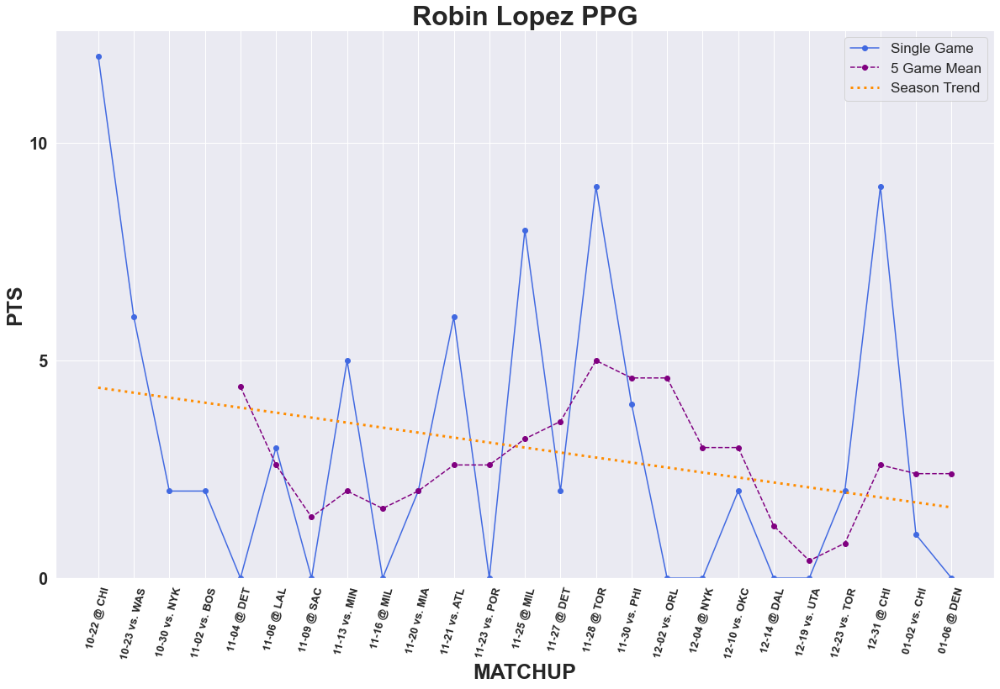

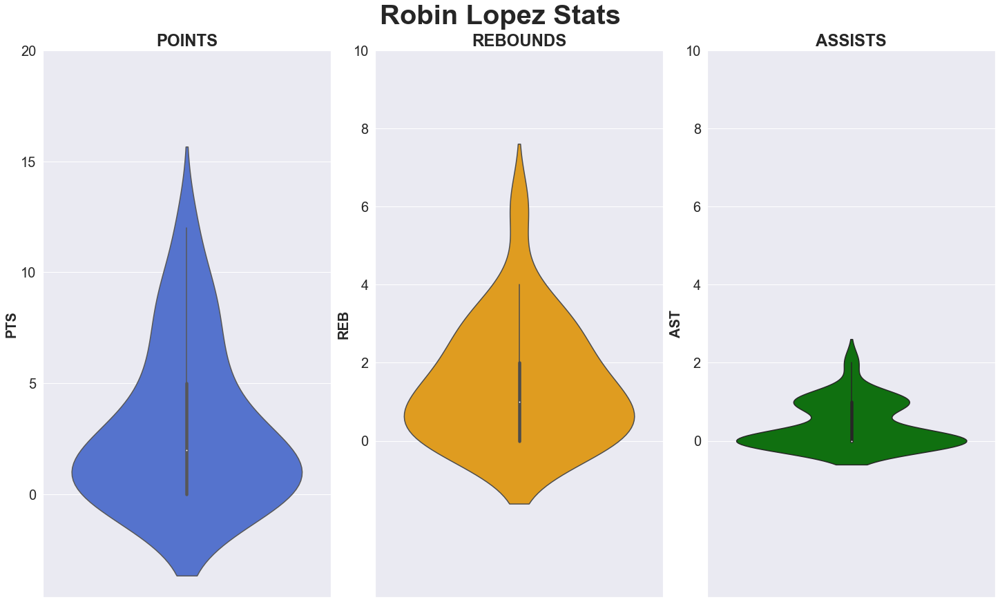

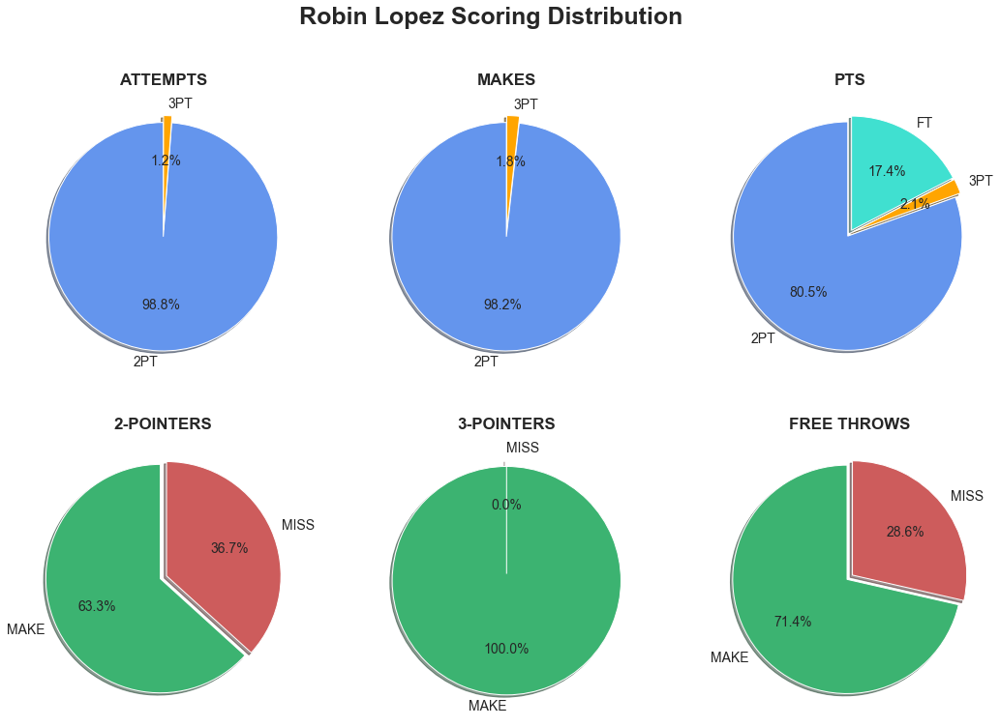



------------------------------------------------------------------------------------------------------------------




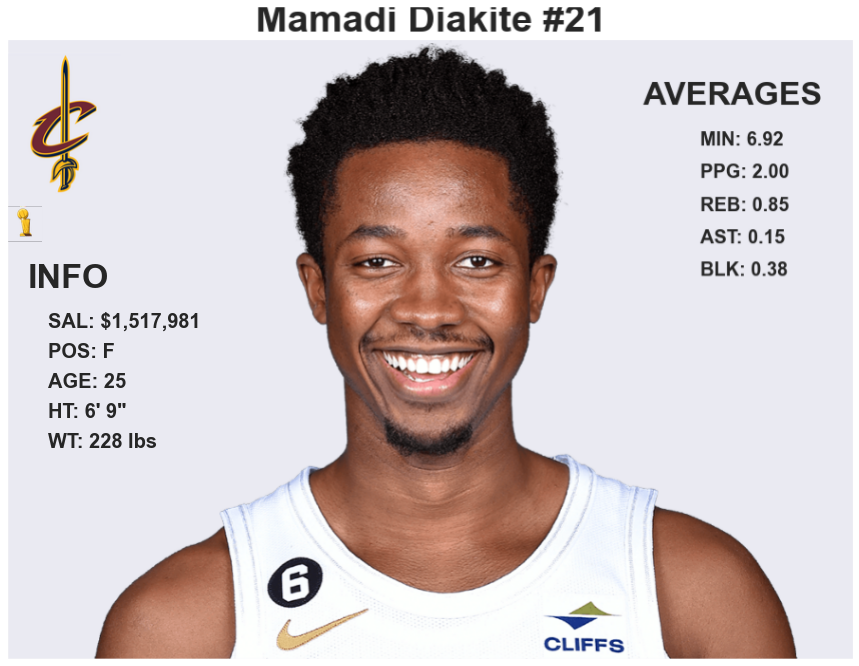

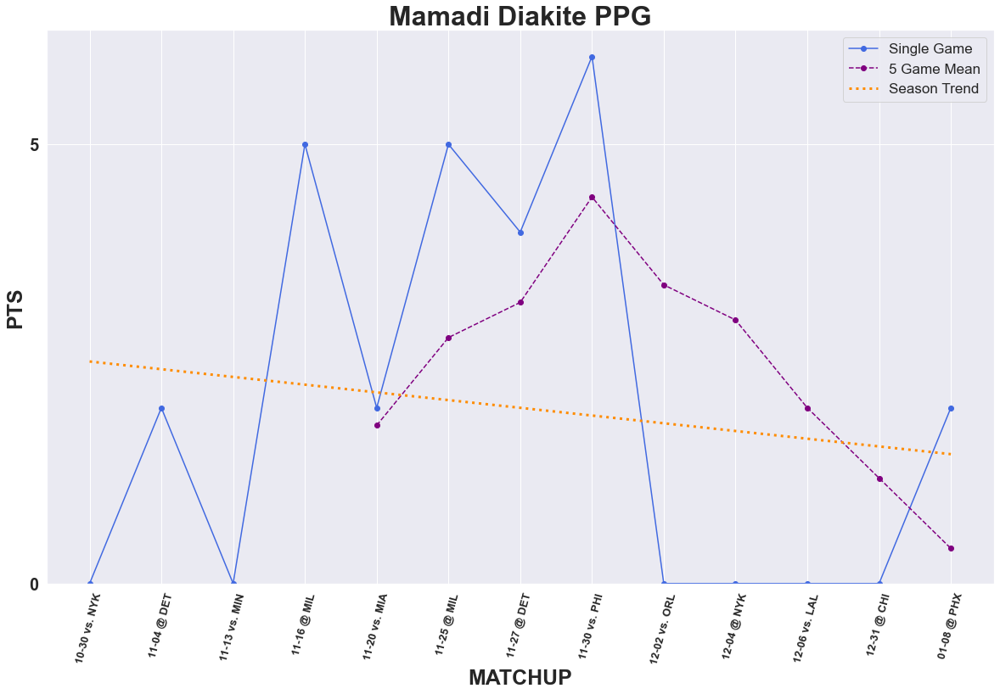

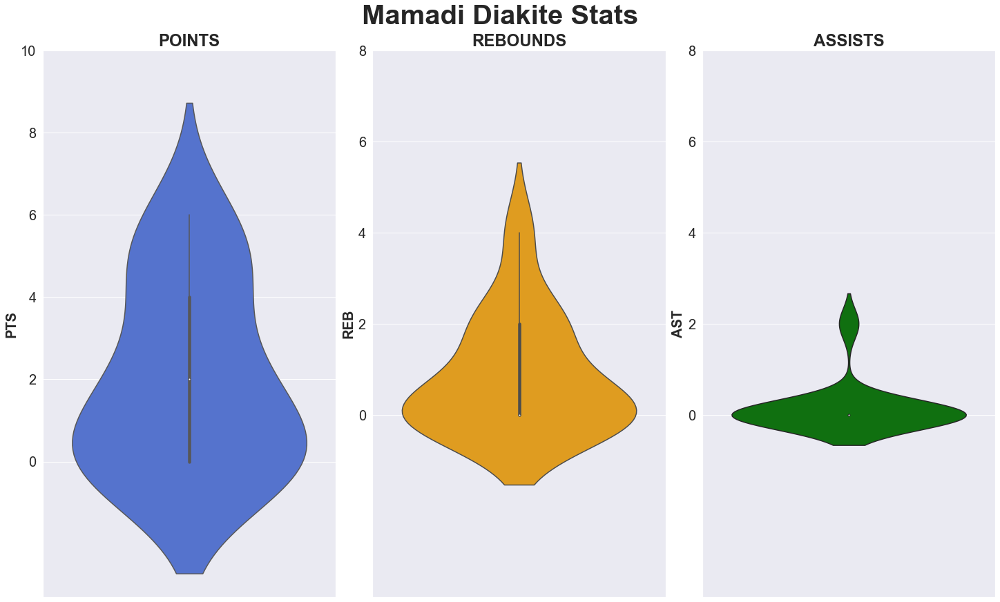

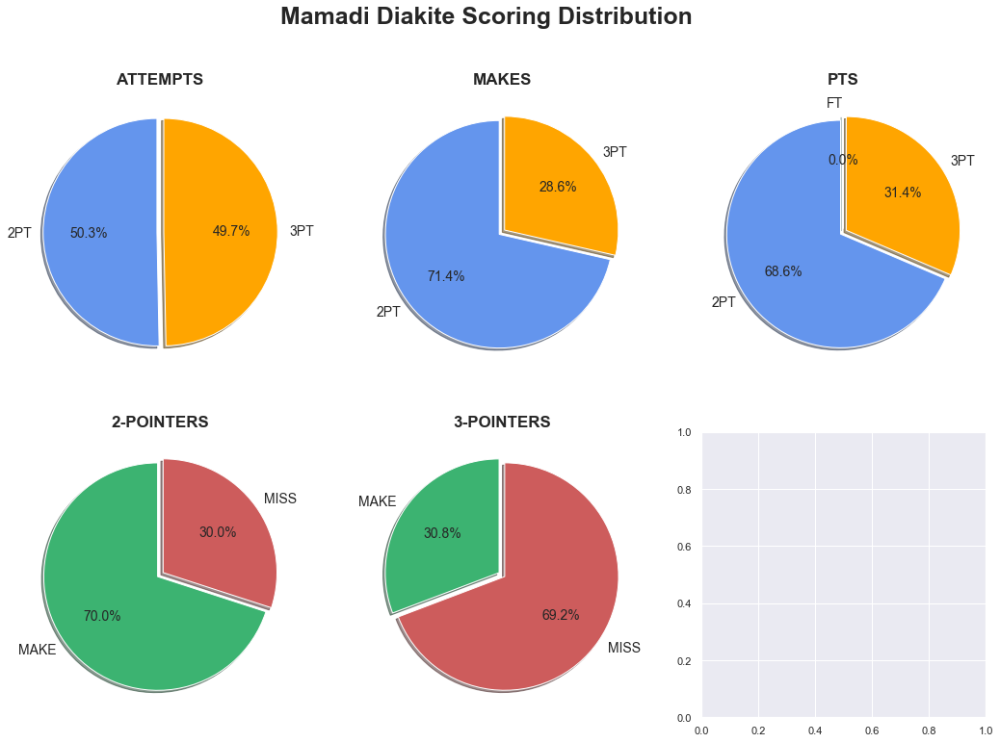



------------------------------------------------------------------------------------------------------------------




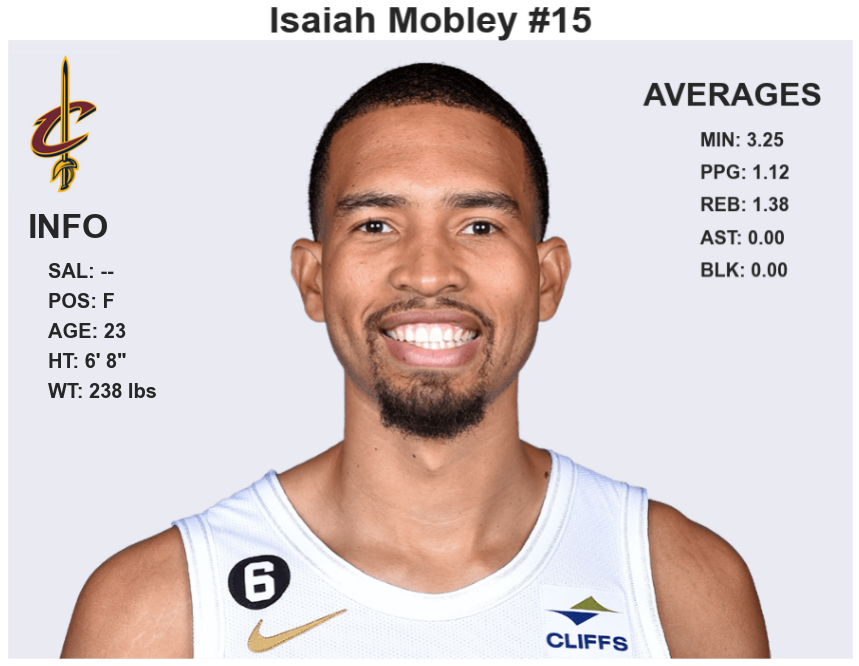

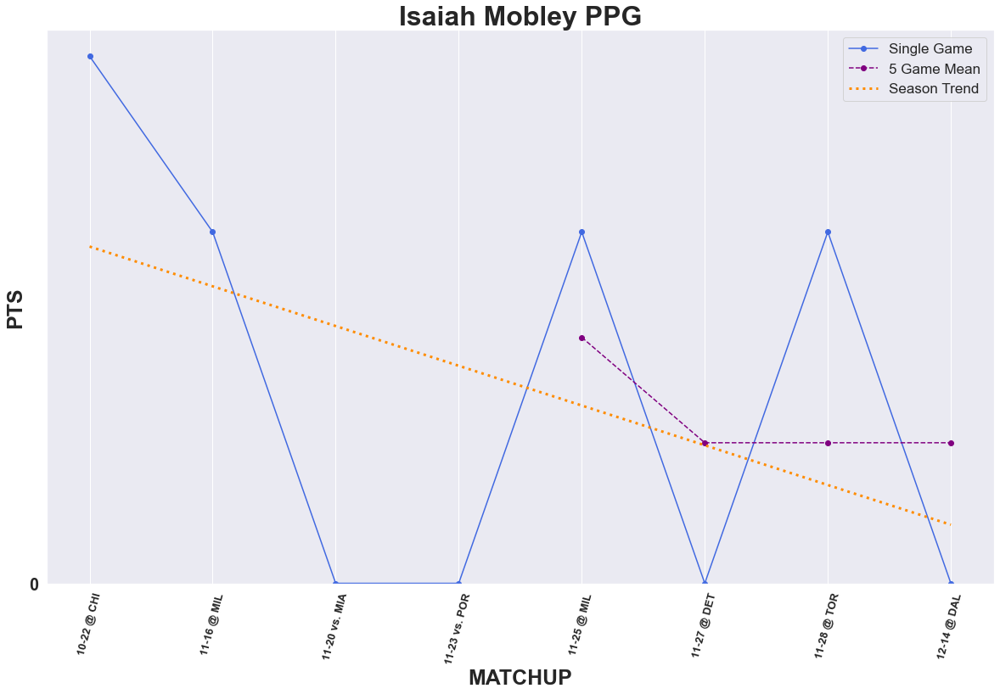

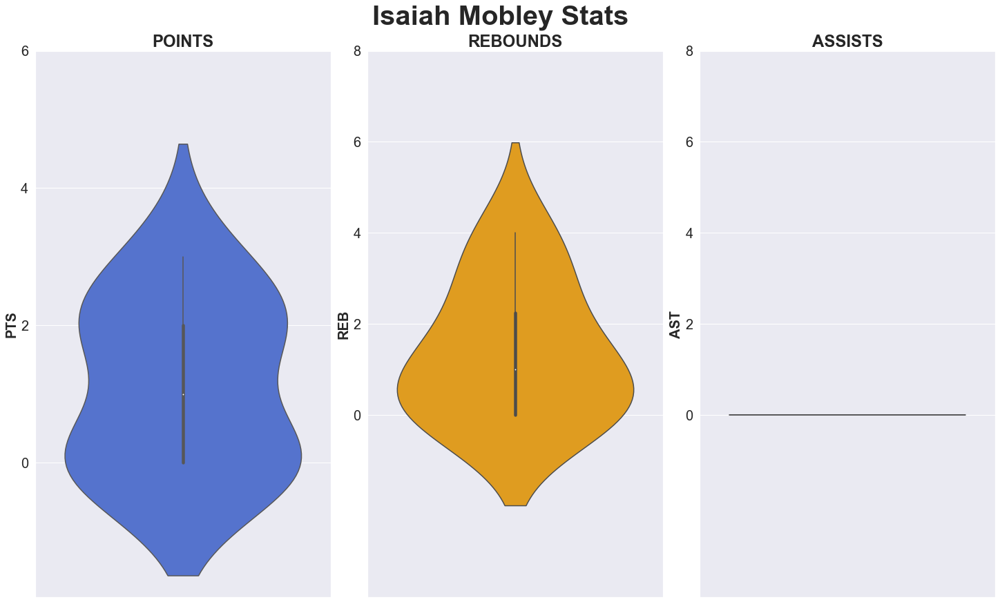

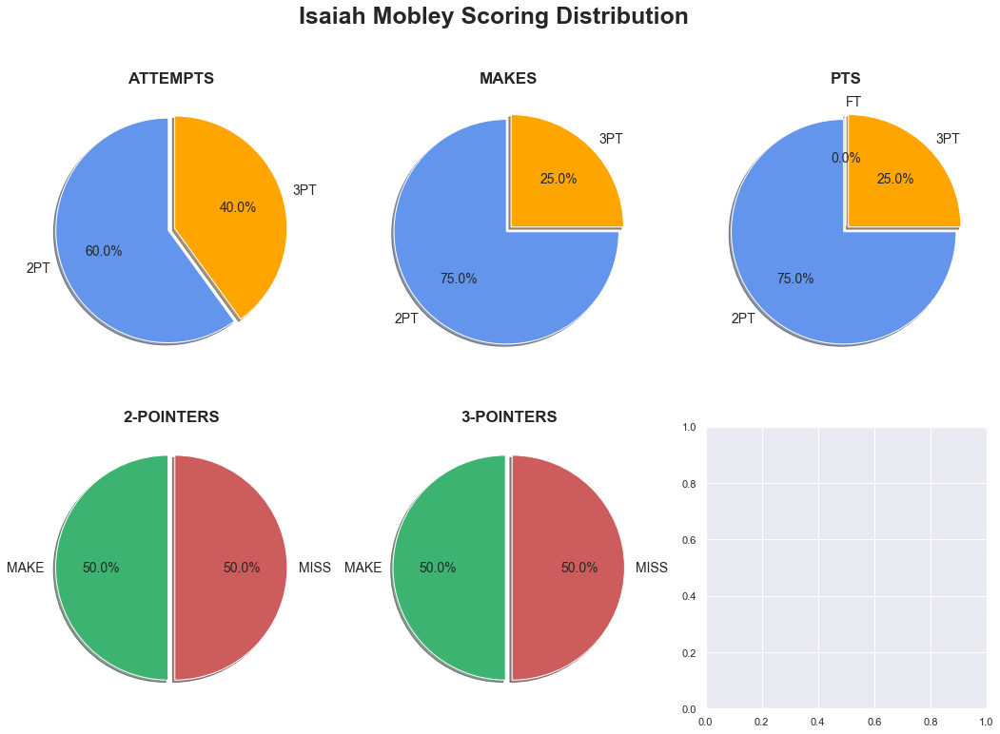



------------------------------------------------------------------------------------------------------------------




In [121]:
def team_report(team_abbr):
    wl_pies(team_abbr)
    shot_pies(team_abbr)
    # SHOOTING BAR CHARTS by distance
    plus_minus_plot(team_abbr)
    line_plot_scores(team_abbr)
    trend_plot_scores(team_abbr)
    #team_players_ppg_bar(team_abbr)
    team_players_ppg_whisker(team_abbr)
    #team_players_reb_bar(team_abbr)
    team_players_reb_whisker(team_abbr)
    #team_players_ast_bar(team_abbr)
    team_players_ast_whisker(team_abbr)
    display_roster_summary(team_abbr)
    
team_report("CLE")

## 2-Team Comparison Function

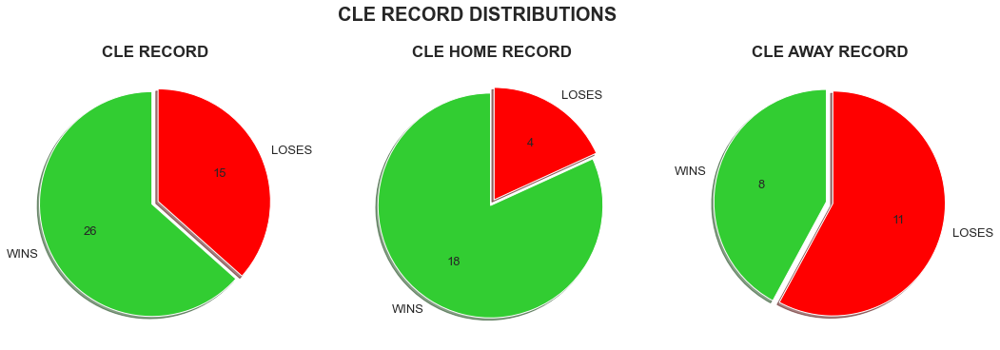

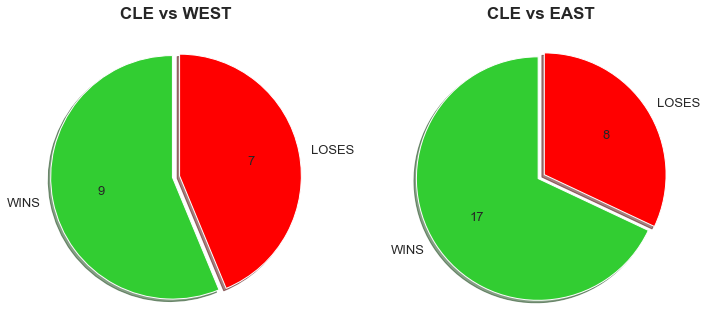

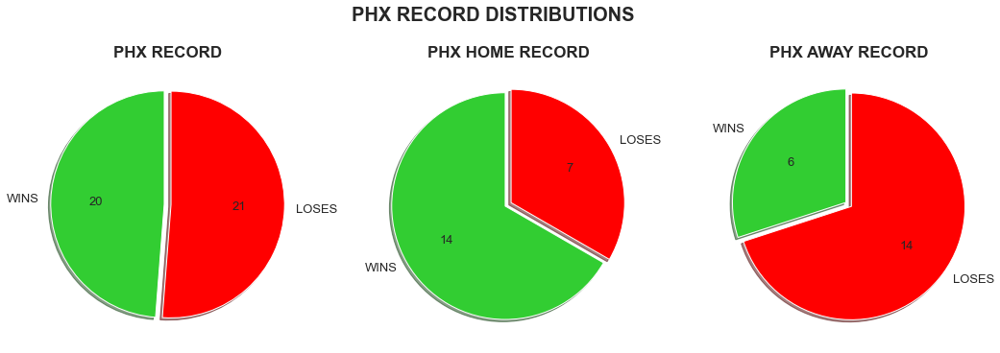

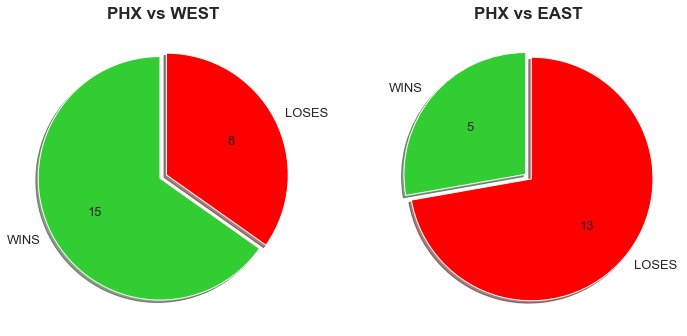

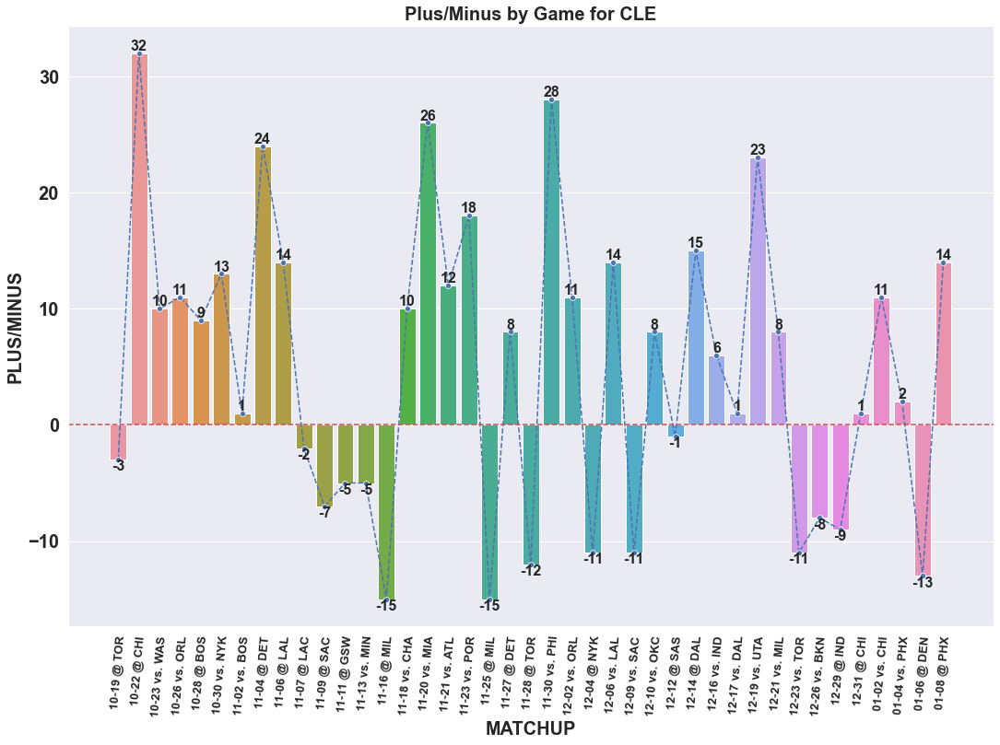

...

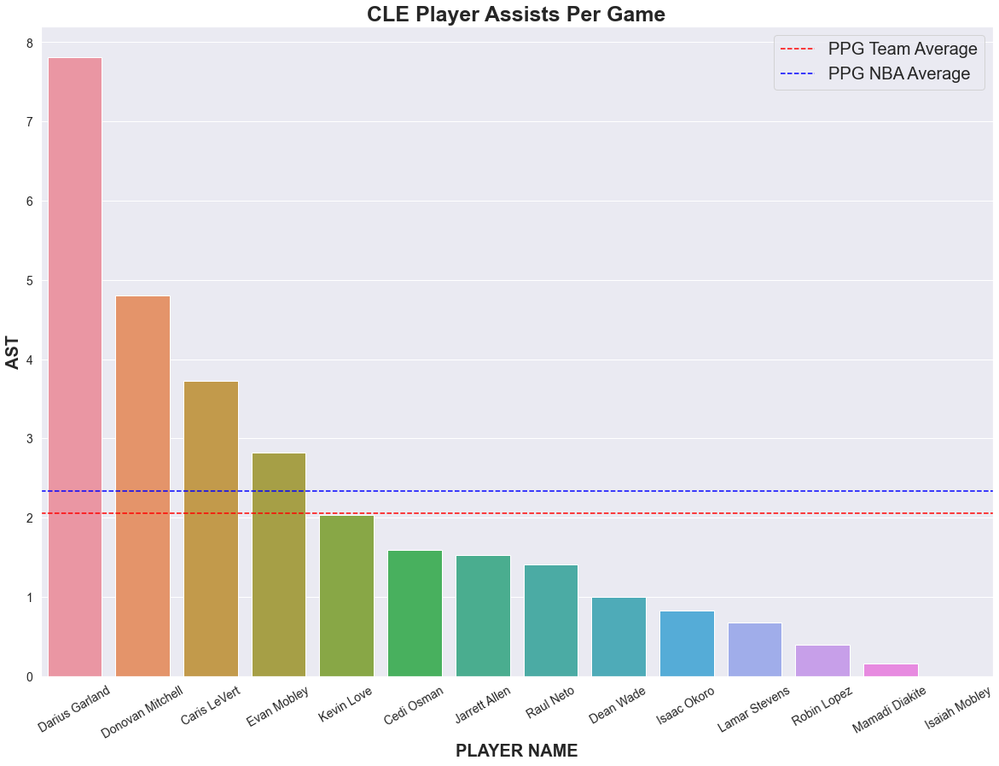

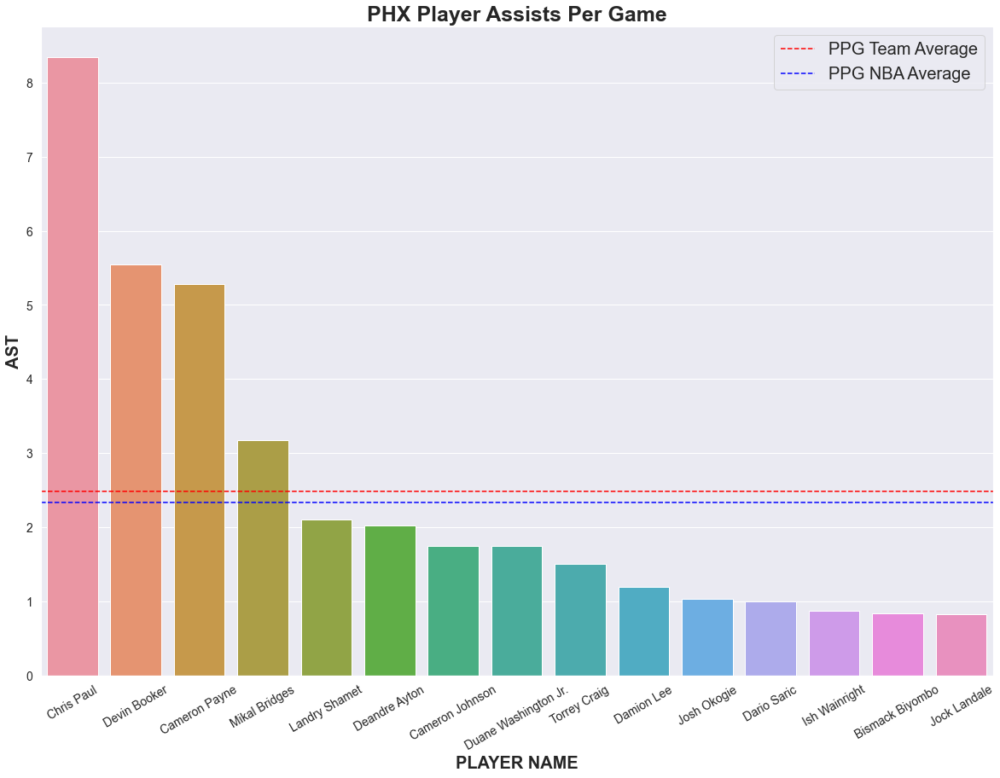

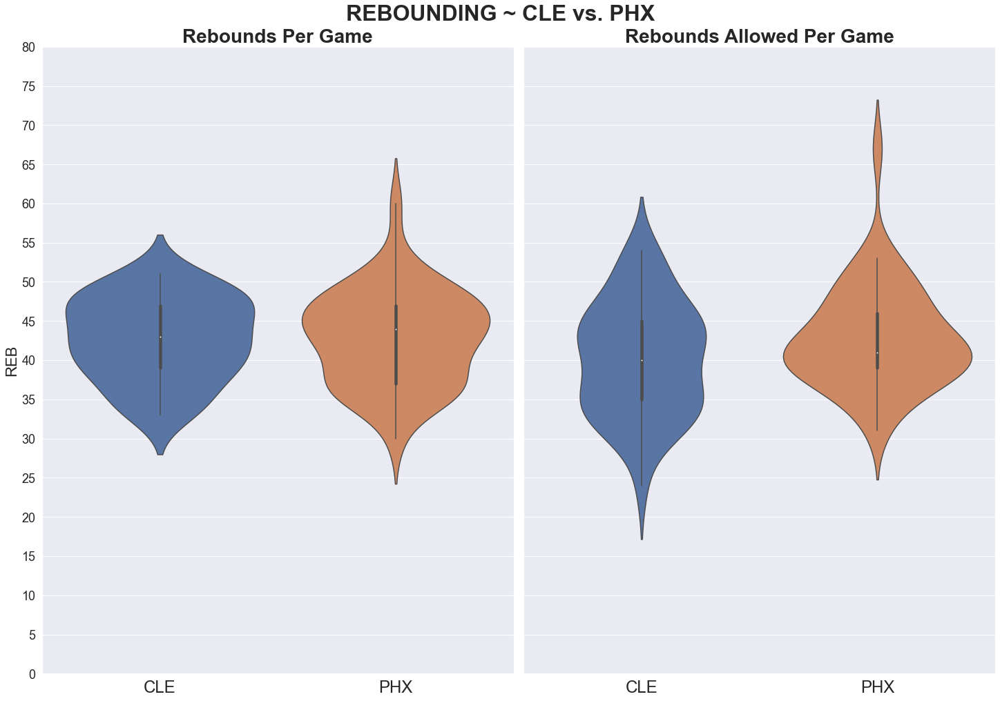

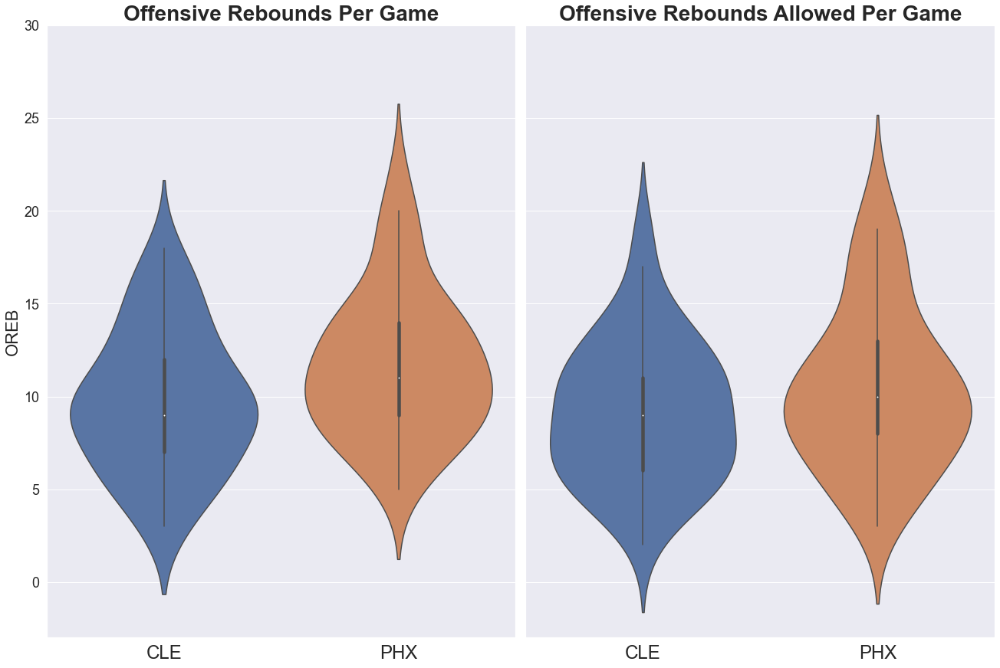

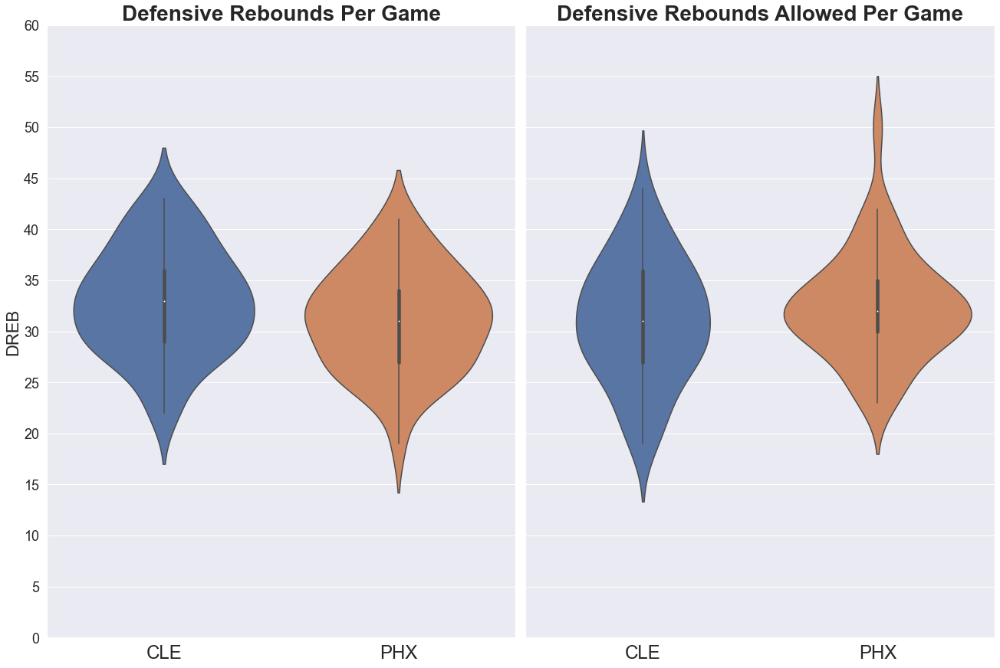

In [123]:
def compare_teams(team_a_abbr, team_b_abbr):
    df_a = get_team_df(team_a_abbr)
    df_b = get_team_df(team_b_abbr)
    df_merged = pd.concat([df_a,df_b])
    
    wl_pies(team_a_abbr)
    wl_pies(team_b_abbr)
    
    plus_minus_plot(team_a_abbr)
    plus_minus_plot(team_b_abbr)
    
    line_plot_scores(team_a_abbr)
    line_plot_scores(team_b_abbr)
    
    trend_plot_scores(team_a_abbr)
    trend_plot_scores(team_b_abbr)
    
    scored_allowed_compare(team_a_abbr, team_b_abbr)
    
    shot_pies(team_a_abbr)
    shot_pies(team_b_abbr)
    
    print()
    team_players_ppg_bar(team_a_abbr)
    #team_players_ppg_whisker(team_a_abbr)
    team_players_ppg_bar(team_b_abbr)
    #team_players_ppg_whisker(team_b_abbr)
    
    print()
    team_players_reb_bar(team_a_abbr)
    #team_players_reb_whisker(team_a_abbr)
    team_players_reb_bar(team_b_abbr)
    #team_players_reb_whisker(team_b_abbr)
    
    print()
    team_players_ast_bar(team_a_abbr)
    #team_players_ast_whisker(team_a_abbr)
    team_players_ast_bar(team_b_abbr)
    #team_players_ast_whisker(team_b_abbr)
    
    rebounds_compare(team_a_abbr, team_b_abbr)
    
    
    
    # Opponent shot pies
    
    # Fouls
    
    # Turnovers 
    
    # Chart with league rankings
    
    # Add players
    
    plt.show()

compare_teams('CLE','PHX')